<div style="display: flex; align-items: center;">
    <img src="https://github.com/angeloBuso/ppca-dados-massivos/blob/main/dados/UNB-logo.png?raw=true" alt="UNB logo" width="180" style="margin-right: 10px;">
    <h1>Programa de Pós-graduação em Computação Aplicada – PPCA (UnB)</h1>
</div>

<h2 style="text-align: center;">
    Análise Estatística de Dados e Informações - <span style="font-size: 0.8em;">Prova Final</span>
</h2>


<h5>Professor: João Gabriel de Moraes Souza</h5>
<h5>Aluno: <a href="https://tr.ee/On58b8WbPz" target="_blank">Angelo Donizete Buso Júnior</a></h5>

In [1]:
import warnings
warnings.filterwarnings("ignore")

# Manipulação de Dados
import pandas as pd
from IPython.display import display
import numpy as np

# Visualização de Dados
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import seaborn as sns

# Estatística e Testes Estatísticos
import shap
from scipy import stats
from scipy.stats import kurtosis, skew, f_oneway, shapiro, levene, kruskal
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Pré-Processamento de Dados
from sklearn.model_selection import KFold, cross_validate
from sklearn.preprocessing import StandardScaler, LabelEncoder, MinMaxScaler, OneHotEncoder
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import SMOTE
from collections import Counter

# Algoritmos de Machine Learning
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.svm import SVC

# Treinamento e Validação de Modelos
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, StratifiedKFold

# Avaliação de Modelos
from sklearn.metrics import (
    mean_squared_error, mean_absolute_error, r2_score,
    confusion_matrix, accuracy_score, precision_score, recall_score,
    classification_report, roc_auc_score, roc_curve, ConfusionMatrixDisplay
)
from scikitplot.metrics import plot_confusion_matrix, plot_roc

# Configurações Opcionais
pd.set_option('display.float_format', '{:.2f}'.format)
sns.set_theme(style="whitegrid")
plt.rc("figure", figsize=(10, 6))

# Verificação de Versões
print("Versão do Seaborn:", sns.__version__)
print("Versão do Pandas:", pd.__version__)


Versão do Seaborn: 0.13.2
Versão do Pandas: 2.2.3


# Questão 1

## 1. Compreensão do Problema de Negócio

O mercado imobiliário é um setor altamente competitivo, onde a precificação correta dos imóveis desempenha um papel crucial na tomada de decisões de compradores, vendedores e investidores. A utilização de modelos preditivos permite estimar os preços das propriedades com base em características estruturais e de localização, oferecendo uma vantagem estratégica para os envolvidos no setor.

Neste estudo, exploraremos os fatores que influenciam os preços de venda de imóveis na região de King County, nos Estados Unidos. Utilizaremos a **Regressão Linear** como técnica principal para prever os preços das propriedades e identificar as variáveis que mais impactam a valorização imobiliária. Para garantir uma abordagem estruturada e metodologicamente sólida, aplicaremos a metodologia **CRISP-DM** (*Cross-Industry Standard Process for Data Mining*), um framework amplamente reconhecido em projetos de ciência de dados.

O CRISP-DM é composto por seis etapas principais:

1. **Compreensão do Problema de Negócio**: Definir os objetivos e requisitos do projeto.
2. **Compreensão dos Dados**: Explorar, descrever e identificar padrões no conjunto de dados.
3. **Preparação dos Dados**: Limpar, transformar e selecionar variáveis relevantes.
4. **Modelagem**: Construir e ajustar modelos preditivos.
5. **Avaliação**: Validar se os modelos atendem aos objetivos do negócio.
6. **Implementação**: Integrar os resultados para apoio à tomada de decisão.

Para esta análise, utilizamos o conjunto de dados **House Sales in King County, USA**, disponível no [Kaggle](https://www.kaggle.com/datasets/harlfoxem/housesalesprediction). O dataset contém informações sobre imóveis vendidos entre maio de 2014 e maio de 2015 na região de King County, incluindo Seattle. As variáveis incluem características como número de quartos, área do terreno, presença de vista para o mar, idade da construção, entre outras.

Além da construção do modelo preditivo, realizaremos uma **análise exploratória** e testes estatísticos para avaliar se os pressupostos da Regressão Linear (como linearidade, normalidade dos resíduos e homocedasticidade) são atendidos. Dessa forma, este estudo visa não apenas prever preços de imóveis, mas também gerar **insights interpretáveis** sobre os principais fatores que influenciam a precificação no mercado imobiliário. Adicionalmente, busca-se demonstrar os desafios inerentes ao desenvolvimento de modelos de *Machine Learning*, uma vez que a obtenção de um modelo ideal pode demandar diversas iterações e refinamentos ao longo do processo.

### 1.1 Dicionário dados

Abaixo transcrevemos o significado de cada um dos colunas do *dataset*.

- **id**: Identificador único de cada imóvel.
- **date**: Data da venda do imóvel.
- **price**: Preço pelo qual o imóvel foi vendido. **Variável *Target***
- **bedrooms**: Número de quartos no imóvel.
- **bathrooms**: Número de banheiros no imóvel.
- **sqft_living**: Área habitável em pés quadrados.
- **sqft_lot**: Tamanho total do lote em pés quadrados.
- **floors**: Número de andares do imóvel.
- **waterfront**: Indica se o imóvel tem vista para a água (1) ou não (0).
- **view**: Índice de 0 a 4 que classifica a qualidade da vista do imóvel.
- **condition**: Classificação da condição atual do imóvel, variando de 1 a 5.
- **grade**: Classificação da qualidade da construção e design do imóvel, variando de 1 a 13.
- **sqft_above**: Área em pés quadrados acima do solo.
- **sqft_basement**: Área em pés quadrados do porão.
- **yr_built**: Ano em que o imóvel foi construído.
- **yr_renovated**: Ano em que o imóvel foi reformado pela última vez.
- **zipcode**: Código postal onde o imóvel está localizado.
- **lat**: Latitude da localização do imóvel.
- **long**: Longitude da localização do imóvel.
- **sqft_living15**: Área habitável média dos 15 imóveis mais próximos, em pés quadrados.
- **sqft_lot15**: Tamanho médio do lote dos 15 imóveis mais próximos, em pés quadrados.

## 2. Coleta Dados

In [2]:
path = "/home/buso/mestrado/aedi-ppca/dados/kc_house_data.csv"

### 2.1 Carga dados

In [3]:
data = pd.read_csv(path)
data.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.00,3,1.00,1180,5650,1.00,0,0,...,7,1180,0,1955,0,98178,47.51,-122.26,1340,5650
1,6414100192,20141209T000000,538000.00,3,2.25,2570,7242,2.00,0,0,...,7,2170,400,1951,1991,98125,47.72,-122.32,1690,7639
2,5631500400,20150225T000000,180000.00,2,1.00,770,10000,1.00,0,0,...,6,770,0,1933,0,98028,47.74,-122.23,2720,8062
3,2487200875,20141209T000000,604000.00,4,3.00,1960,5000,1.00,0,0,...,7,1050,910,1965,0,98136,47.52,-122.39,1360,5000
4,1954400510,20150218T000000,510000.00,3,2.00,1680,8080,1.00,0,0,...,8,1680,0,1987,0,98074,47.62,-122.05,1800,7503


## 3. Análise Exploratória

### 3.1 Visão Geral dos dados 

A análise exploratória de dados (EDA) é um passo essencial em projetos de ciência de dados, pois permite uma melhor compreensão das características, distribuições e possíveis anomalias nos dados. Este processo não apenas ajuda a identificar padrões relevantes, mas também fornece uma base sólida para a seleção de variáveis e construção de modelos preditivos. Ao explorar os dados, é possível descobrir relações implícitas entre as variáveis e verificar se os dados disponíveis são suficientes e adequados para atingir os objetivos do estudo.

Ter uma consciência situacional dos dados permite identificar outliers, valores faltantes e distribuições inesperadas que podem impactar negativamente a modelagem. Por exemplo, a identificação de uma variável com alta variância ou multicolinearidade é fundamental para evitar problemas como a instabilidade do modelo. Além disso, a EDA auxilia na escolha de transformações apropriadas para as variáveis, ajustando os dados para atender aos pressupostos do modelo. Este passo inicial é crucial para garantir a validade e a confiabilidade das análises subsequentes, além de direcionar melhor os esforços do projeto.

In [4]:
def visaogeral(df, messagem):
    print(f'{messagem}:\n')
    print("Qtd Observações:", df.shape[0])
    print("\nQtd Atributos:", df.shape[1])
    print("\nAtributos:")
    print(df.columns.tolist())
    print("\nQtd Valores missing:", df.isnull().sum().values.sum())
    print("\nValores Unicos: indicativo de valores categóricos")
    print(df.nunique().sort_values(ascending=True).head(40))

In [5]:
visaogeral(data,'Visão Geral dataSet treino')

Visão Geral dataSet treino:

Qtd Observações: 21613

Qtd Atributos: 21

Atributos:
['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade', 'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long', 'sqft_living15', 'sqft_lot15']

Qtd Valores missing: 0

Valores Unicos: indicativo de valores categóricos
waterfront           2
view                 5
condition            5
floors               6
grade               12
bedrooms            13
bathrooms           30
zipcode             70
yr_renovated        70
yr_built           116
sqft_basement      306
date               372
long               752
sqft_living15      777
sqft_above         946
sqft_living       1038
price             4028
lat               5034
sqft_lot15        8689
sqft_lot          9782
id               21436
dtype: int64


In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

A análise exploratória das características do conjunto de dados é uma etapa fundamental para compreender sua estrutura, identificar padrões e detectar potenciais desafios, como a presença de valores ausentes ou a necessidade de transformação de variáveis categóricas. Esses aspectos são essenciais para a construção de um modelo preditivo robusto e confiável.

O dataset utilizado contém aproximadamente **21,6 mil observações** e **21 atributos**, que representam diversas características das propriedades imobiliárias em King County, Washington (EUA). Durante a inspeção inicial, não foram identificados valores ausentes. No entanto, é importante destacar que operações de transformação e engenharia de *features* podem gerar dados faltantes ao longo do *pipeline*. Portanto, é crucial monitorar e mitigar possíveis impactos desses possíveis dados faltantes, no intuito de preservar a qualidade do modelo.

Além disso, algumas variáveis apresentam poucos valores únicos, como `waterfront`, `view`, `condition`, `floors` e `grade`, indicando um comportamento categórico, apesar de estarem representadas numericamente. Esse fator exige atenção especial na modelagem, pois pode demandar estratégias de tratamento como variáveis ordinais, dependendo da natureza dos dados.

A variável `date` foi carregada do tipo `object`, muito embora deveria estar no formado de data, há um indício que teremos que transformar essa variável em seu formato para realizar algumas anaálises.

Essa análise preliminar fornece **insights estratégicos** que orientam as próximas etapas de preparação, transformação e modelagem dos dados, garantindo um fluxo de trabalho mais eficiente e direcionado à melhoria do desempenho preditivo.

#### 3.1.1 Variáveis Explanatórias e Variável Dependente

Em modelos de Machine Learning supervisionado, as variáveis são classificadas em variáveis explanatórias (ou independentes) e variável dependente (ou alvo). As variáveis explanatórias representam os fatores utilizados para prever ou explicar a variável dependente, que é o resultado que se deseja modelar. No caso de um modelo aplicado à previsão de preços de imóveis, as variáveis explanatórias incluem atributos como tamanho do imóvel, número de quartos, localização e idade da construção, enquanto a variável dependente é o preço de venda. A escolha e o tratamento adequado dessas variáveis são essenciais para garantir a qualidade preditiva e interpretabilidade do modelo.

In [7]:
data.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode',
       'lat', 'long', 'sqft_living15', 'sqft_lot15'],
      dtype='object')

In [8]:
X = data.drop("price", axis=1)
y = data["price"]

####  3.1.2  *Missing* Values

In [9]:
def missing_values_table(df):
    mis_val = df.isnull().sum()        
    mis_val_percent = 100 * df.isnull().sum() / len(df)        
    mis_val_table = pd.concat([mis_val, mis_val_percent], axis=1)        
    mis_val_table_ren_columns = mis_val_table.rename(
    columns = {0 : 'Missing Values', 1 : '% of Total Values'})        
    mis_val_table_ren_columns = mis_val_table_ren_columns[
    mis_val_table_ren_columns.iloc[:,1] != 0].sort_values(
    '% of Total Values', ascending=False).round(1)
    
    print ("Seu dataframe tem " + str(df.shape[1]) + " colunas.\n"      
        "Há " + str(mis_val_table_ren_columns.shape[0]) +
            " colunas que possuem valores ausentes.")
    
    return mis_val_table_ren_columns

In [10]:
y.isnull().sum()

0

A varíavel dependente não possui nenhum valor missing!

In [11]:
missing_values_table(X)

Seu dataframe tem 20 colunas.
Há 0 colunas que possuem valores ausentes.


,Missing Values,% of Total Values


Embora o conjunto de dados inicial não apresente valores ausentes, é fundamental considerar que transformações e engenharia de features podem introduzir dados faltantes ao longo do pipeline. Assim, é essencial monitorar e tratar essas ocorrências para garantir a integridade e a qualidade do modelo preditivo.

####  3.1.3  Análise Variável Dependente

In [12]:
y.describe()

count     21613.00
mean     540088.14
std      367127.20
min       75000.00
25%      321950.00
50%      450000.00
75%      645000.00
max     7700000.00
Name: price, dtype: float64

A variável dependente **price** representa o preço de venda dos imóveis e é a *feature* que queremos modelar e explicar. Com base no resumo estatístico, tem-se:

- **Média (mean)**: O preço médio das propriedades é de aproximadamente **$540.088**, refletindo o valor médio praticado na venda de caas nessa região de Washington.

- **Desvio Padrão (std)**: **$367.127**, indicando uma alta **variabilidade** nos preços, o que sugere a presença de imóveis significativamente mais caros ou mais baratos em relação à média.

- **Valores Mínimo e Máximo (min e max)**: O menor preço registrado foi de **$75.000**, enquanto o maior chegou a **$7.700.000**, mostrando uma grande amplitude nos valores das propriedades.

- **Quartis (25%, 50% e 75%)**:
  - **25% (primeiro quartil)**: 25% das propriedades têm preços abaixo de **$321.950**.
  - **50% (mediana)**: O preço mediano é **$450.000**, indicando que metade das propriedades custa mais que esse valor e que metade custa menos.
  - **75% (terceiro quartil)**: 25% das propriedades mais caras têm preços acima de **$645.000**, limitado a **$7.700.000**.

Esses dados mostram que os preços de venda têm possuem uma grande dispersão e provável assimetria, visto que a média é consideravelmente maior que a mediana, refletindo diferenças significativas nas características das propriedades. Essa variabilidade será explorada durante a modelagem para identificar quais fatores influenciam mais fortemente os preços.

In [13]:
y.quantile([0.80,0.90,0.93,0.94,0.99])

0.80    700108.00
0.90    887000.00
0.93    998000.00
0.94   1063560.00
0.99   1964400.00
Name: price, dtype: float64

Conforme acima, podemos dizer que 93% das propriedades estão distribuídas entre o preço de venda de $75.000 e $998.000. E 7% ultrapassa os 6 digitos (milhões). Essa distribuição reflete que os valores mais altos representam propriedades de luxo ou com características muito diferenciadas não indicando uma região elitizada. Sugere ainda que dado o percentil 99 o valor máximo de venda observado foge muito dos padrões.

Sendo assim, os dados sugerem que os preços de venda têm uma distribuição assimétrica à direita, ou seja, há uma concentração maior de imóveis com preços mais baixos, refletindo diferenças significativas nas características das propriedades.

#####  3.1.3.1  Amplitude

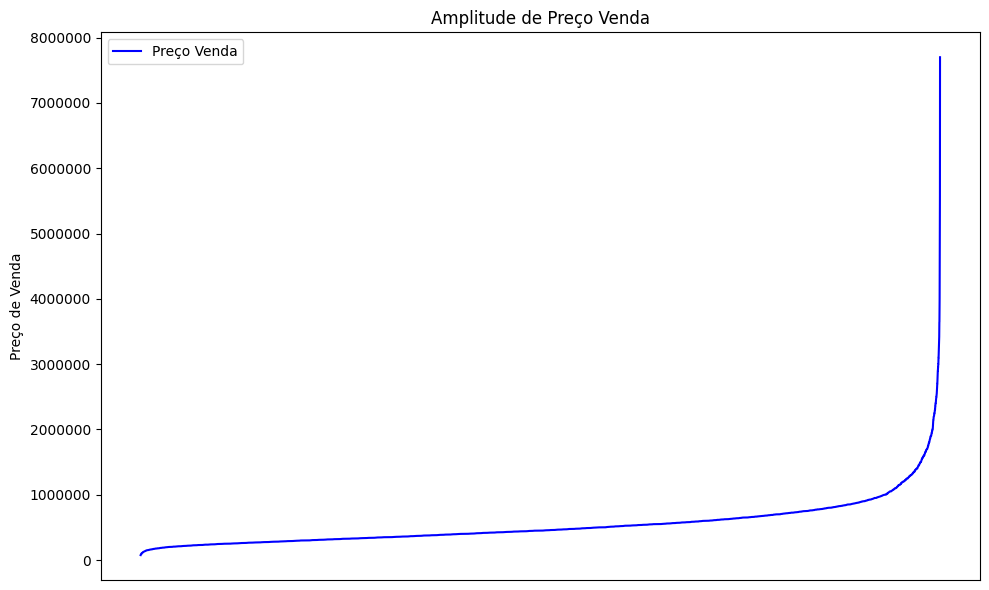

In [14]:
plt.figure(figsize=(10, 6))
plt.plot(np.sort(y), label="Preço Venda", color='blue')
plt.title("Amplitude de Preço Venda")
plt.ylabel("Preço de Venda")
plt.legend()

plt.xticks([])
plt.ticklabel_format(style='plain', axis='y')

plt.tight_layout()
plt.show()

Ordenando a variável `price` identificamos uma curva fortemente inclinada para cima no final, indicando que a maioria dos imóveis possui preços relativamente baixos e apenas uma pequena parcela apresenta valores extremamente altos. No final da curva, os valores disparam rapidamente, sugerindo a existência de imóveis de alto luxo que podem atuar como outliers, influenciando a média geral.

Essa característica pode afetar negativamente o desempenho do modelo de regressão linear, tornando necessário o uso de transformações (logaritmo do preço) ou a análise segmentada do mercado imobiliário.

#####  3.1.3.2 Plot - boxplot

In [15]:
sns.set_style("whitegrid")

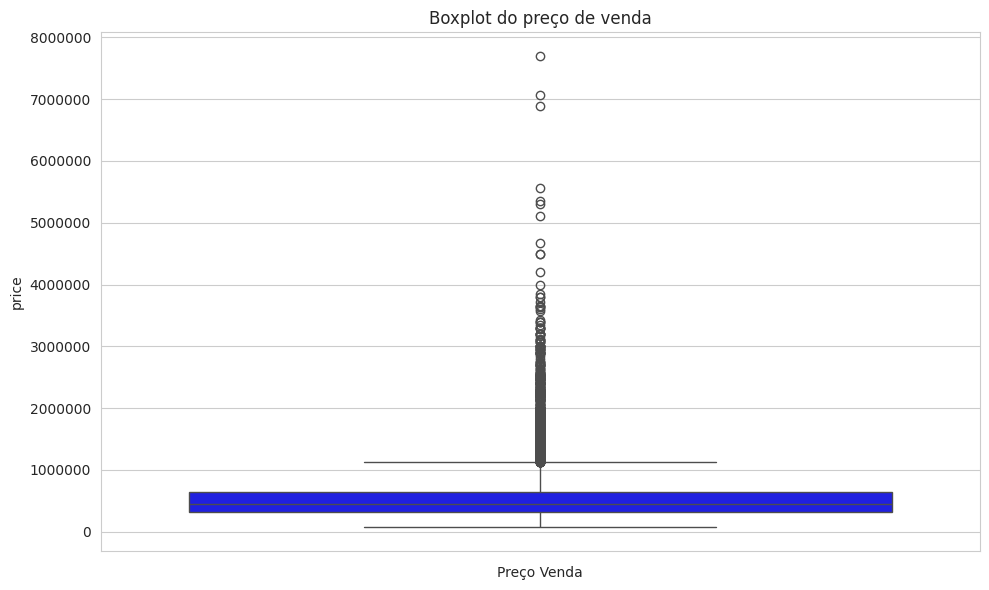

In [16]:
plt.figure(figsize=(10, 6))

sns.boxplot(y=y, color='blue')
plt.title("Boxplot do preço de venda")
plt.xlabel("Preço Venda")

plt.ticklabel_format(style='plain', axis='y')

plt.tight_layout()
plt.show()

O boxplot da variável alvo (`preço de venda do imóvel`) revela uma distribuição assimétrica à direita, com a maioria dos preços concentrados entre **$321.950** e **$645.000**. A mediana dos preços é de aproximadamente **$450.000**, indicando que metade dos imóveis custa menos que esse valor.

A presença de **outliers** acima de **$1.000.000**, chegando até **$7.700.000**, sugere a existência de imóveis de alto padrão na região. Esses valores extremos podem impactar a modelagem, especialmente em técnicas sensíveis a outliers, como a Regressão Linear.

Para melhorar o desempenho do modelo, recomenda-se a aplicação de transformações (como logarítmica) na variável `price` ou a segmentação do mercado em categorias distintas (ex.: imóveis comuns vs. imóveis de luxo). Essas estratégias podem ajudar a normalizar a distribuição dos dados e aumentar a precisão das previsões.

#####  3.1.3.3  Plots Variável Dependente

O QQ-Plot (Quantile-Quantile Plot) é uma ferramenta gráfica usada para verificar se os dados seguem uma distribuição normal. Ele compara os quantis dos dados observados com os quantis de uma distribuição teórica (normal, no caso).

<Figure size 1000x600 with 0 Axes>

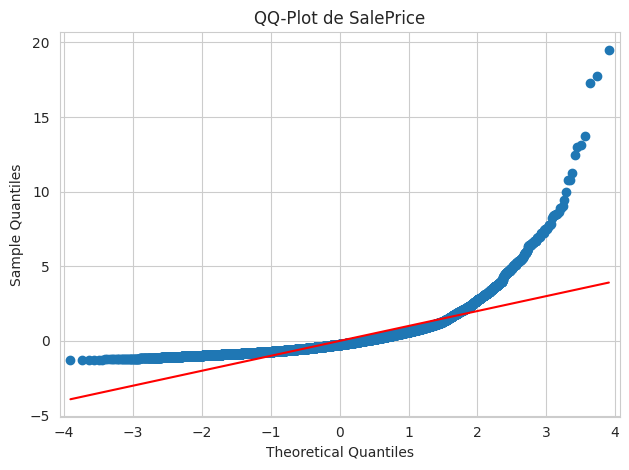

In [17]:
plt.figure(figsize=(10, 6))
sm.qqplot(y, line='s', fit=True)

plt.title("QQ-Plot de SalePrice")

plt.tight_layout()
plt.show()

O QQ-Plot da variável `price` (preço de venda dos imóveis) revela que os dados não seguem uma distribuição normal. Os pontos se afastam da linha diagonal nas extremidades, especialmente na cauda direita, indicando uma **assimetria positiva** (cauda direita mais pesada). Esse comportamento é consistente com a presença de outliers e a distribuição assimétrica observada no boxplot.

A não normalidade dos dados pode impactar a validade do modelo de Regressão Linear, uma vez que um dos pressupostos dessa técnica é que os resíduos devem seguir uma distribuição normal. Para corrigir esse problema, recomenda-se a aplicação de uma **transformação logarítmica** na variável `price`, que ajudará a reduzir a assimetria e aproximar os dados de uma distribuição normal. Essa abordagem melhorará a qualidade do modelo e a confiabilidade das inferências estatísticas.

#####  3.1.3.4 Distribuição Dados - skw/Kurt

A assimetria mede o quanto a distribuição dos dados é inclinada para a direita ou para a esquerda em relação à média.

A curtose mede a forma da distribuição em relação às suas caudas (se os valores extremos são mais ou menos frequentes do que em uma distribuição normal).

In [18]:
# Estatísticas descritivas adicionais
print("Skewness (Assimetria):", skew(y))
print("Kurtosis (Curtose):", kurtosis(y))

Skewness (Assimetria): 4.023789858140135
Kurtosis (Curtose): 34.577262255687536


A variável `price` apresenta uma **assimetria (skewness)** de **4,02**, o que indica uma **assimetria positiva forte**. Isso significa que a distribuição dos preços dos imóveis tem uma cauda longa à direita, com muitos valores extremos acima da média. Além disso, a **curtose (kurtosis)** de **34,58** sugere uma distribuição **leptocúrtica**, com caudas extremamente pesadas e um pico muito agudo. Esses valores confirmam a presença de outliers e a necessidade de transformações para normalizar a distribuição, como a aplicação de uma transformação logarítmica.

#####  3.1.3.5  Histograma Variável Dependente

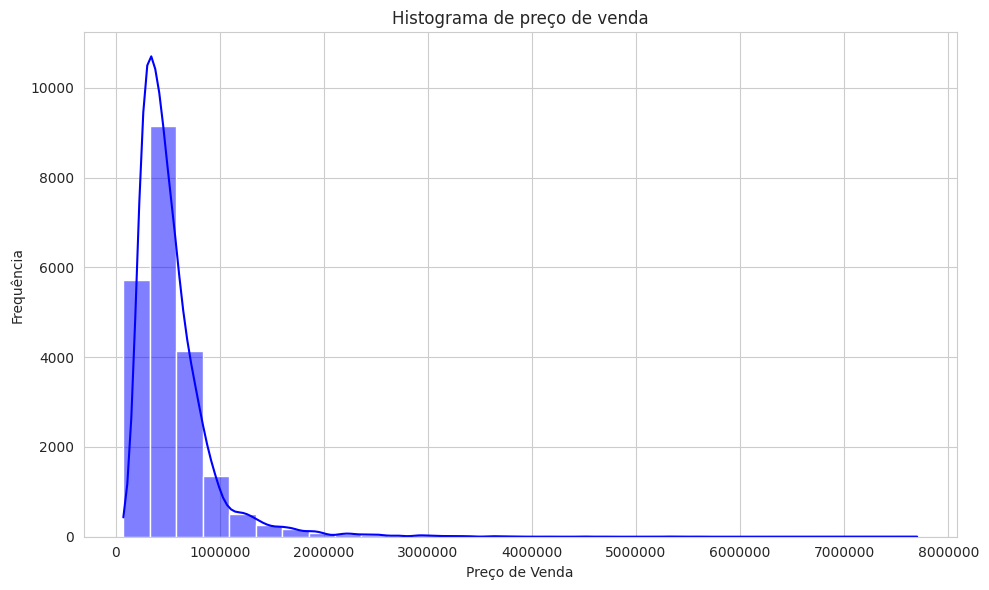

In [19]:
plt.figure(figsize=(10, 6))
sns.histplot(y, kde=True, bins=30, color='blue')
plt.title("Histograma de preço de venda")
plt.xlabel("Preço de Venda")
plt.ylabel("Frequência")

plt.ticklabel_format(style='plain', axis='x')

plt.tight_layout()
plt.show()

O histograma confirma que a distribuição da variável preço de venda não é normal, apresentando alta assimetria à direita e curtose elevada. Esse comportamento reforça a necessidade de ajustes para garantir que os modelos preditivos tenham um desempenho mais robusto e interpretem corretamente a relação entre os atributos do imóvel e seu preço.

A presença de outliers pode impactar negativamente o modelo de Regressão Linear, tornando-o menos preciso. Para mitigar esse problema, recomenda-se a aplicação de uma **transformação logarítmica** na variável `price`, que ajudará a normalizar a distribuição e reduzir o impacto dos valores extremos. Além disso, a segmentação do mercado em categorias distintas (ex.: imóveis comuns vs. imóveis de luxo) pode ser uma estratégia eficaz para melhorar a precisão do modelo, abaixo demonstramos como a transformação logaritmica auxiliará nas premissas de normailidade dos dados, assumindo que usaremos regressão logistica.

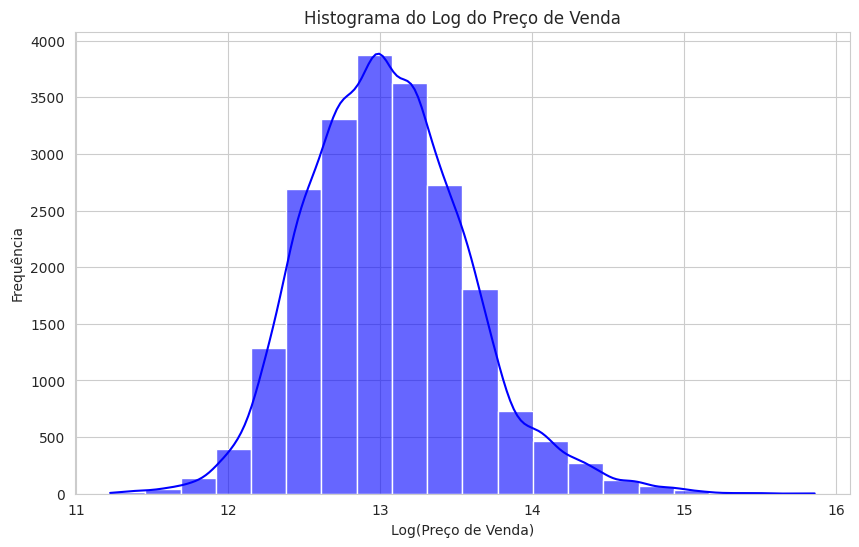

In [20]:
log_price = np.log1p(y)  # log1p evita problemas com log(0)

# Criando o histograma
plt.figure(figsize=(10, 6))
sns.histplot(log_price, bins=20, kde=True, color='blue', alpha=0.6)
plt.xlabel("Log(Preço de Venda)")
plt.ylabel("Frequência")
plt.title("Histograma do Log do Preço de Venda")
plt.grid(True)
plt.show()

####  3.1.4  Análise da Variáveis Explanatórias

Uma variável independente **X** explica a variação em outra variável, que é chamada variável dependente *y*. Este relacionamento existe em apenas uma direção:

variável independente (**X**) **->** variável dependente (*y*)


In [22]:
X.head()

,id,date,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,3,1.00,1180,5650,1.00,0,0,3,7,1180,0,1955,0,98178,47.51,-122.26,1340,5650
1,6414100192,20141209T000000,3,2.25,2570,7242,2.00,0,0,3,7,2170,400,1951,1991,98125,47.72,-122.32,1690,7639
2,5631500400,20150225T000000,2,1.00,770,10000,1.00,0,0,3,6,770,0,1933,0,98028,47.74,-122.23,2720,8062
3,2487200875,20141209T000000,4,3.00,1960,5000,1.00,0,0,5,7,1050,910,1965,0,98136,47.52,-122.39,1360,5000
4,1954400510,20150218T000000,3,2.00,1680,8080,1.00,0,0,3,8,1680,0,1987,0,98074,47.62,-122.05,1800,7503


Para facilitar as análises gráficas das variáveis explanatóras, iremos categorizá-las em grupos temáticos, permitindo comparações mais intuitivas

##### 3.1.4.1 Localização  

Variáveis relacionadas à posição geográfica do imóvel:  

- **`zipcode`**: CEP  
- **`lat`**: Latitude  
- **`long`**: Longitude  

In [23]:
localizacao = ['zipcode', 'lat', 'long', 'price']
df_localizacao = data[localizacao]

In [24]:
def atribuir_cor_preco(preco):
    if preco <= 500000:
        return 'green'  # Verde para preços até 500 mil
    elif preco <= 1000000:
        return 'yellow'  # Amarelo para preços entre 500 mil e 1 milhão
    elif preco <= 3000000: # Laranja para preços entre 1 milhão e 3 milhões
        return 'orange'
    elif preco <= 5000000: # Roxo para preços entre 3 milhões e 5 milhões
        return 'purple'
    else:
        return 'red'  # Vermelho para preços acima de 1 milhão

In [24]:
mapa = folium.Map(location=[df_localizacao['lat'].mean(), df_localizacao['long'].mean()], zoom_start=10)

for index, row in df_localizacao.iterrows():
    # Chama a função para obter a cor do preço
    cor = atribuir_cor_preco(row['price'])
    folium.CircleMarker(
        location=[row['lat'], row['long']],
        # tamanho do círculo
        radius=5,
        # define a cor dado o valor da linha
        color=cor,
        fill=True,
        fill_color=cor,
        fill_opacity=0.6,
        # exibe o preço no popup (quando clicar no círculo)
        popup=f"Preço: R${row['price']}"
    ).add_to(mapa)

mapa

A maior parte dos pontos no mapa estão em verde e amarela, indicando que a maioria dos imóveis está na faixa de até $1.000.000, sugere que King County possui predominância de imóveis residenciais dentro dessa faixa de preço.

Há pontos laranja e roxo concentrados em algumas regiões específicas, indicando áreas com imóveis de alto padrão. Nota-se também que áreas mais próximas do Lake Washington e da infraestrutura urbana de Seattle e Bellevue apresentam mais pontos amarelos e laranjas, sugerindo que a localização/bairro exercem certa influencia diretamente os preços.

A casa com o maior preço vendida ($ 7.700.000,0) fica próximo ao Volunteer Park!    
<img alt="casa maior valor" width="60%" src="/home/buso/mestrado/aedi-ppca/dados/casa_mais_cara.png">

##### 3.1.4.2 Características Estruturais do Imóvel  
Variáveis que descrevem os aspectos físicos da propriedade:  

- **`sqft_living`**: Área útil em pés²  
- **`sqft_lot`**: Área total do terreno em pés²  
- **`sqft_above`**: Área construída acima do solo  
- **`sqft_basement`**: Área do porão  
- **`floors`**: Número de andares  
- **`bedrooms`**: Número de quartos  
- **`bathrooms`**: Número de banheiros  

In [25]:
estrutura_imovel = ['sqft_living', 'sqft_lot', 'sqft_above', 'sqft_basement', 'floors', 'bedrooms', 'bathrooms']

Os gráficos abaixo, permitirá visualizar as relações entre as variáveis explanatórias e a variável dependente `price`. A dispersão dos pontos fornece insights sobre a variação dos preços de venda em função de cada característica, enquanto a linha de regressão destaca a tendência geral da relação. Essa abordagem facilita a identificação de padrões, possíveis associações lineares, outliers e comportamentos não lineares que podem impactar a modelagem.

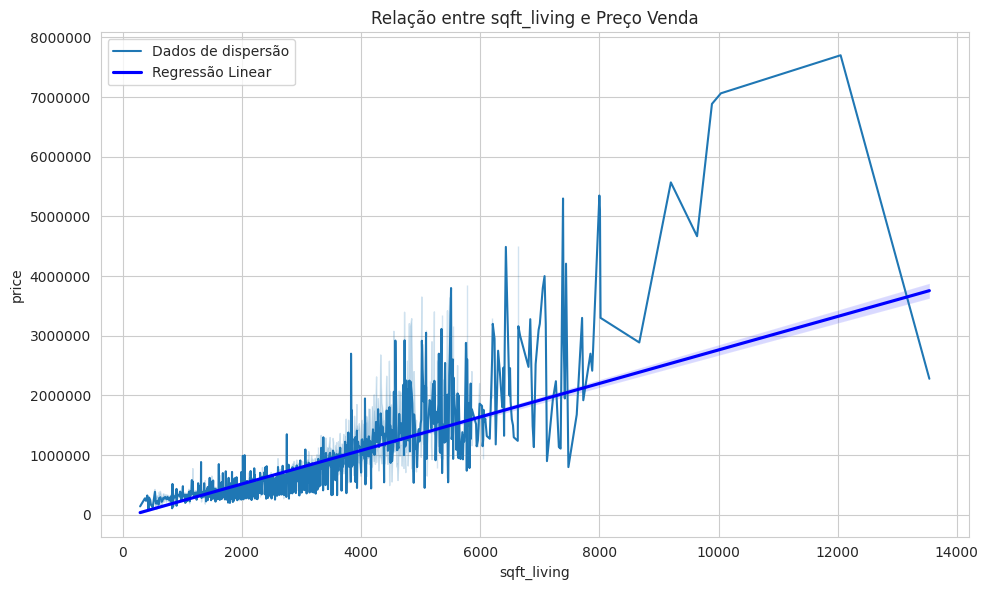

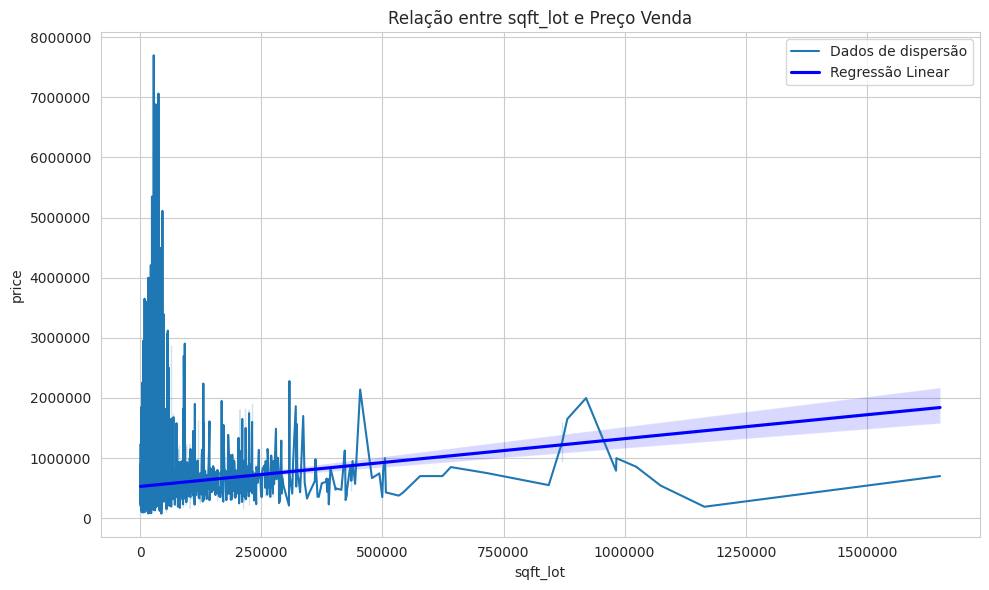

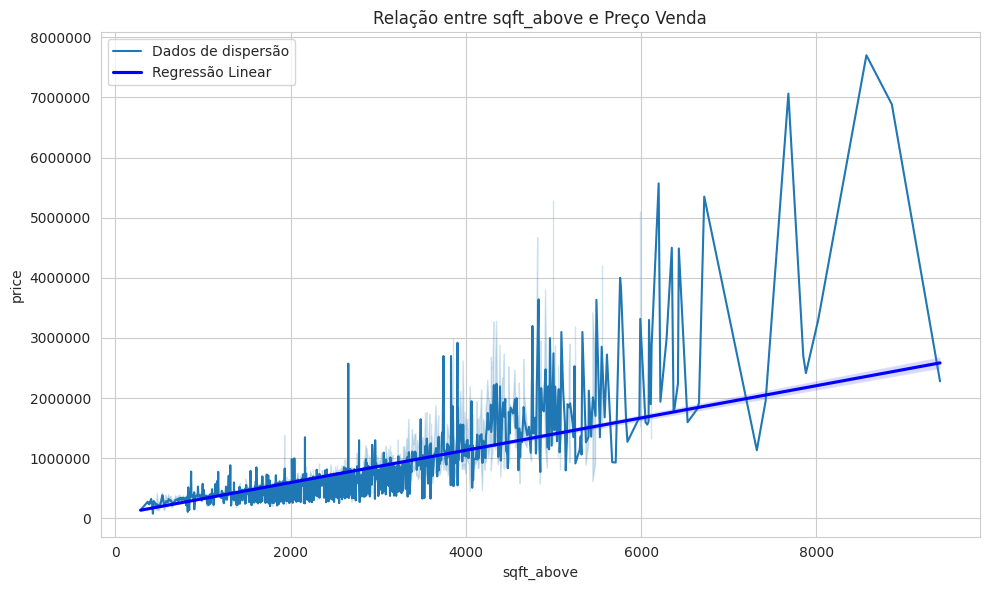

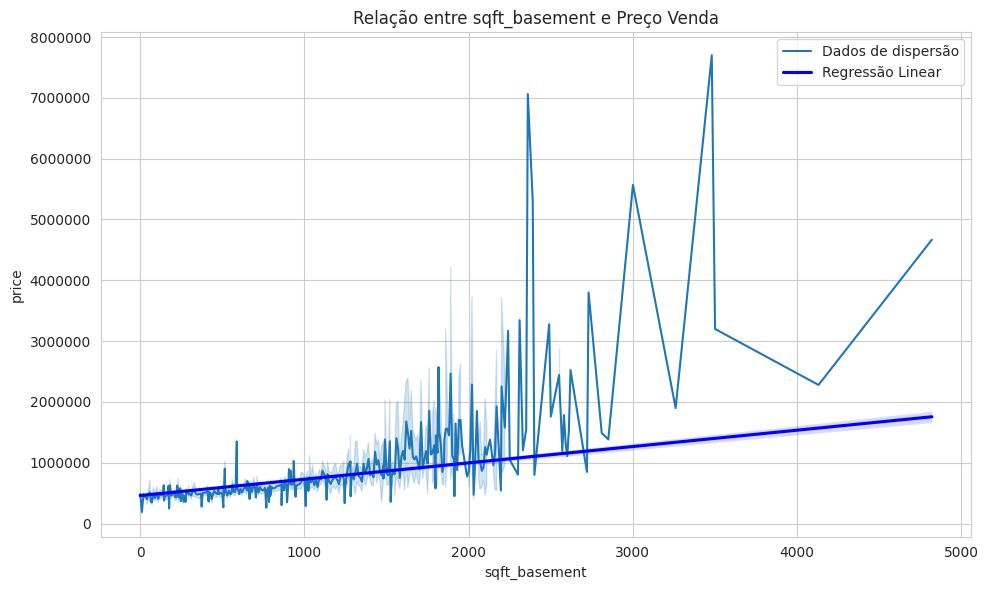

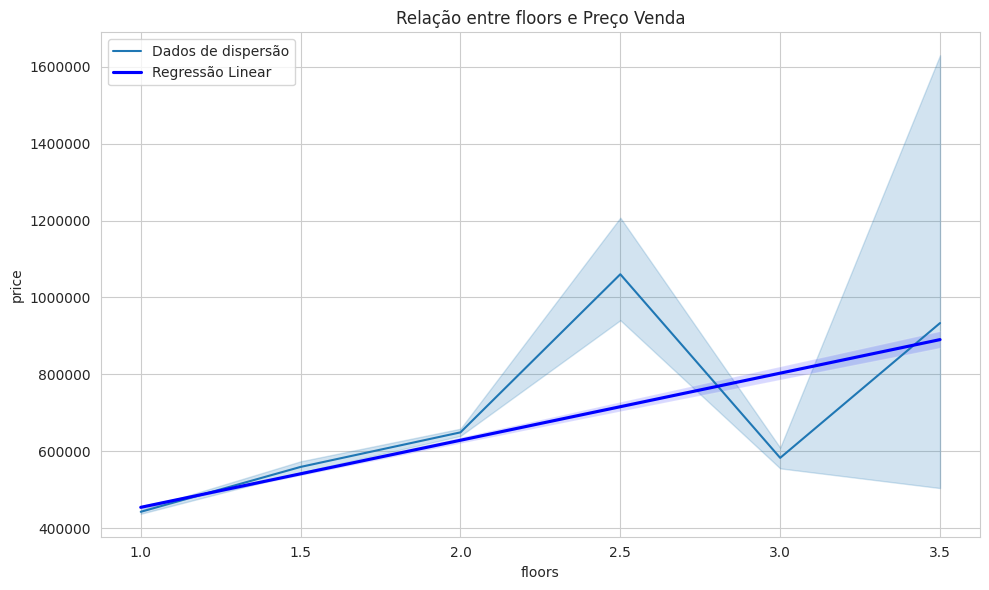

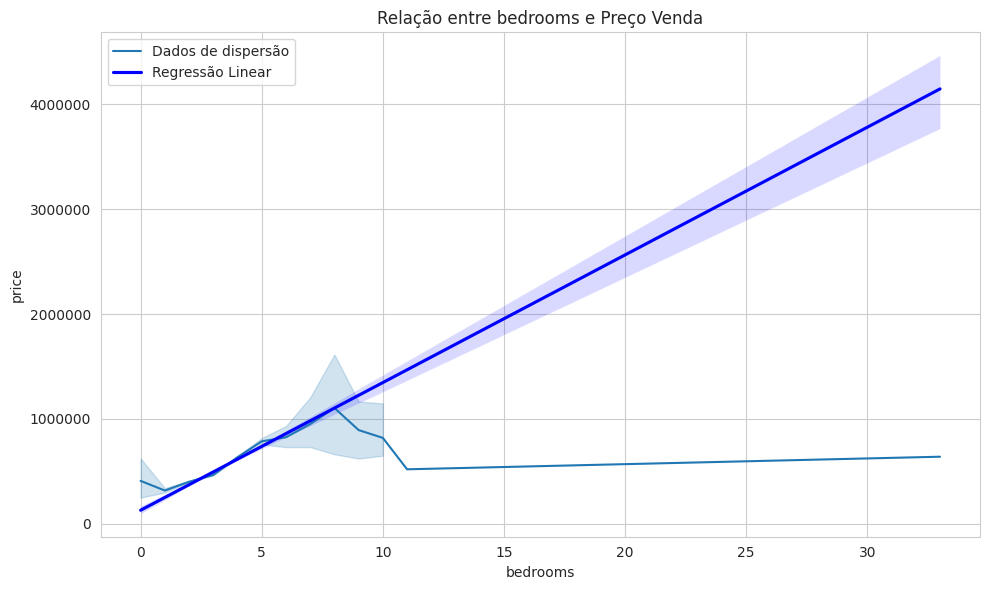

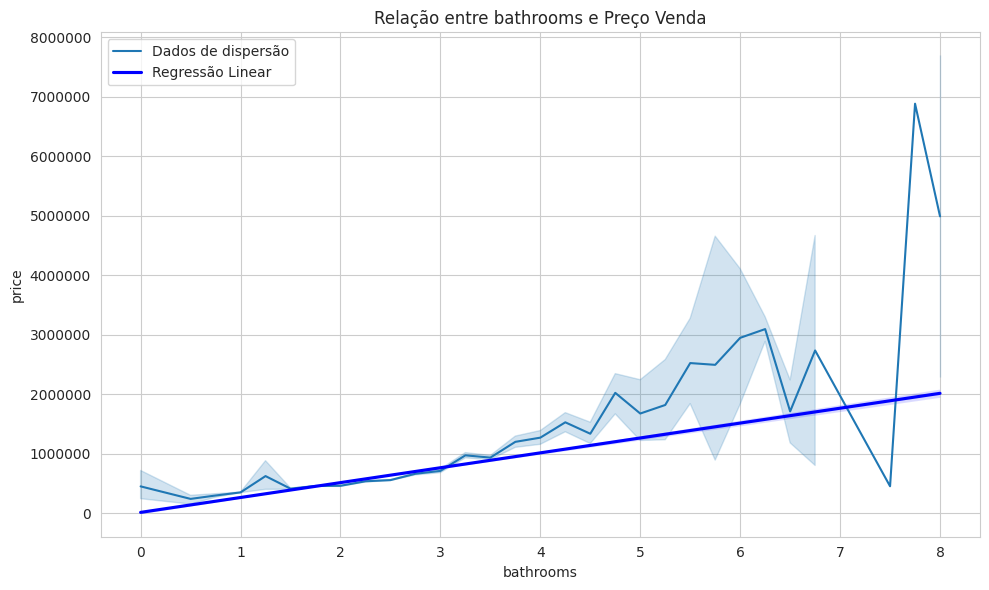

In [26]:
for feature in estrutura_imovel:
    plt.figure(figsize=(10, 6))
    sns.lineplot(x=X[feature], y=y, palette="viridis", label='Dados de dispersão')
    sns.regplot(x=X[feature], y=y, scatter=False, color='blue', label='Regressão Linear')

    plt.title(f"Relação entre {feature} e Preço Venda")

    plt.ticklabel_format(style='plain', axis='x')
    plt.ticklabel_format(style='plain', axis='y')
    plt.xlabel(feature)
    plt.ylabel("price")
    plt.legend()
    
    plt.tight_layout()
    plt.show()

| **Variável**       | **Relação com Preço**       | **Insight**                                                                 |
|---------------------|-----------------------------|-----------------------------------------------------------------------------|
| **sqft_living**     | Positiva                   | Áreas úteis maiores aumentam o preço, mas com dispersão para imóveis grandes. |
| **sqft_lot**        | Fraca                      | A área do terreno tem impacto limitado no preço, a menos que seja associada a outros fatores. |
| **sqft_above**      | Positiva forte             | Áreas construídas maiores acima do solo são preditores consistentes de preços mais altos. |
| **sqft_basement**   | Moderada                   | Porões maiores agregam valor, mas o impacto depende de outros fatores.      |
| **floors**          | Não linear                 | Imóveis com 1,5 a 2,5 andares tendem a ser os mais valorizados.             |
| **bedrooms**        | Não linear                 | Imóveis com 3 a 5 quartos são os mais valorizados; mais quartos podem não agregar valor proporcional. |
| **bathrooms**       | Positiva                   | Banheiros adicionais aumentam o preço, mas o impacto diminui após 5 banheiros. |

Importe ressaltar que na base existem registros em que o registro de andares é valor decimal!

In [27]:
X['floors'].unique()

array([1. , 2. , 1.5, 3. , 2.5, 3.5])

##### 3.1.4.2.1 Correlação dos atributos estruturais

In [28]:
estrutura_imovel = ['sqft_living', 'sqft_lot', 'sqft_above', 'sqft_basement', 'floors', 'bedrooms', 'bathrooms', 'price']
data[estrutura_imovel].corr()

,sqft_living,sqft_lot,sqft_above,sqft_basement,floors,bedrooms,bathrooms,price
sqft_living,1.00,0.17,0.88,0.44,0.35,0.58,0.75,0.70
sqft_lot,0.17,1.00,0.18,0.02,-0.01,0.03,0.09,0.09
sqft_above,0.88,0.18,1.00,-0.05,0.52,0.48,0.69,0.61
sqft_basement,0.44,0.02,-0.05,1.00,-0.25,0.30,0.28,0.32
floors,0.35,-0.01,0.52,-0.25,1.00,0.18,0.50,0.26
bedrooms,0.58,0.03,0.48,0.30,0.18,1.00,0.52,0.31
bathrooms,0.75,0.09,0.69,0.28,0.50,0.52,1.00,0.53
price,0.70,0.09,0.61,0.32,0.26,0.31,0.53,1.00


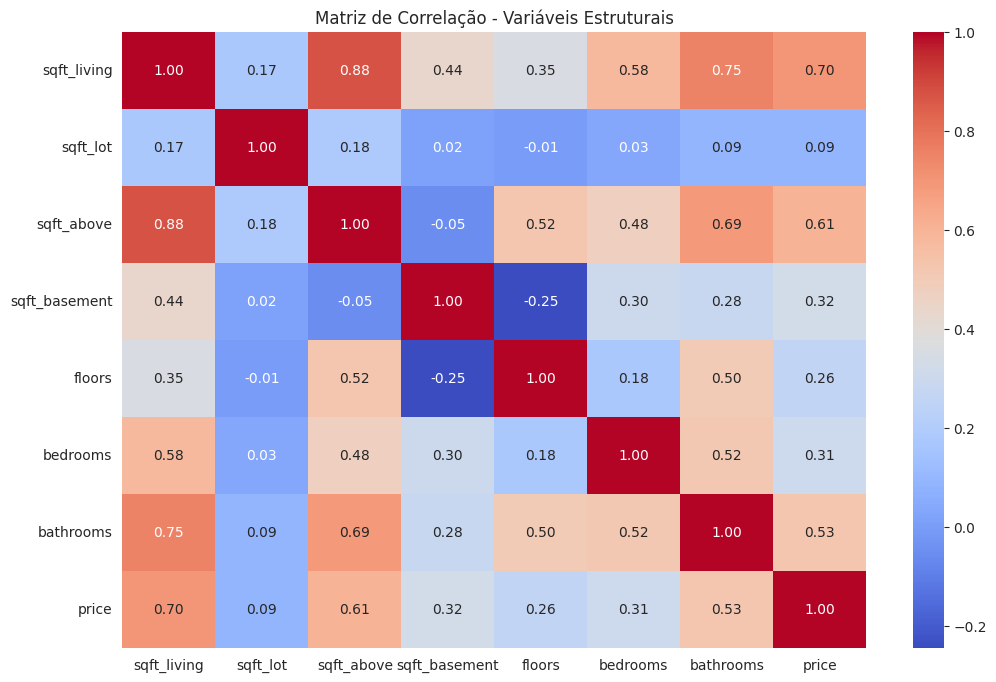

In [29]:
plt.figure(figsize=(12, 8))
correlation_matrix = data[estrutura_imovel].corr()
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Matriz de Correlação - Variáveis Estruturais")
plt.show()

1️⃣ `sqft_living` (Área útil) → Correlação com variável *target* = 0,70. A variável mais correlacionada com o preço, quanto maior a área útil, maior o preço do imóvel.

2️⃣ `bathrooms` (Número de banheiros) → Correlação com variável *target* = 0,53. Impacto significativo no preço, casas com mais banheiros tendem a ter maior valorização. No entanto pode estar relacionada a `sqft_living`.

3️⃣ `sqft_above` (Área construída acima do solo) → Correlação com a variável *target* = 0,61. Possui uma alta correlação com `sqft_living` (0,88), podendo indicar multicolinearidade. Como `sqft_living` já inclui essa área, podemos testar remover essa variável e avaliar o impacto. Motivo -> evitar multicolinearidade.

4️⃣ `bedrooms` (Número de quartos) → Correlação com a variável *target* = 0,31. Menos relevante que `sqft_living` e `bathrooms`. Poderá ser mantida para interpretação, mas não é essencial.

5️⃣ `floors` (Número de andares) → Correlação com a variável *target* = 0,26. Impacto menor do que o esperado, conhecimento *a priore* era que quanto mais andares, mais espaço poderia ter a casa. Pode indicar que o número de andares não é um fator crítico na precificação.

6️⃣ `sqft_basement` (Área do porão) → Correlação com a variável *target* = 0,32. Impacto pequeno, mas pode ser interessante em áreas urbanas, para armazenamento.

7️⃣ `sqft_lot` (Área do terreno) → Correlação com a variável *target* = 0,09 muito baixa com o preço. O tamanho do terreno não é um grande determinante do valor do imóvel. Poderá ser descartada do modelo sem grande perda de informação.

##### 3.1.4.3 Qualidade da Construção e Infraestrutura  
Variáveis que indicam a condição e a qualidade do imóvel:  

- **`grade`**: Avaliação da construção (escala de 1 a 13)  
- **`condition`**: Estado geral da casa (escala de 1 a 5)  
- **`yr_built`**: Ano de construção  
- **`yr_renovated`**: Ano da última renovação  

Aqui podemos identificar que 2 variáveis representam caracteristicas típicas de variáveis categóricas, sendo as features `grade` e `condition`. Vamos analisá-las separadamente. A descrição dessas features estão [abaixo](https://info.kingcounty.gov/assessor/esales/Glossary.aspx?type=r).

`grade` -> nota recebida referente a classificação da construção, representa a qualidade construtiva das melhorias.

* 1-3: Fica aquém dos padrões mínimos de construção.

* 4: Construção geralmente **mais antiga** e de **baixa qualidade**.

* 5: Baixos custos de construção e mão de obra. Design pequeno e simples.

* 6: Nota mais baixa que atende atualmente ao código de construção. Materiais de baixa qualidade e designs simples.

* 7: Grau médio de construção e design.

* 8: Um pouco acima da média em construção e design. Geralmente melhores materiais no trabalho de acabamento externo e interno.

* 9: Melhor projeto arquitetônico com design e qualidade extra de interiores e exteriores.

* 10: Casas dessa qualidade geralmente têm características de alta qualidade. O trabalho de acabamento é melhor e mais qualidade de design é vista nas plantas baixas. Geralmente tem uma metragem quadrada maior.

* 11: Design personalizado e acabamento de alta qualidade funcionam com comodidades adicionais de madeiras maciças, louças sanitárias e opções mais luxuosas.

* 12: Design personalizado e excelentes construtores. Todos os materiais são da mais alta qualidade e todas as conveniências estão presentes.

* 13: Geralmente projetado e construído sob medida. Nível mansão. Grande quantidade de trabalho da mais alta qualidade, acabamento em madeira, mármore, entradas, etc.



`condition` => relação à idade e a nota recebida. Codificado 1-5.

* 1 Pobre - Desgastado: Reparo e revisão necessários em superfícies pintadas, telhados, encanamentos, aquecimento e inúmeras inadequações funcionais. Manutenção e abuso diferidos excessivos, valor limitado em uso, abandono iminente ou grande reconstrução; A reutilização ou mudança na ocupação é iminente. A idade efetiva está próxima do final da escala, independentemente da idade cronológica real.

* 2 Justo - Muito desgastado: Muito reparo necessário. Muitos itens precisam de retoque ou revisão, manutenção adiada óbvia, utilidade e sistemas de construção inadequados, todos encurtando a expectativa de vida e aumentando a idade efetiva.

* 3 Média: Alguma evidência de manutenção adiada e obsolescência normal com a idade, pois alguns pequenos reparos são necessários, juntamente com alguns retoques. Todos os principais componentes ainda funcionais e contribuindo para uma expectativa de vida prolongada. A idade e a utilidade efetivas são padrão para propriedades semelhantes de sua classe e uso.

* 4 Bom: Nenhuma manutenção óbvia necessária, mas nem tudo é novo. A aparência e a utilidade estão acima do padrão e a idade efetiva geral será menor do que a propriedade típica.

* 5 Muito Bom: Todos os itens bem conservados, muitos tendo sido revisados e reparados por apresentarem sinais de desgaste, aumentando a expectativa de vida e diminuindo a idade efetiva com pouca deterioração ou obsolescência evidente com alto grau de utilidade.

In [30]:
qualidade_construcao = ['grade', 'condition']   

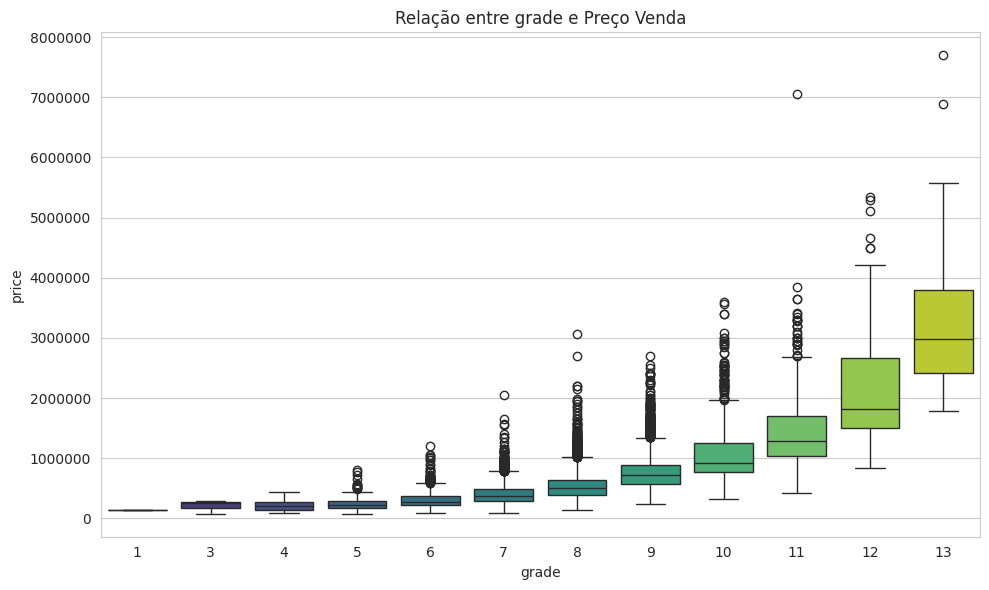

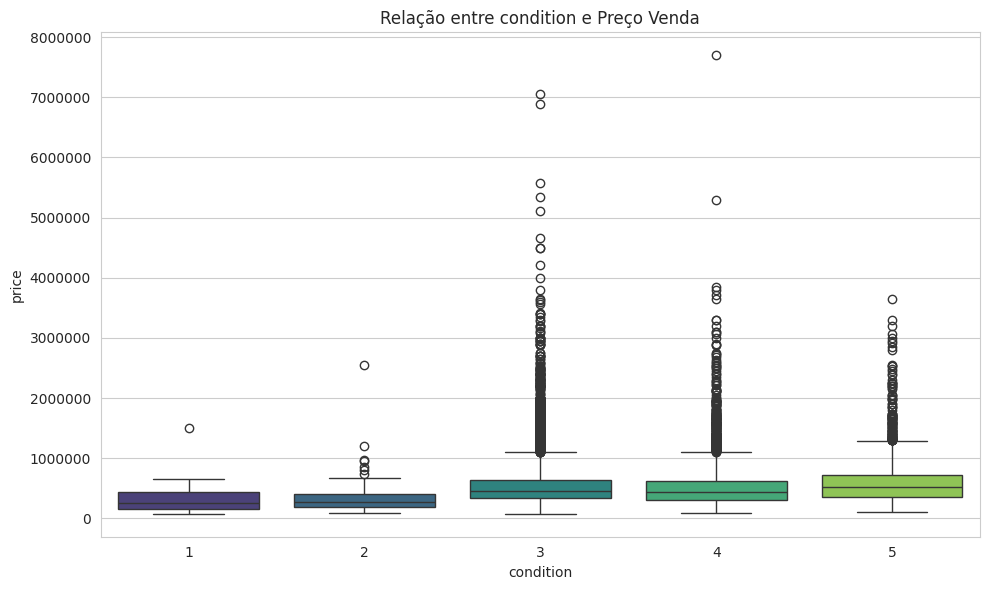

In [31]:
for feature in qualidade_construcao:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x=data[feature], y=y, palette="viridis")

    plt.title(f"Relação entre {feature} e Preço Venda")
    plt.xlabel(feature)
    plt.ylabel("price")
    #plt.ticklabel_format(style='plain', axis='x')
    plt.ticklabel_format(style='plain', axis='y')
    
    plt.tight_layout()
    plt.show()

A variável `grade` representa a qualidade da construção, variando de 1 a 13, onde 1 é de qualidade muito baixa e 13 indica um padrão de construção superior. Existe uma relação clara e crescente entre `grade` e `price`.

Imóveis com `grade` baixa (≤6) têm preços médios bem menores. A valorização é mais expressiva a partir do `grade` 8, onde os preços começam a crescer significativamente. Imóveis com `grade` ≥10 mostram grande dispersão, indicando que casas de alto padrão têm grande variação nos preços. Logo a featura `grade` é um fator que pode explicar o preço do imóvel. 

A variável `condition` mede o estado físico do imóvel e varia de 1 (muito ruim) a 5 (excelente). A relação entre `condition` (estado de conservação) e `price` preço de venda, diferentemente de `grade`, não evidencia um padrão de valorização clara. A mediana dos preços é semelhante entre níveis 2 a 5. Além de que imóveis com `condition` = 5 não são muito mais caros do que os de `condition`  entre 3 ou 4.
Existe alta dispersão em todos os níveis, sugerindo que a condição do imóvel não é um grande fator de precificação isoladamente.

In [32]:
data.groupby('grade')['price'].describe()

,count,mean,std,min,25%,50%,75%,max
grade,,,,,,,,
1,1.00,142000.00,NaN,142000.00,142000.00,142000.00,142000.00,142000.00
3,3.00,205666.67,113517.99,75000.00,168500.00,262000.00,271000.00,280000.00
4,29.00,214381.03,94306.17,80000.00,145000.00,205000.00,265000.00,435000.00
5,242.00,248523.97,118100.28,78000.00,175000.00,228700.00,295750.00,795000.00
6,2038.00,301919.64,122970.28,82000.00,215037.50,275276.50,366837.50,1200000.00
7,8981.00,402590.26,155876.92,90000.00,285000.00,375000.00,485000.00,2050000.00
8,6068.00,542852.77,217473.37,140000.00,390000.00,510000.00,640000.00,3070000.00
9,2615.00,773513.19,316120.08,230000.00,571500.00,720000.00,880000.00,2700000.00
10,1134.00,1071771.07,483545.09,316000.00,768087.50,914327.00,1250000.00,3600000.00


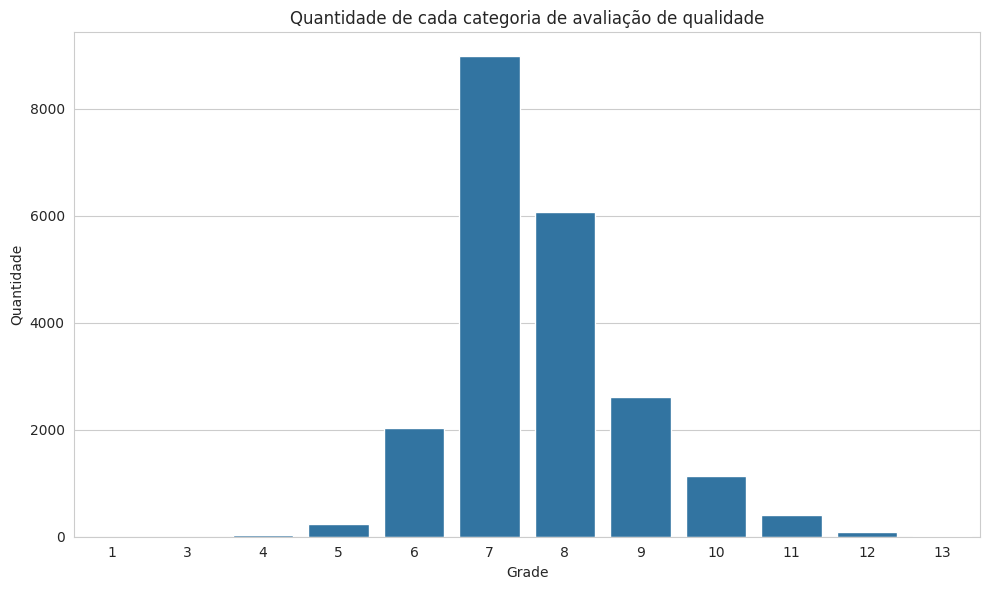

In [33]:
grade_counts = data.groupby('grade').size().reset_index(name='counts')

plt.figure(figsize=(10, 6))
sns.barplot(x='grade', y='counts', data=grade_counts)

plt.title('Quantidade de cada categoria de avaliação de qualidade')
plt.xlabel('Grade')
plt.ylabel('Quantidade')

plt.tight_layout()
plt.show()

In [34]:
data.groupby('condition')['price'].describe()

,count,mean,std,min,25%,50%,75%,max
condition,,,,,,,,
1,30.00,334431.67,271172.80,78000.00,160000.00,262500.00,431125.00,1500000.00
2,172.00,327287.15,245418.41,80000.00,189750.00,279000.00,397300.00,2555000.00
3,14031.00,542012.58,364449.06,75000.00,329500.00,450000.00,640000.00,7062500.00
4,5679.00,521200.39,358516.23,89000.00,305000.00,440000.00,625000.00,7700000.00
5,1701.00,612418.09,410971.92,110000.00,350000.00,526000.00,725000.00,3650000.00


In [35]:
category_counts_agg = data.groupby(['grade', 'condition']).agg(
    mean_price=('price', 'mean'),
    count=('price', 'size')
    ).reset_index()
category_counts_agg

,grade,condition,mean_price,count
0,1,1,142000.00,1
1,3,2,280000.00,1
2,3,3,75000.00,1
3,3,5,262000.00,1
4,4,1,150000.00,1
5,4,2,179600.00,5
6,4,3,210000.00,13
7,4,4,243905.00,10
8,5,1,280833.33,9
9,5,2,206166.67,15


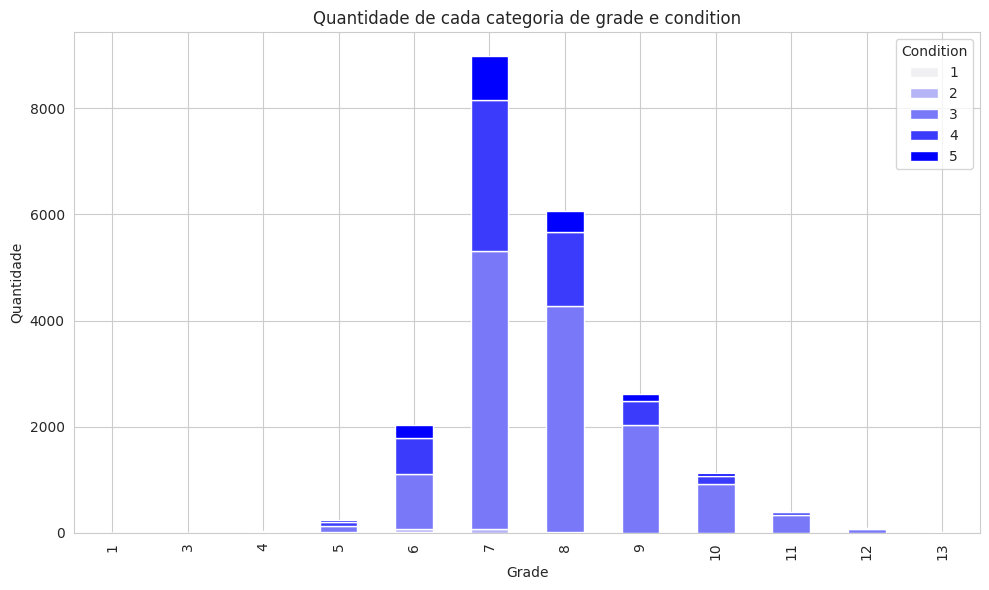

In [36]:
category_counts = data.groupby(['grade', 'condition']).size().unstack(fill_value=0)
palette = sns.light_palette("blue", n_colors=len(category_counts.columns))

category_counts.plot(kind='bar', stacked=True, figsize=(10, 6), color=palette)

plt.title('Quantidade de cada categoria de grade e condition')
plt.xlabel('Grade')
plt.ylabel('Quantidade')
plt.legend(title='Condition')

plt.tight_layout()
plt.show()


Observando por estratos a distribuição das *features* `grade` e `condition`, nota-se uma concentração certas categorias. A maioria dos imóveis tem `grade` entre 6 e 9, com destaque para `grade` 7, que domina a amostra. Pouquíssimos imóveis possuem `grades` extremas (1, 3, 4, 12 e 13).

A variável `condition` predomina em níveis intermediários, sendo 3 e 4 são as mais comuns em todas as faixas de `grade`.
Condition 5 (excelente estado) aparece mais em imóveis de grade elevada (9+), mas em quantidade reduzida.

Imóveis com `condition` 1 e 2 são raros, indicando que a maioria das casas está em estado razoável ou bom. Na outra ponta, imóveis de alto padrão (`grade` > 10) também são pouco frequentes.

Poucos imóveis atingem os níveis mais altos de `grade` (10-13), o que explica a maior dispersão de preços observada nos boxplots anteriores. A maior parte dos imóveis com `condition` 5 está associada a `grade` superiores a 7, reforçando a correlação entre qualidade da construção e estado de conservação.

Vamos verificar as features relacionadas ao tempo que as construiçoes possuem, sendo a variável `yr_built` que representa o ano de construção e a feature `yr_renovated` o ano da última reforma.

In [37]:
idade_construcao = data[['yr_built', 'yr_renovated', 'price']]

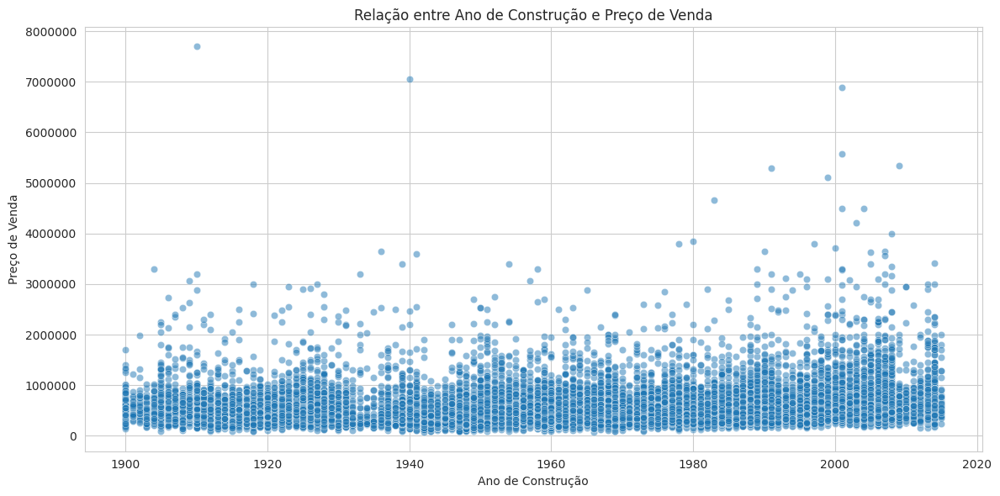

In [38]:
plt.figure(figsize=(12,6))
sns.scatterplot(data=idade_construcao, x='yr_built', y='price', alpha=0.5)

plt.title("Relação entre Ano de Construção e Preço de Venda")
plt.xlabel("Ano de Construção")
plt.ylabel("Preço de Venda")
plt.ticklabel_format(style='plain', axis='y')

plt.tight_layout()
plt.show()

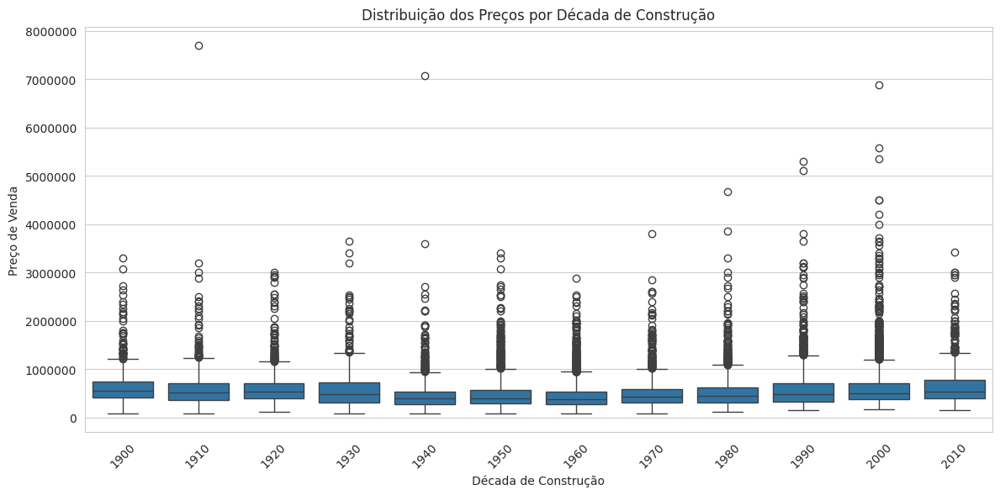

In [39]:
idade_construcao['decade_built'] = (idade_construcao['yr_built'] // 10) * 10  # Criar faixas por década

plt.figure(figsize=(12,6))
sns.boxplot(data=idade_construcao, x='decade_built', y='price')

plt.xticks(rotation=45)
plt.title("Distribuição dos Preços por Década de Construção")
plt.xlabel("Década de Construção")
plt.ylabel("Preço de Venda")
plt.ticklabel_format(style='plain', axis='y')

plt.tight_layout()
plt.show()


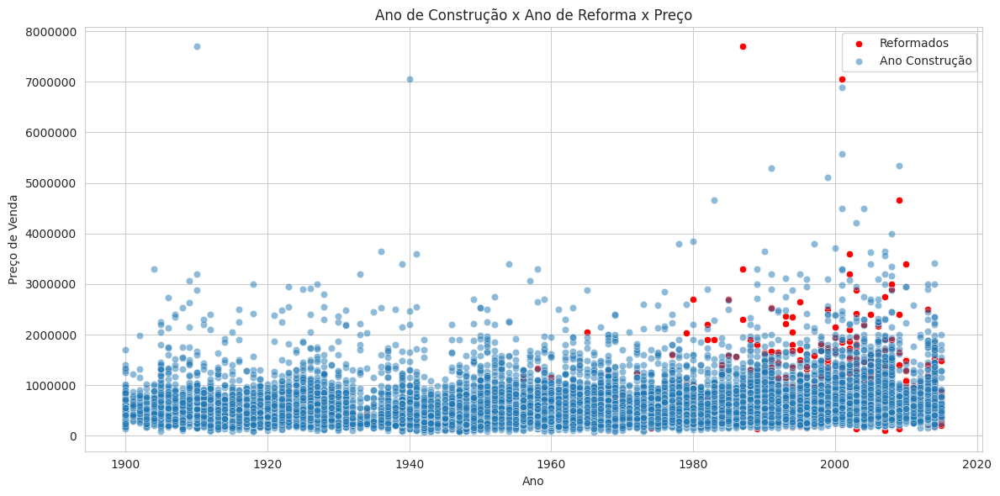

In [40]:
plt.figure(figsize=(12,6))
sns.scatterplot(data=idade_construcao[idade_construcao['yr_renovated'] > 0], x='yr_renovated', y='price', color='red', label="Reformados")
sns.scatterplot(data=idade_construcao, x='yr_built', y='price', alpha=0.5, label="Ano Construção")

plt.title("Ano de Construção x Ano de Reforma x Preço")
plt.xlabel("Ano")
plt.ylabel("Preço de Venda")
plt.legend()
plt.ticklabel_format(style='plain', axis='y')

plt.tight_layout()
plt.show()


In [41]:
# idade_construcao['yr_renovated'].value_counts()
print(f'Apenas {data.shape[0] - data['yr_renovated'].loc[data['yr_renovated'] == 0].count()} imóveis foram reformados.')

Apenas 914 imóveis foram reformados.


Os imóveis foram construídos entre os anos 1900 a 2015. Não há um aumento claro do preço com a idade do imóvel, mas imóveis construídos após 2000 tendem a ter mais pontos em valores elevados. Observa-se que o ponto maior do preço foi um imóvel construído próximo da década de 1910, sugerindo assim que esse valor pode ser justificado por fatos históricos, o que precisa ser melhor verificado. Muito embora existem outliers com preços muito altos em diferentes períodos. Imóveis mais novos podem ser mais caros, mas há uma grande variação. A idade isoladamente não é um fator determinante.

A mediana dos preços não aumenta de forma linear ao longo das décadas. Há alta dispersão de preços em todas as décadas, com outliers em cada uma.
Imóveis construídos após o ano de 1990 apresentam maior concentração de preços elevados. Embora imóveis mais novos possam ter preços mais altos, há imóveis antigos com preços semelhantes.

Os pontos vermelhos representam imóveis reformados. Os dados mostram que reformas são mais comuns após 1980 e estão associadas a preços elevados. No entanto muitos imóveis antigos não foram reformados e mantêm valores médios.

##### 3.1.4.4 Atributos Externos e Vizinhança  
Variáveis que influenciam o valor do imóvel devido à localização ou benefícios adicionais:  

- **`waterfront`**: Vista para o mar (0 = não, 1 = sim)  
- **`view`**: Classificação da vista (escala de 0 a 4)  
- **`sqft_living15`**: Média da área útil das 15 casas mais próximas  
- **`sqft_lot15`**: Média da área total dos lotes das 15 casas mais próximas 

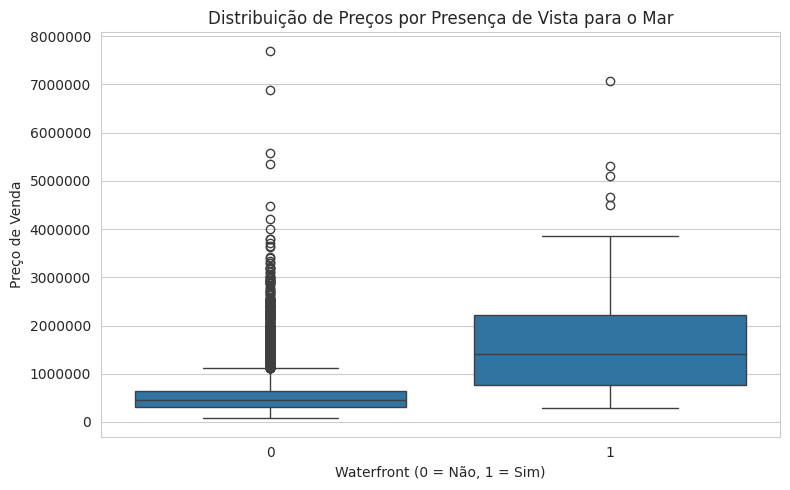

In [42]:
plt.figure(figsize=(8,5))
sns.boxplot(data= data, x='waterfront', y='price')

plt.title("Distribuição de Preços por Presença de Vista para o Mar")
plt.xlabel("Waterfront (0 = Não, 1 = Sim)")
plt.ylabel("Preço de Venda")
plt.ticklabel_format(style='plain', axis='y')

plt.tight_layout()
plt.show()

Imóveis com vista para o mar (`waterfront` = 1) têm preços médios significativamente maiores do que os sem vista, tomando com base a mediana dos preços para casas com vistas para o mar estar acima da mediana de observações em que o `waterfront` = 0. Observa-se outliers, nos dois grupos. Sendo assim, imóveis à beira-mar têm uma valorização notável.

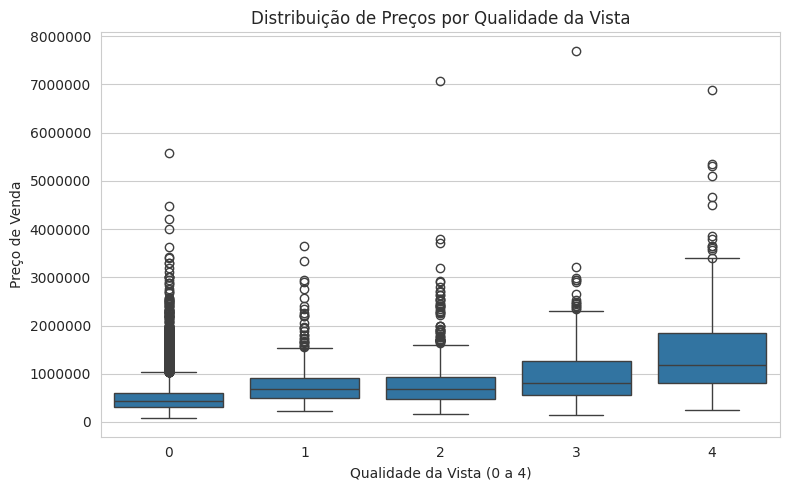

In [43]:
plt.figure(figsize=(8,5))
sns.boxplot(data=data, x='view', y='price')

plt.title("Distribuição de Preços por Qualidade da Vista")
plt.xlabel("Qualidade da Vista (0 a 4)")
plt.ylabel("Preço de Venda")
plt.ticklabel_format(style='plain', axis='y')

plt.tight_layout()
plt.show()
plt.show()


Existe uma tendência de aumento dos preços conforme a qualidade da vista aumenta (`view` de 0 a 4).
Para view = 4, a mediana dos preços é bem superior às demais categorias. Ainda podemos identificar que para as faixas de 0 à 2 a distribuição dos preços são similares.

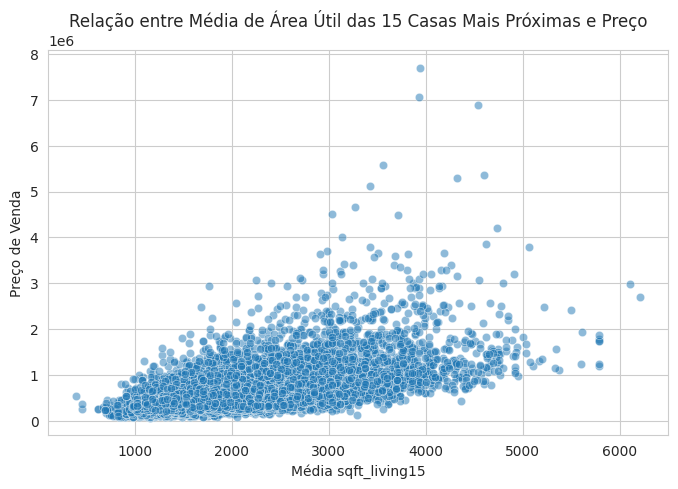

In [44]:
plt.figure(figsize=(8,5))
sns.scatterplot(data=data, x='sqft_living15', y='price', alpha=0.5)
plt.title("Relação entre Média de Área Útil das 15 Casas Mais Próximas e Preço")
plt.xlabel("Média sqft_living15")
plt.ylabel("Preço de Venda")
plt.show()


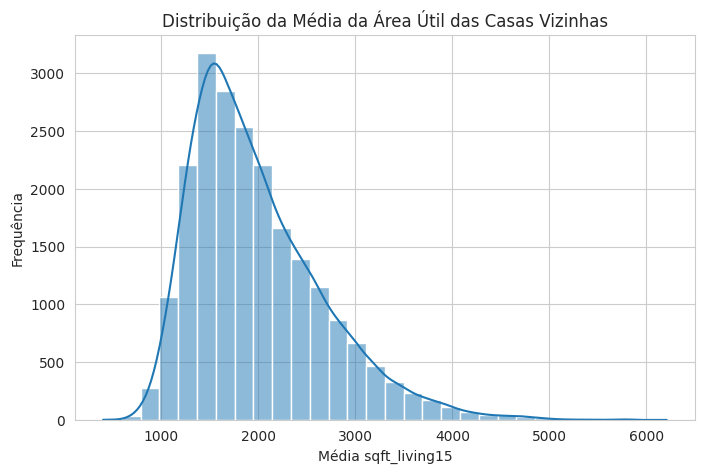

In [45]:
plt.figure(figsize=(8,5))
sns.histplot(data['sqft_living15'], bins=30, kde=True)
plt.title("Distribuição da Média da Área Útil das Casas Vizinhas")
plt.xlabel("Média sqft_living15")
plt.ylabel("Frequência")
plt.show()


Há uma certa relação positiva entre `sqft_living15` e o preço de venda, ou seja, quanto maior a média da área útil das casas próximas, maior tende a ser o preço do imóvel. A relação não é estritamente linear, mas há um padrão crescente claro.

A maioria das casas vizinhas tem área útil entre 1.500 e 2.500 sqft. A distribuição é assimétrica, com poucos imóveis tendo sqft_living15 acima de 4.000 sqft.

##### 3.1.4.5 Avaliando a Multicolinearidade

A avaliação de multicolinearidade é um passo essencial em análises de regressão linear, pois a presença de correlações elevadas entre variáveis explicativas pode distorcer os coeficientes do modelo, dificultando a interpretação e reduzindo sua precisão preditiva. Uma das ferramentas mais utilizadas para diagnosticar multicolinearidade é o Fator de Inflação da Variância (Variance Inflation Factor - VIF). O VIF mede o quanto a variância de um coeficiente de regressão é inflada devido à correlação entre variáveis explicativas.

Vlores de VIF acima de 10 são geralmente considerados indicadores de multicolinearidade severa, enquanto valores próximos de 1 sugerem baixa correlação. Essa métrica ajuda a identificar quais variáveis podem ser redundantes e devem ser ajustadas ou removidas do modelo, melhorando sua robustez e interpretabilidade.

In [46]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 20 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   bedrooms       21613 non-null  int64  
 3   bathrooms      21613 non-null  float64
 4   sqft_living    21613 non-null  int64  
 5   sqft_lot       21613 non-null  int64  
 6   floors         21613 non-null  float64
 7   waterfront     21613 non-null  int64  
 8   view           21613 non-null  int64  
 9   condition      21613 non-null  int64  
 10  grade          21613 non-null  int64  
 11  sqft_above     21613 non-null  int64  
 12  sqft_basement  21613 non-null  int64  
 13  yr_built       21613 non-null  int64  
 14  yr_renovated   21613 non-null  int64  
 15  zipcode        21613 non-null  int64  
 16  lat            21613 non-null  float64
 17  long           21613 non-null  float64
 18  sqft_l

In [47]:
numerical_features = ['price', 'bedrooms', 'bathrooms', 'sqft_living',
       'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_basement','sqft_living15']

In [48]:
vif_data = pd.DataFrame()
vif_data["Feature"] = numerical_features
vif_data["VIF"] = [variance_inflation_factor(data[numerical_features].values, i) for i in range(data[numerical_features].shape[1])]

In [49]:
print("\nVariance Inflation Factor (VIF):")
print(vif_data)


Variance Inflation Factor (VIF):
          Feature   VIF
0           price  7.43
1        bedrooms 21.35
2       bathrooms 24.91
3     sqft_living   inf
4          floors 15.80
5      waterfront  1.25
6            view  1.54
7       condition 21.04
8           grade 69.37
9      sqft_above   inf
10  sqft_basement   inf
11  sqft_living15 26.18


> "Em geral, considera-se um problema VIF > 5. Mas esta é uma regra de
> bolso. Há quem diga que acima de 10 é que se deve corrigir o problema de colinearidade... Algumas alternativas para solucionar problemas de multicolinearidade são: regressão por mínimos quadrados parciais (partial least squares, do inglês), regressão de componentes principais (similar a última), regressão de cumeeira (ridge regression)."  
> *(Silva, 2023, p. 199)*


Um dos pressupostos fundamentais da regressão linear é a ausência de multicolinearidade entre as variáveis independentes, que foi claramente violado, conforme evidenciado pelos valores do VIF. Variáveis como `sqft_living`, `sqft_above` e `sqft_basement` tendenram ao **∞**. As variáveis `bedrooms` (21,35), `bathrooms` (24,91), `floors` (15.80), `condition`(21,04), `grade` (69,37) e  `sqft_living15`  indicam níveis de multicolinearidade. Essa condição compromete a estabilidade e a interpretabilidade do modelo, podendo inflacionar os erros padrão dos coeficientes e dificultar a identificação da real contribuição de cada variável na previsão.

No entanto, usaremos a "Licença científica" e seguiremos em frente para explorar como o modelo se comporta, reconhecendo que, conforme o ciclo CRISP-DM, a transição entre as etapas de **preparação dos dados** e **modelagem** pode ser feita iterativamente. Isso permite revisitar as etapas, ajustar o tratamento de multicolinearidade e refinar o modelo conforme necessário, garantindo maior robustez e adequação aos dados ao longo do processo.

In [50]:
numerical_features = ['bedrooms', 'bathrooms', 'sqft_living', 'floors', 'waterfront', 'view', 'condition', 'grade']
vif_data = pd.DataFrame()
vif_data["Feature"] = numerical_features
vif_data["VIF"] = [variance_inflation_factor(data[numerical_features].values, i) for i in range(data[numerical_features].shape[1])]

print("\nVariance Inflation Factor (VIF):")
print(vif_data)


Variance Inflation Factor (VIF):
       Feature   VIF
0     bedrooms 20.49
1    bathrooms 24.38
2  sqft_living 19.37
3       floors 12.89
4   waterfront  1.20
5         view  1.43
6    condition 20.11
7        grade 55.09


## 4. Pré-Processamento dados

### 4.1 Feature Engineer

Após a Análise Exploratória dos Dados (EDA), iniciamos a etapa de pré-processamento, essencial para preparar os dados de forma adequada para a modelagem.

Nesse trabalho, **(i)** transformamos variáveis categóricas em variáveis dummy, permitindo que classes representadas como strings sejam convertidas em um formato numérico compreensível para os algoritmos de aprendizado. Além disso, **(ii)** tratamos os valores ausentes, optando por remover observações com dados faltantes, dado seu impacto mínimo (apenas 2 registros).

Essas ações visam garantir que os dados estejam limpos, estruturados e prontos para alimentar o modelo, maximizando sua eficácia e desempenho.

#### 4.1.1 Imputação Missing

Não encontrado 3.1.2

In [51]:
# X = X.dropna()
# y = y[X.index]

### 4.2 Split dados
   
Para avaliar o desempenho do modelo, é fundamental dividir os dados em conjuntos de treino e teste. Duas abordagens amplamente utilizadas são: 
* (i) o método estático, implementado pela função train_test_split da biblioteca sklearn.model_selection, que separa os dados em uma única iteração; e
* (ii) a validação cruzada (Cross-validation), que realiza divisões aleatórias e avalia o modelo em diferentes subconjuntos para maior robustez.

Optamos pelo método estático, configurando 80% dos dados para treino e 20% para teste, garantindo simplicidade e uma divisão consistente para o desenvolvimento inicial do modelo.

#### 4.2.1 Estático - nível linha 

In [52]:
X.columns

Index(['id', 'date', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot',
       'floors', 'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long',
       'sqft_living15', 'sqft_lot15'],
      dtype='object')

In [53]:
numerical_features = ['bedrooms', 'bathrooms', 'sqft_living',
       'floors', 'waterfront', 'view', 'condition', 'grade']
X = X[numerical_features]

In [56]:
X.head()

,bedrooms,bathrooms,sqft_living,floors,waterfront,view,condition,grade
0,3,1.00,1180,1.00,0,0,3,7
1,3,2.25,2570,2.00,0,0,3,7
2,2,1.00,770,1.00,0,0,3,6
3,4,3.00,1960,1.00,0,0,5,7
4,3,2.00,1680,1.00,0,0,3,8


In [57]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

= output: dados pré-processados e splitados para iniciar a construção do modelo de ML

## 5. Seleção Algoritmos

### 5.1 Algoritmos Regressores

A regressão linear é uma técnica estatística utilizada para prever o valor de uma variável dependente (contínua) com base em uma ou mais variáveis independentes. O objetivo é estabelecer um modelo matemático que expresse a relação entre as variáveis, permitindo entender como determinadas variáveis explicativas influenciam a resposta. Um exemplo de seu uso é prever o preço de uma casa com base em seu tamanho, onde o preço é a variável dependente e o tamanho, a variável independente, ou seja, o objetivo do presente.

A abordagem baseia-se na suposição de que as variáveis estão linearmente relacionadas, permitindo que a relação seja descrita por uma equação linear simples ou múltipla. Para construir o modelo, é necessário treinar o algoritmo com dados históricos, identificar os padrões matemáticos subjacentes e, em seguida, usar esses padrões para fazer previsões. Essa simplicidade faz da regressão linear uma ferramenta amplamente utilizada em diversas áreas, como finanças, engenharia, e claro ciência de dados.

Além de sua facilidade de implementação, a regressão linear fornece coeficientes que são facilmente interpretáveis, permitindo compreender o impacto de cada variável independente na resposta. No entanto, sua aplicabilidade depende de atender a pressupostos importantes, como linearidade, homocedasticidade, independência dos erros e ausência de multicolinearidade.

### 5.1.1 Regressão Linear

Assume que os **dados estão em Distribuição Normal** e também assume que as **variáveis são relevantes** para a construção do modelo e que **não sejam colineares**, ou seja, variáveis com alta correlação (deve-se entregar ao algoritmo as variáveis realmente relevantes).

In [58]:
model = LinearRegression()

In [60]:
print(X.dtypes)

bedrooms         int64
bathrooms      float64
sqft_living      int64
floors         float64
waterfront       int64
view             int64
condition        int64
grade            int64
dtype: object


In [61]:
model.fit(X_train, y_train)

LinearRegression()

In [62]:
coefficients = pd.DataFrame({"Feature": X.columns, "Coefficient": model.coef_})
intercept = model.intercept_

In [63]:
y_pred_train = model.predict(X_train)
y_pred_test = model.predict(X_test)

residuals = y_test - y_pred_test

In [64]:
print("Coeficientes do modelo:")
print(coefficients)

Coeficientes do modelo:
       Feature  Coefficient
0     bedrooms    -30632.18
1    bathrooms     -7969.01
2  sqft_living       190.49
3       floors    -12012.75
4   waterfront    559483.69
5         view     64298.00
6    condition     53036.76
7        grade     98875.62


Coeficientes **𝛽 positivos** indicam que, à medida que a variável explicativa associada aumenta (mantendo as outras constantes), o preço da variável dependente *𝑦* também aumenta. Ou seja, essas variáveis têm um impacto positivo no preço.

Coeficientes **𝛽 negativos** indicam que, à medida que a variável explicativa associada aumenta, o preço (*𝑦*) diminui, tendo um impacto negativo no preço.

Essa relação é direta, e a magnitude do coeficiente representa o impacto médio da variável na resposta *𝑦*. Por exemplo:

* Se 𝛽=50, um aumento de 1 unidade na variável 𝑥 correspondente resultará em um aumento médio de 50 unidades no preço (𝑦).
* Se 𝛽= −30, um aumento de 1 unidade em 𝑥 reduzirá, em média, o preço em 30 unidades.

Em termos práticos temos:

Os coeficientes do modelo de regressão indicam o impacto de cada variável sobre o **preço de venda do imóvel**. Cada coeficiente representa o **efeito marginal**, ou seja, a variação esperada no preço **quando essa variável aumenta em uma unidade**, mantendo as demais constantes.

| **Variável**   | **Coeficiente** | **Interpretação** |
|--------------|--------------|------------------|
| **`bedrooms`**   | **-30.632,18**  | Cada quarto adicional está associado a uma **redução média de 30.632,18** no preço do imóvel. Isso pode indicar que o número de quartos isoladamente não é um bom preditor e pode estar capturando efeitos já explicados por `sqft_living`. |
| **`bathrooms`**  | **-7.969,01**   | Cada banheiro adicional reduz o preço médio em **7.969,01**. Esse efeito negativo pode ser um **indicador de multicolinearidade**, pois `bathrooms` pode estar correlacionado com `sqft_living` ou `floors`. |
| **`sqft_living`**  | **+190,49**   | Cada aumento de 1 pé quadrado na área útil aumenta o preço médio em **190,49**. Este coeficiente reforça que **o tamanho do imóvel é um dos principais fatores de valorização**. |
| **`floors`**  | **-12.012,75**  | Cada andar adicional reduz o preço médio em **12.012,75**. Esse resultado pode indicar que imóveis de muitos andares podem ser menos valorizados na região. |
| **`waterfront`**  | **+559.483,69**  | Casas com vista para o mar são, em média, **559.483,69** mais caras que aquelas sem vista. Forte impacto positivo! |
| **`view`**  | **+64.298,00**  | Cada ponto a mais na classificação da vista aumenta o preço médio em **64.298,00**. A valorização crescente mostra que imóveis com melhores vistas têm um impacto direto no preço. |
| **`condition`**  | **+53.036,76**  | Cada melhoria na condição geral da casa aumenta o preço médio em **53.036,76**. Faz sentido, pois imóveis em melhor estado de conservação são mais valorizados. |
| **`grade`**  | **+98.875,62**  | Cada nível a mais na classificação da qualidade da construção aumenta o preço médio em **98.875,62**. Como esperado, **a qualidade da construção tem um impacto significativo**. |


### 5.2 Performance para Regressores
Existem diversas métricas disponíveis para avaliar o desempenho de um modelo, cada uma com suas características e aplicações específicas. É considerado uma boa prática utilizar a mesma métrica ao comparar diferentes modelos, garantindo consistência e permitindo uma análise justa dos resultados. Para mais detalhes sobre as opções de métricas, consulte a documentação [oficial do scikit-learn](https://scikit-learn.org/stable/modules/model_evaluation.html).

Métricas Para Avaliar Modelos de Regressão

- Mean Squared Error (MSE)
- Root Mean Squared Error (RMSE)
- Mean Absolute Error (MAE)
- R Squared (R²)
- Adjusted R Squared (R²)
- Mean Square Percentage Error (MSPE)
- Mean Absolute Percentage Error (MAPE)
- Root Mean Squared Logarithmic Error (RMSLE)


#### 5.2.1 MSE

O MSE é uma das métricas mais simples e amplamente utilizadas para avaliar o desempenho de modelos de regressão. Ele mede o erro quadrado médio entre as previsões do modelo e os valores reais da variável-alvo. Para cada ponto, calcula-se a diferença entre o valor predito e o valor observado, eleva-se ao quadrado, e, em seguida, calcula-se a média desses valores.

Um MSE maior indica um desempenho pior do modelo, enquanto um MSE de zero seria alcançado por um modelo perfeito. Essa métrica nunca assume valores negativos, pois os erros individuais são elevados ao quadrado, garantindo que todos sejam positivos. Apesar de sua simplicidade, o MSE pode ser **influenciado por outliers**, o que o torna menos útil em alguns cenários específicos.

In [65]:
train_rmse = np.sqrt(mean_squared_error(y_train, y_pred_train))
test_rmse = np.sqrt(mean_squared_error(y_test, y_pred_test))

In [66]:
# quanto menor melhor
print(f'O MSE do modelo é: {train_rmse} para os dados de treino e {test_rmse} para os dados de teste!')

O MSE do modelo é: 228523.7241964183 para os dados de treino e 241797.04179854685 para os dados de teste!


#### 5.2.2 MAE

O MAE é a média das diferenças absolutas entre as previsões do modelo e os valores reais da variável-alvo. Essa métrica fornece uma visão clara do quão distante, em média, as previsões estão dos valores reais, sem considerar a direção do erro (positiva ou negativa).

Um MAE igual a zero indica que o modelo não cometeu erros, ou seja, as previsões foram perfeitas. Por ser baseado em valores absolutos, o MAE é menos sensível a outliers em comparação com o MSE, o que pode torná-lo mais adequado em cenários onde grandes erros individuais não devem ter peso excessivo na avaliação do modelo.

In [67]:
train_mae = np.sqrt(mean_absolute_error(y_train, y_pred_train))
test_mae = np.sqrt(mean_absolute_error(y_test, y_pred_test))

In [68]:
# quanto menor melhor
print(f'O MAE do modelo é: {train_mae} para os dados de treino e {test_mae} para os dados de teste!')

O MAE do modelo é: 389.2203128991908 para os dados de treino e 393.44530256636966 para os dados de teste!


#### 5.2.3 R²

O **R²** é uma métrica amplamente utilizada para avaliar o quão bem o modelo explica a variabilidade dos dados observados. Ele mede a proporção da variância da variável-alvo que é explicada pelas variáveis independentes do modelo, oferecendo uma indicação do nível de precisão das previsões em relação aos valores observados.

Os valores do R² variam de 0 a 1, onde:
- **0** indica que o modelo não explica nenhuma variação nos dados (desempenho ruim).
- **1** representa um modelo perfeito, que explica 100% da variância da variável-alvo.

Embora o R² seja útil para interpretar a qualidade do ajuste do modelo, ele não avalia diretamente a magnitude dos erros, sendo necessário combiná-lo com outras métricas para uma análise mais completa.

In [69]:
train_r2 = r2_score(y_train, y_pred_train)
test_r2 = r2_score(y_test, y_pred_test)
print(f'O R2 do modelo é: {train_r2} para os dados de treino e {test_r2} para os dados de teste!')

O R2 do modelo é: 0.6002782500272685 para os dados de treino e 0.6132618010425313 para os dados de teste!


##### Consolidando as principais Técnicas de performance para Regressores

In [70]:
print("O MSE do modelo é:", train_rmse)
print("O MAE do modelo é:", train_mae)
print("O R² do modelo é:", train_r2)

O MSE do modelo é: 228523.7241964183
O MAE do modelo é: 389.2203128991908
O R² do modelo é: 0.6002782500272685


### 5.3 Distribuição dos resíduos

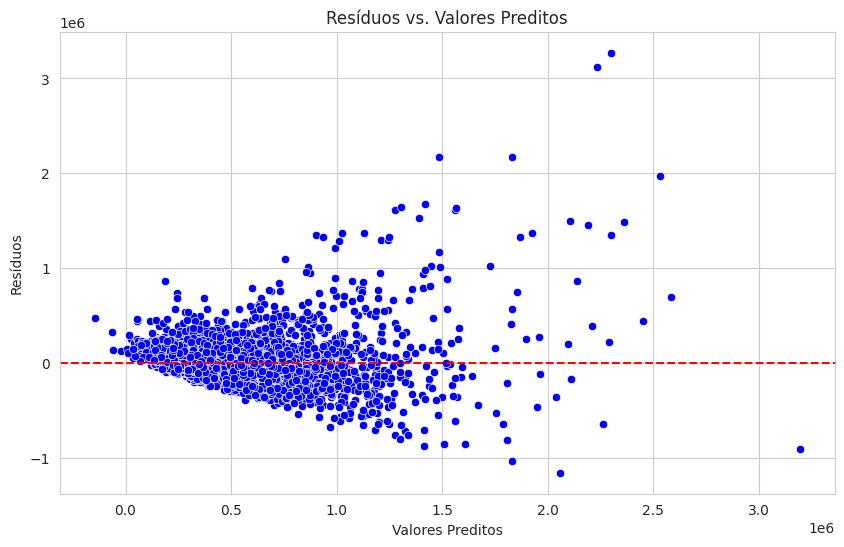

In [71]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x=y_pred_test, y=residuals, color="blue")
plt.axhline(0, linestyle="--", color="red")
plt.title("Resíduos vs. Valores Preditos")
plt.xlabel("Valores Preditos")
plt.ylabel("Resíduos")
plt.show()

Os resíduos não estão uniformemente distribuídos ao longo da linha central (linha vermelha em zero). Existe um padrão de aumento na variância dos resíduos para valores preditos maiores, sugerindo que o modelo apresenta heterocedasticidade, ou seja, a variabilidade dos resíduos não é constante, fere pressupostos de uma regressão linear. Além de pontos distantes do centro, especialmente em valores preditos altos, indicam potenciais outliers ou casos que o modelo não conseguiu ajustar bem.

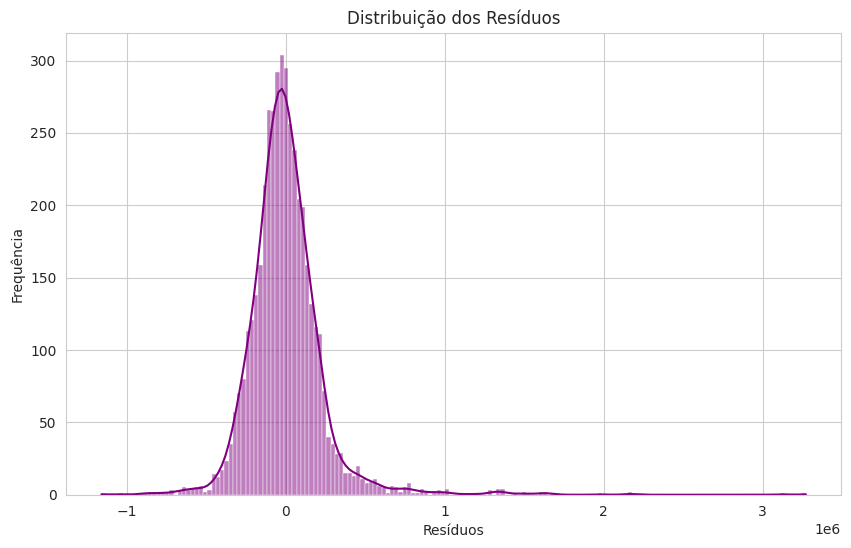

In [72]:
plt.figure(figsize=(10, 6))
sns.histplot(residuals, kde=True, color="purple")
plt.title("Distribuição dos Resíduos")
plt.xlabel("Resíduos")
plt.ylabel("Frequência")
plt.show()

O histograma indica que os resíduos estão concentrados em torno de zero, com uma leve assimetria. Embora o pico seja bem definido, as caudas mais alongadas sugerem que os resíduos não seguem uma distribuição perfeitamente normal. A curva roxa de densidade destaca a presença de uma cauda direita levemente mais longa, indicando que alguns resíduos positivos são maiores do que o esperado. Podemos inferir que a distribuição dos resíduos não é perfeitamente normal e pode influenciar a validade de inferências estatísticas, como os intervalos de confiança e testes de hipóteses.

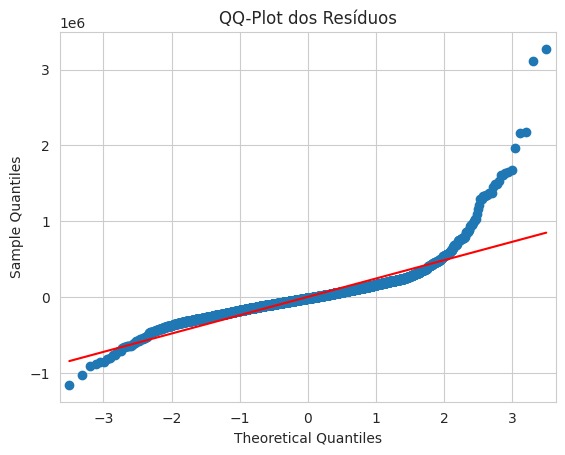

In [73]:
sm.qqplot(residuals, line="s")
plt.title("QQ-Plot dos Resíduos")
plt.show()

Em um modelo ideal com resíduos normais, os pontos devem estar alinhados com a linha vermelha. Nos quantis centrais (em torno de zero), os resíduos seguem razoavelmente a linha de referência, indicando uma aproximação da normalidade para a maior parte dos dados. Muito embora, nos extremos, há desvios significativos da linha, com resíduos nas caudas (tanto inferiores quanto superiores) afastando-se da normalidade. Isso sugere a presença de outliers ou resíduos que não seguem bem a distribuição normal.

In [74]:
print("Média dos resíduos:", np.mean(residuals))
print("Desvio padrão dos resíduos:", np.std(residuals))

Média dos resíduos: 2608.9596338330316
Desvio padrão dos resíduos: 241782.9662158963


In [75]:
print("O MSE do modelo é:", train_rmse)
print("O MAE do modelo é:", train_mae)
print("O R² do modelo é:", train_r2)

O MSE do modelo é: 228523.7241964183
O MAE do modelo é: 389.2203128991908
O R² do modelo é: 0.6002782500272685


## 6. Conclusões

O modelo de regressão linear apresentou um R² de 0,6, indicando que 60% da variabilidade do preço de venda das propriedades `price` pode ser explicada pelas variáveis explicativas selecionadas. Este resultado, é claro que possui uma capacidade preditiva muito baixa, ainda mais quando os pressupostos fundamentais da regressão linear são violados.

Durante a etapa de análise exploratória de dados (EDA), identificamos indícios de fragilidade nos dados, como distribuições assimétricas, outliers e possível multicolinearidade entre as variáveis. Essas características foram confirmadas durante a avaliação dos resíduos e dos pressupostos do modelo. Algumas relações parecem não ser totalmente lineares, apresentando coeficientes negativos inesperados. 
Isso indica que pode haver efeitos não capturados, como interações entre variáveis ou relações exponenciais. Os gráficos residuais indicaram a presença de padrões não aleatórios, heterocedasticidade e desvios significativos da normalidade, comprometendo a validade inferencial do modelo. Além disso, o cálculo do VIF revelou multicolinearidade em algumas variáveis, o que pode influenciar negativamente as estimativas dos coeficientes.

Com base no framework CRISP-DM, é evidente que o modelo deve retornar à fase de preparação e pré-processamento dos dados. Nesta etapa, será essencial adotar estratégias como: (i) aplicar trasnformação logaritmo na variavel target, (ii) realizar combinação de variáveis ja existentes para minimizar os coeficientes negativos inesperados, (iii) criar novos atributos com base na idade dos imóveis, (iv) possibilidade de indicar imóveis com valor histórico, (v) mapear proximidade de áreas verdes e parques, (vi) agrupar variveis multiclass com mais coesão (`grade` e `condition`) e ainda (vii) proximidade de infraestrutura urbana.

O modelo sendo reavaliado para garantir que atenda tanto aos pressupostos estatísticos quanto às métricas preditivas esperadas dará ao modelo confiança e interpretabilidade, sendo útil para a precificação de imóveis com caracteristicas similares, além de possibilitar mapear comportamentos de valorização no início desse movimento, colocando em vantagem estratégica o utilizador desse modelo.

# Questão 2

## 1. Compreensão do Problema de Negócio

No setor hoteleiro, compreender os fatores que levam ao cancelamento de reservas é essencial para otimizar a gestão de ocupação e maximizar a receita. Cancelamentos inesperados podem resultar em quartos vagos, impactando negativamente a rentabilidade dos hotéis. A aplicação de modelos preditivos permite antecipar o comportamento dos clientes, possibilitando a implementação de estratégias proativas para mitigar os efeitos dos cancelamentos.

Neste estudo, focaremos na previsão de cancelamentos de reservas utilizando o conjunto de dados Hotel Booking Demand, disponível no [Kaggle](https://www.kaggle.com/datasets/jessemostipak/hotel-booking-demand/data). Este dataset compreende informações sobre reservas em dois tipos de hotéis: um hotel urbano e um resort.

Para prever a probabilidade de cancelamento de uma reserva, utilizaremos a Regressão Logística, uma técnica estatística adequada para modelar desfechos binários, como cancelado ou não cancelado. Além disso, aplicaremos a metodologia CRISP-DM (Cross-Industry Standard Process for Data Mining) para estruturar nossa análise, garantindo uma abordagem sistemática e eficaz.

Este estudo visa não apenas construir um modelo preditivo, mas também identificar e interpretar as variáveis que mais influenciam o cancelamento de reservas. Compreender esses fatores permitirá aos gestores hoteleiros desenvolver estratégias direcionadas para reduzir os cancelamentos e melhorar a eficiência operacional.

### **1.1 Dicionário de Dados**


#### Informações sobre os atributos:
| Nome da Coluna                      | Descrição                                                                                                                                                                                                                 |
|-------------------------------------|---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------|
| hotel                               | Tipo de hotel (Resort Hotel ou City Hotel)                                                                                                                                                                                |
| is_canceled    **variável target**                     | Indica se a reserva foi cancelada (1) ou não (0)                                                                                                                                                                           |
| lead_time                           | Número de dias entre a data de inserção da reserva no sistema e a data de chegada                                                                                                                                        |
| arrival_date_year                   | Ano da data de chegada                                                                                                                                                                                                    |
| arrival_date_month                  | Mês da data de chegada                                                                                                                                                                                                    |
| arrival_date_week_number            | Número da semana do ano referente à data de chegada                                                                                                                                                                       |
| arrival_date_day_of_month           | Dia do mês da data de chegada                                                                                                                                                                                             |
| stays_in_weekend_nights             | Número de noites de fim de semana (sábado ou domingo) que o hóspede permaneceu ou reservou para permanecer no hotel                                                                                                       |
| stays_in_week_nights                | Número de noites de semana (segunda a sexta-feira) que o hóspede permaneceu ou reservou para permanecer no hotel                                                                                                          |
| adults                              | Número de adultos                                                                                                                                                                                                         |
| children                            | Número de crianças                                                                                                                                                                                                        |
| babies                              | Número de bebês                                                                                                                                                                                                           |
| meal                                | Tipo de refeição reservada. Categorias: BB (Bed & Breakfast), HB (Half board - café da manhã e uma outra refeição), FB (Full board - café da manhã, almoço e jantar), SC (Self Catering - sem pacote de refeições)        |
| country                             | País de origem, representado no formato ISO 3155–3:2013                                                                                                                                                                   |
| market_segment                      | Segmento de mercado da reserva. Por exemplo, TA (Travel Agents) ou TO (Tour Operators)                                                                                                                                    |
| distribution_channel                | Canal de distribuição da reserva. Por exemplo, TA (Travel Agents) ou TO (Tour Operators)                                                                                                                                  |
| is_repeated_guest                   | Indica se o hóspede é repetido (1) ou não (0)                                                                                                                                                                             |
| previous_cancellations              | Número de reservas anteriores que foram canceladas pelo cliente antes da reserva atual                                                                                                                                    |
| previous_bookings_not_canceled      | Número de reservas anteriores não canceladas pelo cliente antes da reserva atual                                                                                                                                          |
| reserved_room_type                  | Código do tipo de quarto reservado                                                                                                                                                                                        |
| assigned_room_type                  | Código do tipo de quarto atribuído à reserva                                                                                                                                                                              |
| booking_changes                     | Número de alterações feitas na reserva desde a inserção no sistema até o momento do check-in ou cancelamento                                                                                                              |
| deposit_type                        | Indicação se o cliente fez um depósito para garantir a reserva. Categorias: No Deposit (nenhum depósito), Non Refund (depósito no valor total da estadia), Refundable (depósito com valor inferior ao custo total da estadia) |
| agent                               | ID da agência de viagens que fez a reserva                                                                                                                                                                                |
| company                             | ID da empresa responsável pela reserva ou pagamento                                                                                                                                                                       |
| days_in_waiting_list                | Número de dias que a reserva ficou na lista de espera antes de ser confirmada para o cliente                                                                                                                              |
| customer_type                       | Tipo de cliente: Contract (contrato), Group (grupo), Transient (transitório), Transient-party (transitório com outros)                                                                                                    |
| adr                                 | Taxa Média Diária, calculada dividindo a soma de todas as transações de hospedagem pelo número total de noites de estadia                                                                                                |
| required_car_parking_spaces         | Número de vagas de estacionamento requeridas pelo cliente                                                                                                                                                                 |
| total_of_special_requests           | Número de pedidos especiais feitos pelo cliente (por exemplo, cama de solteiro ou andar alto)                                                                                                                             |
| reservation_status                  | Status final da reserva: Canceled (cancelada), Check-Out (cliente fez check-in e já saiu), No-Show (cliente não fez check-in e não informou o motivo)                                                                     |
| reservation_status_date             | Data em que o último status foi definido                                                                                                                                                                                  |



## 2. Coleta de Dados

Para este projeto de *machine learning*, utilizaremos o conjunto de dados **Hotel Booking Demand**, disponível no [Kaggle](https://www.kaggle.com/datasets/jessemostipak/hotel-booking-demand/data).

Este dataset abrange informações detalhadas sobre reservas em dois tipos de hotéis: **City Hotel** e **Resort Hotel**. As variáveis presentes podem ser classificadas nas seguintes categorias:

- **Informações sobre a reserva**:
  - `is_canceled`: Indica se a reserva foi cancelada ou não.
  - `lead_time`: Número de dias entre a data da reserva e a data de chegada.
  - `arrival_date_year`, `arrival_date_month`, `arrival_date_week_number`, `arrival_date_day_of_month`: Detalhes sobre a data de chegada.
  - `stays_in_weekend_nights`, `stays_in_week_nights`: Número de noites de estadia durante fins de semana e dias da semana.

- **Informações sobre os hóspedes**:
  - `adults`, `children`, `babies`: Número de adultos, crianças e bebês na reserva.
  - `country`: País de origem do hóspede.
  - `is_repeated_guest`: Indica se o hóspede é recorrente.

- **Informações sobre a estadia**:
  - `reserved_room_type`, `assigned_room_type`: Tipo de quarto reservado e tipo de quarto atribuído.
  - `booking_changes`: Número de alterações feitas na reserva.
  - `deposit_type`: Tipo de depósito associado à reserva.
  - `agent`, `company`: IDs da agência de viagens e da empresa associada à reserva.
  - `days_in_waiting_list`: Número de dias que a reserva ficou na lista de espera.
  - `customer_type`: Tipo de cliente (e.g., contrato, grupo, transiente).

- **Informações financeiras**:
  - `adr`: Taxa média diária aplicada à reserva.
  - `required_car_parking_spaces`: Número de vagas de estacionamento requeridas.
  - `total_of_special_requests`: Número de pedidos especiais feitos pelo hóspede.

Essas informações nos permitirão identificar padrões e fatores que influenciam o cancelamento de reservas, auxiliando na construção de um modelo preditivo eficaz.



**Dicas:**  
1. Observar as extensão do arquivo dataSet.
2. Verificar os acessos aos dataSet (LGPD).
3. "Timeframe" dos dados (desde quando tem-se os dados).
4. Valores Missing (será substituido por default ou outro valor - média, por exemplo).
5. Cabeçalho (header=T), caso False, irá indicar cabeçalho.
6. Dados possuem algum comentário.
7. Possui delimitador os dados.

### **2.1 Carga dados**

**Dicas:**  

(i) Observar as extensão do arquivo dataSet;

(ii) Verificar os acessos aos dataSet;

(iii) "Timeframe" dos dados (desde quando tem-se os dados);

(iv) Valores Missing (será substituido por default ou outro valor - média, por exemplo);

(v) Cabeçalho (header=T), caso False, irá indicar cabeçalho;

(vi) Dados possuem algum comentário;

(vii) Possui delimitador os dados;

(viii) Até 3 dimensões PANDAS (1Series, 2DataFrame e 3Panel). Acima 3 dim NUMPY (nparray).

In [2]:
path = "/home/buso/mestrado/aedi-ppca/dados/hotel_bookings.csv"
df = pd.read_csv(path)
print('Os dados possuem {} linhas e {} colunas'.format(df.shape[0], df.shape[1]))
df.head()

Os dados possuem 119390 linhas e 32 colunas


,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,...,No Deposit,NaN,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,...,No Deposit,304.0,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,No Deposit,240.0,NaN,0,Transient,98.0,0,1,Check-Out,2015-07-03


## 3. Análise Exploratória

### 3.1 Visão Geral dataSet
Nesta estapa estamos interessados em entender melhor a pergunta ***"Quais tipos de dados tem no nosso dataSet?"***
* Tipo Objeto que estamos trabalhando
* Tipos Dados
* Shape - Dimensionalidade
* Índices
* Descrição dos dados

In [3]:
def visaogeral(df, mensagem):
    print(f'{mensagem}:\n')
    print("Qtd Observações:", df.shape[0])
    print("\nQtd Atributos:", df.shape[1])
    print("\nAtributos:")
    print(df.columns.values)
    # print(df.columns.tolist())
    print("\nQtd Valores missing:", df.isnull().sum().values.sum())
    print("\nValores Unicos:")
    print(df.nunique().sort_values(ascending=True))

In [4]:
visaogeral(df,'Visão Geral do dataSet')

Visão Geral do dataSet:

Qtd Observações: 119390

Qtd Atributos: 32

Atributos:
['hotel' 'is_canceled' 'lead_time' 'arrival_date_year'
 'arrival_date_month' 'arrival_date_week_number'
 'arrival_date_day_of_month' 'stays_in_weekend_nights'
 'stays_in_week_nights' 'adults' 'children' 'babies' 'meal' 'country'
 'market_segment' 'distribution_channel' 'is_repeated_guest'
 'previous_cancellations' 'previous_bookings_not_canceled'
 'reserved_room_type' 'assigned_room_type' 'booking_changes'
 'deposit_type' 'agent' 'company' 'days_in_waiting_list' 'customer_type'
 'adr' 'required_car_parking_spaces' 'total_of_special_requests'
 'reservation_status' 'reservation_status_date']

Qtd Valores missing: 129425

Valores Unicos:
hotel                                2
is_canceled                          2
is_repeated_guest                    2
arrival_date_year                    3
deposit_type                         3
reservation_status                   3
customer_type                        4
requ

O conjunto de dados possui aproximadamente cerca de **120 mil observações** e **32 atributos**, podemos observar a presença de valores ausentes (*missing*). Os atributos incluem característica e informações sobre a reserva, os hóspedes, a estadia escolhida e valores pagos nas estadias. Abaixo, destacamos os atributos categóricos e quantitativos:

- **Atributos categóricos**: a princípio as features elencadas abaixo podem representar categorias:
  - `hotel`, `is_canceled`, `is_repeated_guest`, `deposit_type`, `reservation_status`, `customer_type`, `required_car_parking_spaces`, `meal`,  `distribution_channel`, `total_of_special_requests`, `market_segment`, `reserved_room_type`, `assigned_room_type`, `country`.

- **Atributos quantitativos**: as demais, *a priori* demonstra ser *features* numéricas e contínuas, sendo que após o processo de exploração dos dados (EDA) seja interessante realizar algumas trasformaões em categórias nelas.

Nosso objetivo é realmente entender se esses formatos representam a **informação** que a *feature* precisa passar!

Essa combinação de atributos categóricos e quantitativos é fundamental para capturar os diferentes fatores que influenciam a probabilidade de cancelamento dos hóspedes.


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 32 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119390 non-null  object 
 1   is_canceled                     119390 non-null  int64  
 2   lead_time                       119390 non-null  int64  
 3   arrival_date_year               119390 non-null  int64  
 4   arrival_date_month              119390 non-null  object 
 5   arrival_date_week_number        119390 non-null  int64  
 6   arrival_date_day_of_month       119390 non-null  int64  
 7   stays_in_weekend_nights         119390 non-null  int64  
 8   stays_in_week_nights            119390 non-null  int64  
 9   adults                          119390 non-null  int64  
 10  children                        119386 non-null  float64
 11  babies                          119390 non-null  int64  
 12  meal            

A análise exploratória realizada proporcionou uma **compreensão inicial** sobre a estrutura e qualidade do conjunto de dados. O dataset contém aproximadamente **120 mil registros** de reservas em hotéis, detalhando informações sobre os clientes e se as reservas foram canceladas ou não.

A inspeção das variáveis revelou a presença de **atributos categóricos**, exigindo a aplicação de técnicas de **codificação de variáveis**, como **One-Hot Encoding**, para possibilitar sua utilização em modelos de *Machine Learning* baseados em algoritmos que requerem representações numéricas.

Outro ponto relevante é a identificação de **valores ausentes** em algumas variáveis, o que demanda um tratamento adequado. Além disso, durante o processo de **engenharia de atributos** (*feature engineering*) e **transformação de variáveis**, podem surgir valores nulos em decorrência de operações como discretização, normalização ou derivação de novas variáveis. Assim, será essencial **monitorar, imputar e tratar** esses valores para garantir a **qualidade e integridade dos dados**, assegurando que o modelo preditivo alcance um desempenho confiável.


**TRADE-OFFs da Ciência de Dados e o Dilema Viés-Variância**

No desenvolvimento de modelos de *Machine Learning*, é fundamental equilibrar **quantidade de dados**, **dimensionalidade** e **tempo de treinamento**, garantindo um modelo eficiente e generalizável. Esse processo envolve decisões estratégicas para evitar problemas como **underfitting** e **overfitting**, além de considerar o **dilema viés-variância**.

**Tamanho do Conjunto de Dados**

Se o número de **observações** no conjunto de dados for **muito grande**, o treinamento pode ser **computacionalmente custoso**, exigindo técnicas como **amostragem representativa**, **processamento distribuído** (ex.: Spark, Dask) ou **redução de dimensionalidade** (ex.: PCA). Por outro lado, um número **muito pequeno** de registros pode levar ao **underfitting**, onde o modelo não consegue capturar padrões relevantes e apresenta baixa capacidade preditiva.

**Dimensionalidade e Seleção de Features**

Muitas **colunas/atributos** podem gerar problemas de **alta dimensionalidade**, dificultando a modelagem e aumentando o risco de **overfitting**, quando o modelo se ajusta excessivamente aos dados de treino e perde **capacidade de generalização**. Para mitigar esse problema, técnicas como **seleção de variáveis** (ex.: *feature selection*) e **redução de dimensionalidade** (ex.: PCA, *Autoencoders*) são recomendadas.

**O Dilema Viés-Variância**

O dilema **viés-variância** descreve o equilíbrio entre **simplicidade** e **complexidade** do modelo:

- **Viés alto (underfitting)**: O modelo é muito simples e não captura os padrões dos dados adequadamente, erra muito ou tudo.
- **Variância alta (overfitting)**: O modelo é muito complexo e se ajusta excessivamente aos dados de treino, resultando em baixa generalização.

A solução ideal envolve encontrar um meio-termo, onde o modelo **aprende bem os padrões dos dados sem se tornar excessivamente específico**.

**Divisão de Dados e Validação**

A prática recomendada é dividir o conjunto de dados em:
- **Treino (70%)**: Para ensinar o modelo.
- **Teste (30%)**: Para avaliar a performance em dados novos.
- **Validação cruzada**: Para evitar dependência de uma única divisão dos dados e garantir que o modelo tenha **boa generalização**.

**E então?**

Não existe uma solução única para esses desafios, e cada problema exige um equilíbrio entre **quantidade de dados**, **dimensionalidade**, **tempo de treinamento** e **capacidade de generalização**. Estratégias como **seleção de variáveis, validação cruzada e ajuste de hiperparâmetros** são essenciais para otimizar o modelo e garantir **desempenho robusto e confiável**.


Observando uma amostra inicial e uma amostra final do dataSet.

In [6]:
df.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,...,No Deposit,NaN,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,...,No Deposit,304.0,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,No Deposit,240.0,NaN,0,Transient,98.0,0,1,Check-Out,2015-07-03


In [7]:
df.tail()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
119385,City Hotel,0,23,2017,August,35,30,2,5,2,...,No Deposit,394.0,NaN,0,Transient,96.14,0,0,Check-Out,2017-09-06
119386,City Hotel,0,102,2017,August,35,31,2,5,3,...,No Deposit,9.0,NaN,0,Transient,225.43,0,2,Check-Out,2017-09-07
119387,City Hotel,0,34,2017,August,35,31,2,5,2,...,No Deposit,9.0,NaN,0,Transient,157.71,0,4,Check-Out,2017-09-07
119388,City Hotel,0,109,2017,August,35,31,2,5,2,...,No Deposit,89.0,NaN,0,Transient,104.40,0,0,Check-Out,2017-09-07
119389,City Hotel,0,205,2017,August,35,29,2,7,2,...,No Deposit,9.0,NaN,0,Transient,151.20,0,2,Check-Out,2017-09-07


Relembrando o shape dos dados:

In [8]:
print('Os dados possuem {:.2f} linhas e {} colunas'.format(df.shape[0], df.shape[1]))

Os dados possuem 119390.00 linhas e 32 colunas


In [9]:
# checando índice (endereço de cada obs) e sua distribuição
df.index

RangeIndex(start=0, stop=119390, step=1)

In [10]:
# checando os nomes das colunas
df.columns

Index(['hotel', 'is_canceled', 'lead_time', 'arrival_date_year',
       'arrival_date_month', 'arrival_date_week_number',
       'arrival_date_day_of_month', 'stays_in_weekend_nights',
       'stays_in_week_nights', 'adults', 'children', 'babies', 'meal',
       'country', 'market_segment', 'distribution_channel',
       'is_repeated_guest', 'previous_cancellations',
       'previous_bookings_not_canceled', 'reserved_room_type',
       'assigned_room_type', 'booking_changes', 'deposit_type', 'agent',
       'company', 'days_in_waiting_list', 'customer_type', 'adr',
       'required_car_parking_spaces', 'total_of_special_requests',
       'reservation_status', 'reservation_status_date'],
      dtype='object')

#### 3.1.1 Variáveis Explicatórias e Variável Alvo

Para a construção do modelo preditivo, é fundamental separar as variáveis do conjunto de dados em dois grupos distintos:

- **Variável Alvo (`y`)**: Representa o resultado que desejamos prever. No contexto deste estudo, a variável alvo é a **`is_canceled`**, que indica se a reserva foi cancelada (**1**) ou não (**0**). Essa variável será utilizada para treinar o modelo e avaliar sua capacidade de prever o cancelamento de uma estadia.

- **Variáveis Explicatórias (`X`)**: São as demais variáveis que contêm informações relevantes sobre o comportamento e perfil dos clientes. Elas serão utilizadas como **fatores preditivos** para estimar a probabilidade do cancelamento. Antes do treinamento podemos excluir variáveis que não apresentarem valor preditivo.

A separação correta entre **`X`** e **`y`** é essencial para garantir que o modelo aprenda a partir de variáveis relevantes e seja capaz de realizar previsões precisas sobre a saída ou permanência dos clientes.

In [11]:
df.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,...,No Deposit,NaN,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,...,No Deposit,304.0,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,No Deposit,240.0,NaN,0,Transient,98.0,0,1,Check-Out,2015-07-03


In [12]:
X = df.drop(columns= 'is_canceled', axis= 1)
y = df['is_canceled']	

In [13]:
y.shape

(119390,)

In [14]:
print('DataSet original com {} atributos e {} observações'.format(df.shape[1], df.shape[0]))
print('As Variáveis Explicatórias possuem {} atributos e {} observações'.format(X.shape[1], X.shape[0]))
print('A Variável Alvo possuem {} observações'.format(y.shape))

DataSet original com 32 atributos e 119390 observações
As Variáveis Explicatórias possuem 31 atributos e 119390 observações
A Variável Alvo possuem (119390,) observações


#### 3.1.2 Variável Alvo

A **variável alvo** deste estudo é o atributo **`is_canceled`**, que indica se o cliente cancelou ou não sua reserva no hotel. Essa variável é categórica binária e representa o resultado que o modelo de machine learning deve prever. Seus valores são definidos da seguinte forma:

- **0** → O cliente **não** cancelou, ou seja, compareceu para se hospedar.
- **1** → O cliente **cancelou** a reserva.

#####  3.1.2.1  Amplitude

In [15]:
y.describe()

count    119390.000000
mean          0.370416
std           0.482918
min           0.000000
25%           0.000000
50%           0.000000
75%           1.000000
max           1.000000
Name: is_canceled, dtype: float64

In [16]:
y.unique()

array([0, 1])

Observando os valores únicos da variável **`is_canceled`**, confirmamos que se trata de uma **variável categórica binária**, com duas categorias distintas:

- **0** → Não houve **cancelamento**, o cliente **compareceu** para se hospedar.  
- **1** → Houve **cancelamento**, o cliente **cancelou** e não compareceu para se hospedar.

Dessa forma, estamos diante de um problema de **aprendizado supervisionado** do tipo **classificação**, no qual o objetivo é prever a probabilidade de um cliente deixar ou não a instituição financeira.

Para essa tarefa, utilizaremos um **modelo classificador**, que será treinado para identificar padrões de comportamento associados nosso problema.

##### 3.1.2.2 Balanceamento dos Dados

Em problemas de **classificação**, é frequente encontrar conjuntos de dados com **classes desbalanceadas**, onde uma das classes apresenta um número de registros significativamente maior do que a outra. Esse desequilíbrio pode comprometer o desempenho do modelo, tornando-o **tendencioso** para a classe majoritária e dificultando a correta identificação da classe minoritária.

O **balanceamento das classes** é um dos **pressupostos fundamentais** a serem considerados na construção de modelos de **machine learning**. Caso não seja tratado adequadamente, o modelo pode apresentar baixa capacidade de prever eventos menos frequentes. Por isso, é essencial adotar estratégias para equilibrar as classes durante o pré-processamento, garantindo previsões mais precisas e confiáveis.

In [17]:
print(y.value_counts())
print("\nObserva-se que {:.4f}% do dataSet cancelaram a reserva.".format((df.groupby('is_canceled').size()[1] / df.shape[0])*100))
print("Enquanto que {:.4f}% dos dados não cancelaram suas reservas.".format((df.groupby('is_canceled').size()[0] / df.shape[0])*100))

is_canceled
0    75166
1    44224
Name: count, dtype: int64

Observa-se que 37.0416% do dataSet cancelaram a reserva.
Enquanto que 62.9584% dos dados não cancelaram suas reservas.


No contexto deste estudo, a variável `is_canceled` apresenta um leve desbalanceamento, mas não em um nível que exija, de imediato, a aplicação de técnicas de balanceamento. O impacto desse desbalanceamento na performance do modelo será avaliado antes de qualquer intervenção.

As principais técnicas de balanceamento de classes incluem:

- **Oversampling** (Superamostragem): Aumenta a quantidade de registros da classe minoritária, seja por duplicação de dados existentes ou pela geração de novas amostras sintéticas. Um exemplo comum é o SMOTE (Synthetic Minority Over-sampling Technique), que cria novas instâncias baseadas na interpolação dos dados minoritários.

- **Undersampling** (Subamostragem): Reduz a quantidade de registros da classe majoritária, eliminando amostras redundantes para equilibrar a distribuição entre as classes. Essa técnica pode ser útil para acelerar o treinamento, mas pode levar à perda de informações relevantes.

A decisão sobre a aplicação dessas técnicas deve ser baseada em evidências experimentais. Se o modelo demonstrar um viés excessivo para a classe majoritária, prejudicando a capacidade de prever corretamente os cancelamentos, estratégias de balanceamento serão consideradas para mitigar esse efeito.

#####  3.1.2.3  Plots Variável Alvo

In [18]:
# seto algumas caracteristicas para os plots. Padornizar Plots
sns.set_theme(style='darkgrid')
sns.set_palette("hls", 3)

In [19]:
balData = pd.DataFrame(df['is_canceled'].value_counts())
balData['% total'] = round(100*balData['count']/df.shape[0], 2)

             count  % total
is_canceled                
0            75166    62.96
1            44224    37.04


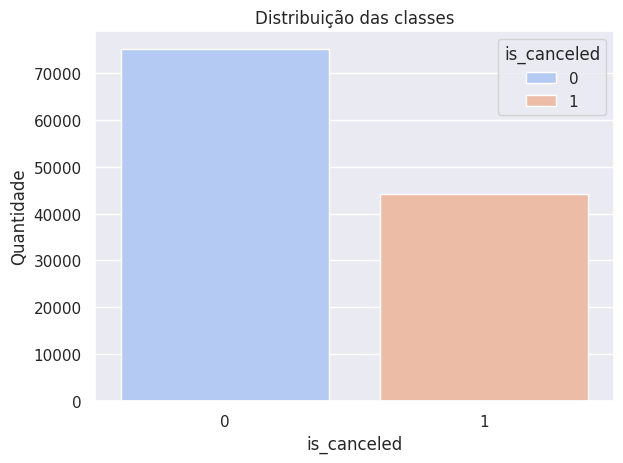

In [20]:
print(balData)
churn_plot = sns.countplot(data=df, x='is_canceled', order=df.is_canceled.value_counts().index, hue= 'is_canceled', palette='coolwarm')

plt.title('Distribuição das classes')
plt.ylabel('Quantidade')

plt.tight_layout()
plt.show()

#### 3.1.3 Preditores Categóricos

Durante a análise exploratória, identificamos que o conjunto de dados contém variáveis **categóricas** que são aquelas que representam **categorias** seja elas nominais ou ordinais. Elas auxiliam para mapear o entender o evento que estamos analisando.

In [21]:
x_categoricos =  df.select_dtypes(include=['object'])
x_categoricos['is_canceled'] = df['is_canceled']
x_categoricos.head()

,hotel,arrival_date_month,meal,country,market_segment,distribution_channel,reserved_room_type,assigned_room_type,deposit_type,customer_type,reservation_status,reservation_status_date,is_canceled
0,Resort Hotel,July,BB,PRT,Direct,Direct,C,C,No Deposit,Transient,Check-Out,2015-07-01,0
1,Resort Hotel,July,BB,PRT,Direct,Direct,C,C,No Deposit,Transient,Check-Out,2015-07-01,0
2,Resort Hotel,July,BB,GBR,Direct,Direct,A,C,No Deposit,Transient,Check-Out,2015-07-02,0
3,Resort Hotel,July,BB,GBR,Corporate,Corporate,A,A,No Deposit,Transient,Check-Out,2015-07-02,0
4,Resort Hotel,July,BB,GBR,Online TA,TA/TO,A,A,No Deposit,Transient,Check-Out,2015-07-03,0


In [22]:
x_categoricos.columns 

Index(['hotel', 'arrival_date_month', 'meal', 'country', 'market_segment',
       'distribution_channel', 'reserved_room_type', 'assigned_room_type',
       'deposit_type', 'customer_type', 'reservation_status',
       'reservation_status_date', 'is_canceled'],
      dtype='object')

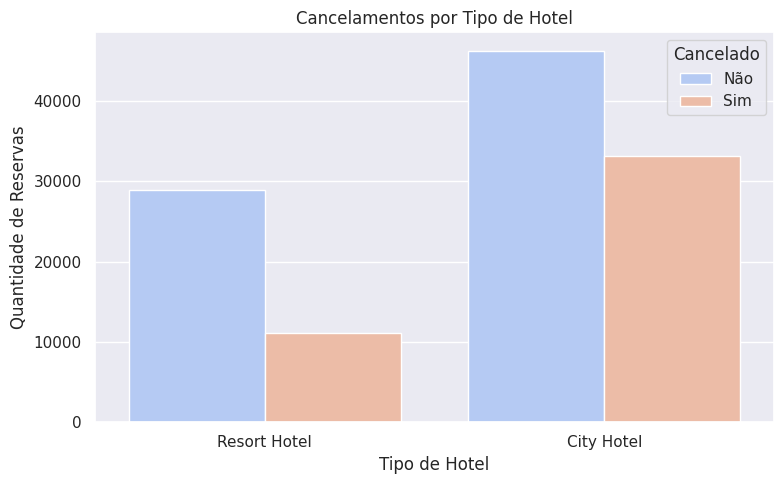

In [23]:
plt.figure(figsize=(8,5))
sns.countplot(data=df, x='hotel', hue='is_canceled', palette= 'coolwarm') 

plt.title("Cancelamentos por Tipo de Hotel")
plt.xlabel("Tipo de Hotel")
plt.ylabel("Quantidade de Reservas")
plt.legend(title="Cancelado", labels=["Não", "Sim"])

plt.tight_layout()
plt.show()

O número absoluto de cancelamentos no **City Hotel** é muito maior do que no **Resort Hotel**.

No **City Hotel**, a proporção entre reservas canceladas e concluídas está mais equilibrada, sugerindo que os hóspedes desse tipo de hotel têm maior propensão ao cancelamento.

O **Resort Hotel** apresenta uma proporção significativamente menor de cancelamentos em relação ao total de reservas.
Isso pode indicar diferenças no perfil dos clientes ou no tipo de estadia esperada para cada hotel.

No **City Hotel**, por exemplo, podem ocorrer mais cancelamentos devido a mudanças em viagens a trabalho ou estadias curtas, enquanto no Resort Hotel, as reservas são mais planejadas e menos propensas a cancelamento.

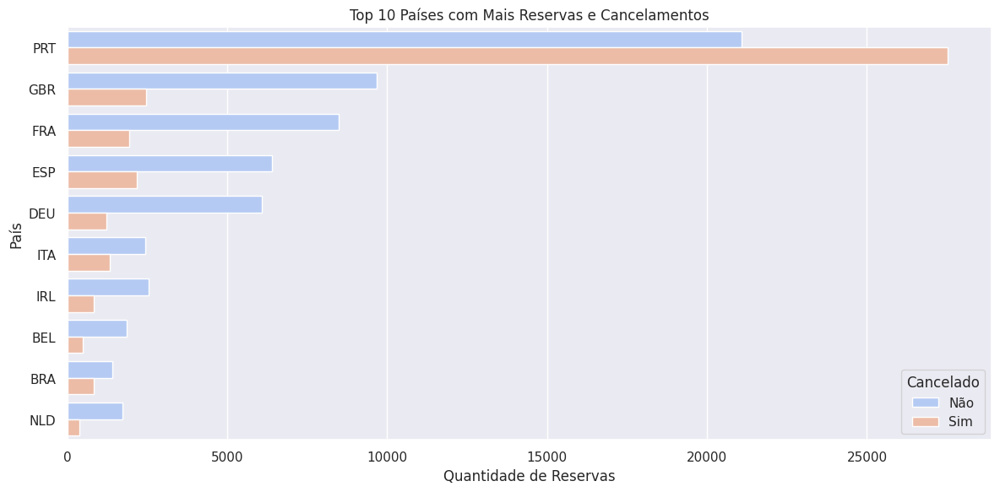

In [24]:
top_countries = df['country'].value_counts().nlargest(10).index
df_country = df[df['country'].isin(top_countries)]

plt.figure(figsize=(12,6))
sns.countplot(data=df_country, y='country', hue='is_canceled', palette='coolwarm', order=top_countries)

plt.title("Top 10 Países com Mais Reservas e Cancelamentos")
plt.xlabel("Quantidade de Reservas")
plt.ylabel("País")
plt.legend(title="Cancelado", labels=["Não", "Sim"])

plt.tight_layout()
plt.show()

O maior volume de reservas vem de **Portugal**, e o número de cancelamentos também é expressivo, indicando que turistas portugueses fazem muitas reservas, mas também cancelam em uma proporção elevada. Reino Unido (GBR) e França (FRA) seguem em volume de reservas, ambos os países têm um número significativo de reservas, mas a taxa de cancelamento parece menor em comparação com Portugal.

Em países como Alemanha (DEU), Espanha (ESP) e Itália (ITA), a proporção de cancelamentos em relação ao total de reservas parece ser mais baixa. Brasil (BRA) aparece entre os 10 principais, não é tão alto quanto os países europeus, mas ainda assim figura entre os mais relevantes.

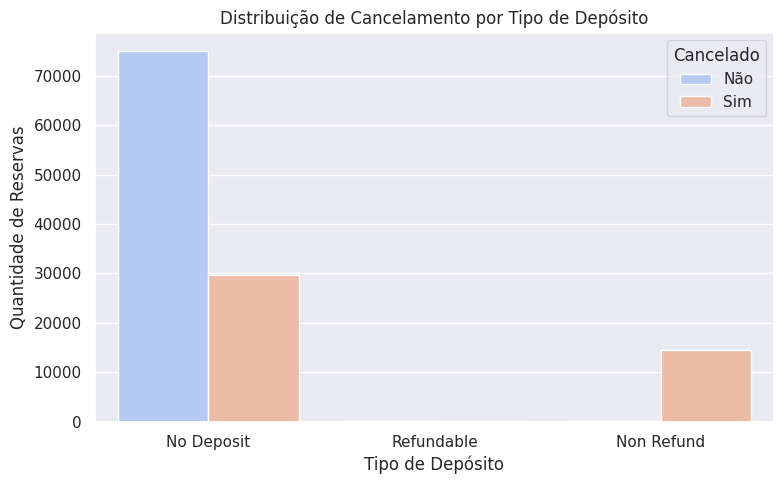

In [25]:
plt.figure(figsize=(8,5))
sns.countplot(data=df, x='deposit_type', hue='is_canceled', palette='coolwarm')

plt.title("Distribuição de Cancelamento por Tipo de Depósito")
plt.xlabel("Tipo de Depósito")
plt.ylabel("Quantidade de Reservas")
plt.legend(title="Cancelado", labels=["Não", "Sim"])

plt.tight_layout()
plt.show()

A maior parte das reservas é feita sem depósito antecipado, o que pode indicar uma maior flexibilidade para os clientes. No entanto, também é nesse grupo que ocorre o maior número absoluto de cancelamentos. As reservas que exigem pagamento antecipado e não são reembolsáveis ("Non Refund") apresentam uma menor quantidade total, mas um índice relativamente menor de cancelamentos, comparado com as reservas que não exige depósito.

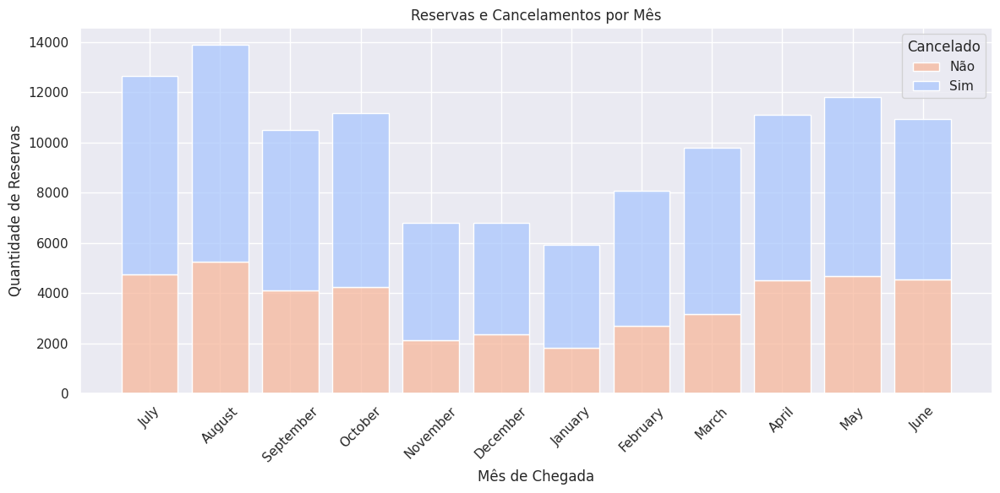

In [26]:
plt.figure(figsize=(12,6))
sns.histplot(data=df, x='arrival_date_month', hue='is_canceled', multiple='stack', palette='coolwarm', shrink=0.8)

plt.title("Reservas e Cancelamentos por Mês")
plt.xlabel("Mês de Chegada")
plt.ylabel("Quantidade de Reservas")
plt.xticks(rotation=45)
plt.legend(title="Cancelado", labels=["Não", "Sim"])

plt.tight_layout()
plt.show()

1. Alta sazonalidade nas reservas:

* Os meses com maior volume de reservas são Julho e Agosto, o que indica um pico no período de verão no Hemisfério Norte.
* Já os meses com menor volume de reservas são Janeiro e Dezembro, sugerindo uma queda na demanda durante o inverno, possivelmente por ser um período pós-feriado onde menos pessoas viajam.

2. Cancelamentos acompanham o volume de reservas:

* Observa-se que meses com mais reservas também possuem maior número absoluto de cancelamentos.
* Isso pode indicar que as condições sazonais impactam não apenas a demanda por reservas, mas também a probabilidade de cancelamento, podendo estar relacionado a eventos, clima ou feriados.

3. Taxa de cancelamento parece ser maior em alguns meses:

* Agosto, Julho e Outubro apresentam altas taxas de cancelamento, o que pode indicar que muitas dessas reservas são feitas antecipadamente e depois canceladas.
* Meses como Janeiro, Fevereiro e Novembro apresentam menos cancelamentos, o que pode sugerir que os clientes que viajam nessas épocas possuem maior intenção de manter suas reservas.

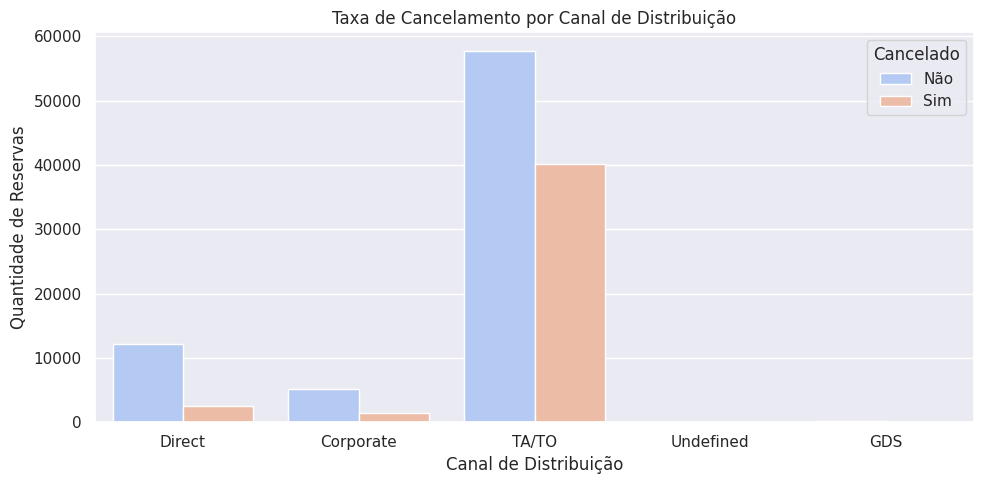

In [27]:
plt.figure(figsize=(10,5))
sns.countplot(data=df, x='distribution_channel', hue='is_canceled', palette='coolwarm')

plt.title("Taxa de Cancelamento por Canal de Distribuição")
plt.xlabel("Canal de Distribuição")
plt.ylabel("Quantidade de Reservas")
plt.legend(title="Cancelado", labels=["Não", "Sim"])

plt.tight_layout()
plt.show()

O canal "TA/TO" (Agências de Viagem e Operadoras de Turismo) tem a maior quantidade de reservas e cancelamentos, esse canal representa a maioria das reservas, mas também exibe um alto volume de cancelamentos. Pode indicar que reservas feitas por agências e operadoras são mais suscetíveis a alterações, cancelamentos ou mudanças por parte dos clientes.

Reservas feitas diretamente ("Direct") possuem um volume considerável de reservas com menor taxa de cancelamento, o número de cancelamentos é relativamente baixo, sugerindo que clientes que fazem reservas diretamente no hotel tendem a ser mais comprometidos.

#### 3.1.4 Preditores Numéricos

As **variáveis numéricas** desempenham um papel crucial na construção de modelos preditivos, pois capturam informações quantitativas que podem influenciar diretamente a probabilidade de cancelamento.

In [28]:
x_numericos = df.select_dtypes(include=['int64', 'float64'])

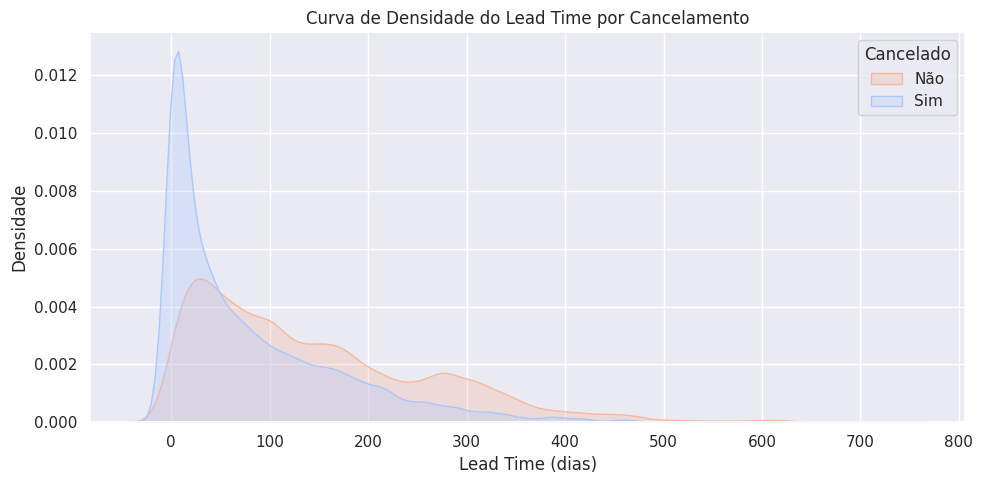

In [29]:
plt.figure(figsize=(10, 5))
sns.kdeplot(data=df, x="lead_time", hue="is_canceled", common_norm=False, fill=True, alpha=0.3, palette='coolwarm')

plt.xlabel("Lead Time (dias)")
plt.ylabel("Densidade")
plt.title("Curva de Densidade do Lead Time por Cancelamento")
plt.legend(title="Cancelado", labels=["Não", "Sim"])

plt.tight_layout()
plt.show()

Clientes que fazem reservas com muita antecedência têm uma maior probabilidade de cancelar.

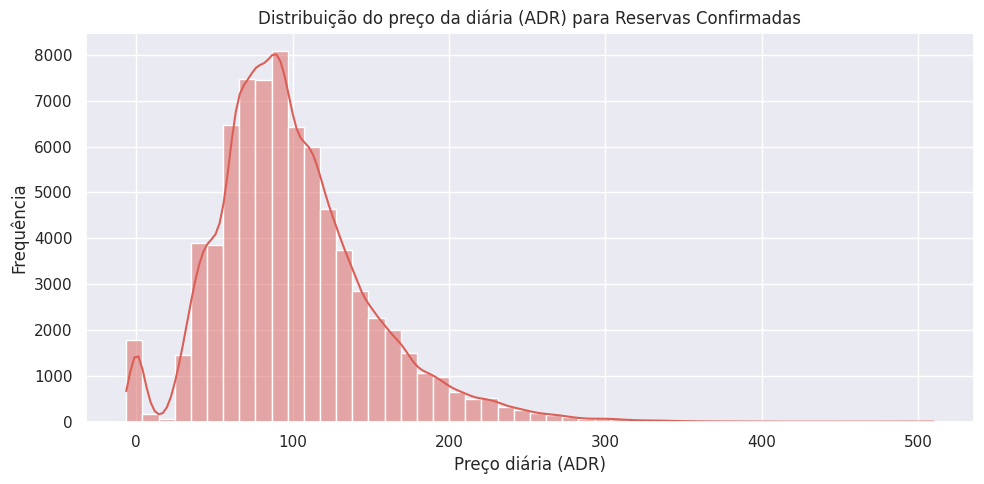

In [30]:
plt.figure(figsize=(10, 5))
sns.histplot(df[df["is_canceled"] == 0]["adr"], bins=50, kde=True, palette='coolwarm')

plt.xlabel("Preço diária (ADR)")
plt.ylabel("Frequência")
plt.title("Distribuição do preço da diária (ADR) para Reservas Confirmadas")

plt.tight_layout()
plt.show()

O preço da diária segue uma distribuição assimétrica, onde a maioria das reservas confirmadas se concentra em valores intermediários. A maioria das diárias está concentrada entre 50 e 150 unidades monetárias, com um pico por volta de 100.

Existem algumas diárias acima de 200, mas com menor frequência. Isso sugere que preços muito altos são raros e representam hotéis premium ou pacotes especiais.

Há uma pequena concentração de reservas com valores muito baixos (~0 a 20). Isso pode indicar erros na base de dados, reservas promocionais ou registros que precisam ser melhor investigados.

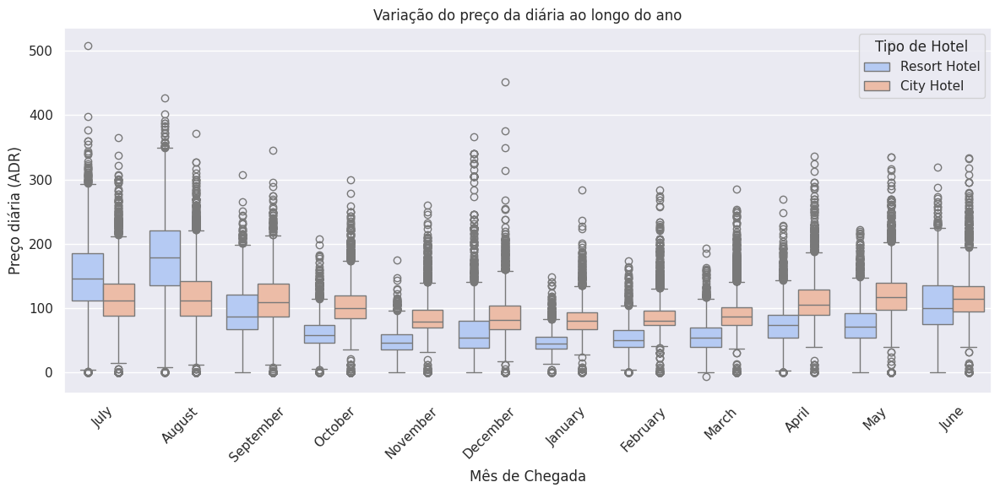

In [31]:
plt.figure(figsize=(12, 6))
sns.boxplot(data=df[df["is_canceled"] == 0], x="arrival_date_month", y="adr", hue="hotel", palette='coolwarm')

plt.xlabel("Mês de Chegada")
plt.ylabel("Preço diária (ADR)")
plt.title("Variação do preço da diária ao longo do ano")
plt.legend(title="Tipo de Hotel")
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()


1️⃣ Sazonalidade Clara: Os meses de junho, julho e agosto apresentam os maiores preços médios, indicando alta temporada. Já os meses de janeiro a março possuem preços mais baixos, sugerindo baixa demanda.

2️⃣ Diferença entre os Tipos de Hotéis: **City Hotel** possuem preços mais altos em geral, além de apresentar menor variação ao longo do ano.

3️⃣ Distribuição e Outliers: Há outliers frequentes, principalmente nos meses de alta temporada, indicando algumas diárias muito acima da média. A dispersão de preços é maior nos **Resort Hotels**, sugerindo uma gama de preços mais ampla, possivelmente devido a diferentes categorias de quartos e pacotes.

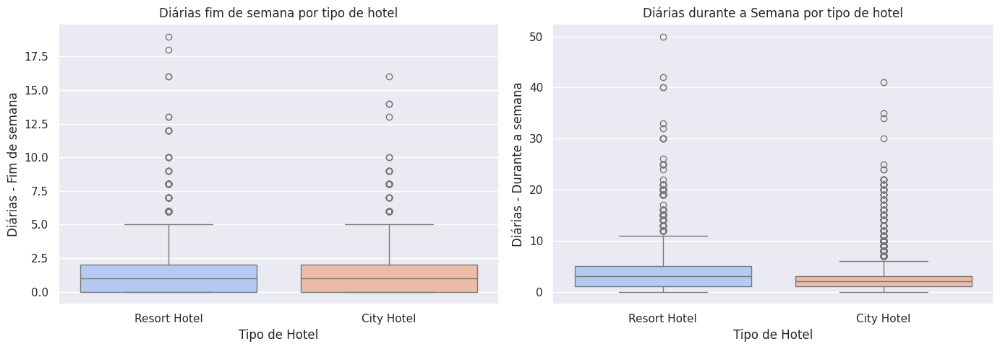

In [32]:
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

sns.boxplot(data=df, x="hotel", y="stays_in_weekend_nights", ax=axes[0], palette='coolwarm')
axes[0].set_title("Diárias fim de semana por tipo de hotel")
axes[0].set_xlabel("Tipo de Hotel")
axes[0].set_ylabel("Diárias - Fim de semana")

sns.boxplot(data=df, x="hotel", y="stays_in_week_nights", ax=axes[1], palette='coolwarm')
axes[1].set_title("Diárias durante a Semana por tipo de hotel")
axes[1].set_xlabel("Tipo de Hotel")
axes[1].set_ylabel("Diárias - Durante a semana")

plt.tight_layout()
plt.show()


O número de diárias durante a semana é maior do que nos fins de semana, indicando que muitas reservas são para estadias prolongadas.
Isso sugere que os hóspedes, especialmente em hotéis Resort, ficam mais tempo durante a semana.

Ambos os tipos de hotéis apresentam um comportamento similar, a maioria das reservas tem poucas diárias (1 a 3 noites). No entanto, há outliers significativos em ambos os gráficos, mostrando que alguns hóspedes ficam por períodos muito longos, principalmente em Resort Hotels.

No gráfico de dias da semana, há mais valores extremos, com estadias chegando a 50 noites, o que pode indicar clientes corporativos ou contratos de longo prazo. No gráfico de fins de semana, os outliers são menos frequentes, e a maior parte das estadias fica em torno de 1 a 2 noites.

##### 3.1.4.1 Distribuição dos Dados – Assimetria (*Skewness*) e Curtose (*Kurtosis*)

Nesta etapa, será analisada a **distribuição dos dados** de cada variável, com foco em duas medidas estatísticas importantes: **assimetria** (*skewness*) e **curtose** (*kurtosis*).

- **Assimetria (*Skewness*)**: Indica o grau de **simetria** da distribuição dos dados em relação à média.  
  - Uma distribuição **simétrica** tem skew próximo de **0**.  
  - Assimetria **positiva** (skew > 0) indica concentração de valores à **esquerda**, com cauda alongada à **direita**.  
  - Assimetria **negativa** (skew < 0) indica concentração à **direita**, com cauda alongada à **esquerda**.

- **Curtose (*Kurtosis*)**: Mede o grau de **achatamento** ou **picos** da distribuição em comparação com a distribuição normal.  
  - Curtose **próxima de 0** indica uma distribuição semelhante à **normal**.  
  - Curtose **positiva** indica uma distribuição com **picos acentuados** e caudas mais longas (**leptocúrtica**).  
  - Curtose **negativa** indica uma distribuição mais **achatada** (**platicúrtica**).

Muitos algoritmos de **Machine Learning** pressupõem que as variáveis possuem uma **distribuição normal (gaussiana)**. Avaliar a **assimetria** e a **curtose** permite aplicar técnicas de **pré-processamento** adequadas (como transformação logarítmica, normalização ou padronização) para ajustar a distribuição dos dados. Esse ajuste pode melhorar significativamente a **performance** e a **acurácia** do modelo preditivo.

In [33]:
x_numericos.skew()

is_canceled                        0.536678
lead_time                          1.346550
arrival_date_year                 -0.232583
arrival_date_week_number          -0.010014
arrival_date_day_of_month         -0.002000
stays_in_weekend_nights            1.380046
stays_in_week_nights               2.862249
adults                            18.317805
children                           4.112590
babies                            24.646545
is_repeated_guest                  5.326315
previous_cancellations            24.458049
previous_bookings_not_canceled    23.539800
booking_changes                    6.000270
agent                              1.089386
company                            0.601600
days_in_waiting_list              11.944353
adr                               10.530214
required_car_parking_spaces        4.163233
total_of_special_requests          1.349189
dtype: float64

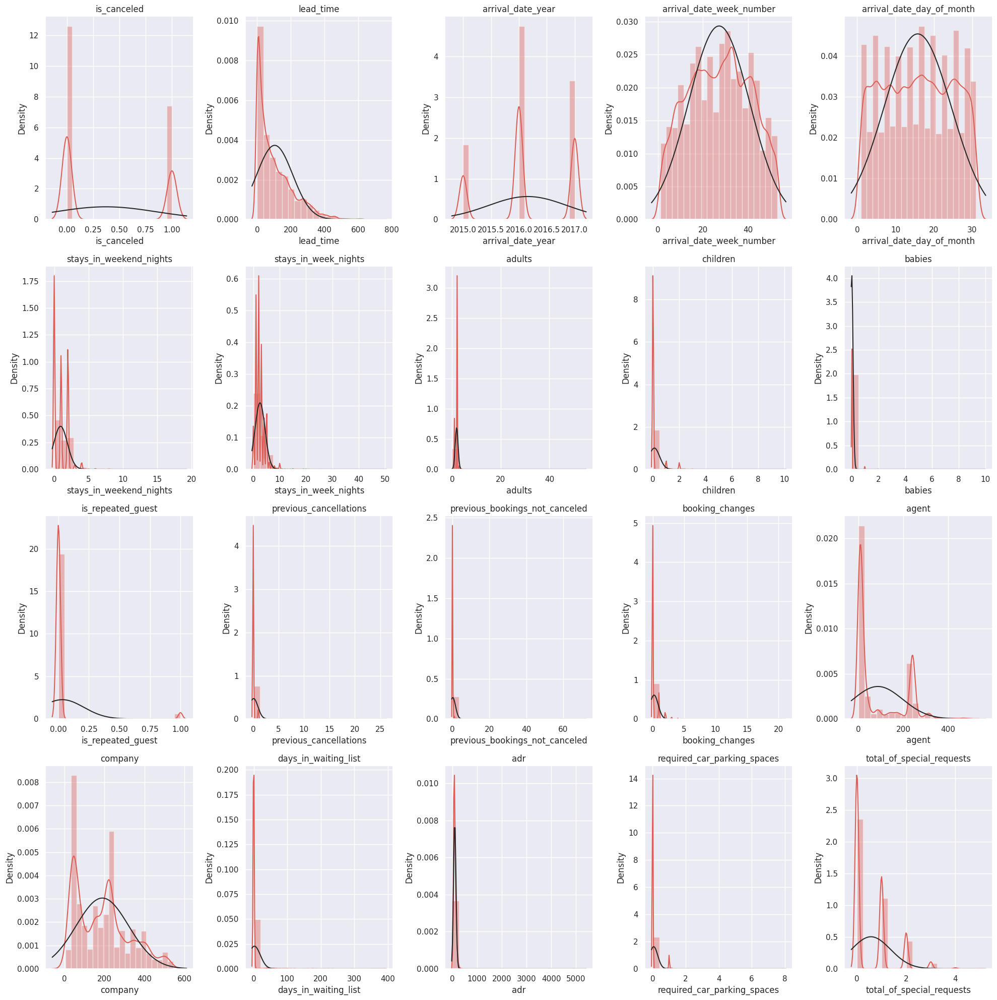

In [34]:
fig, ((ax1, ax2, ax3, ax4, ax5), 
      (ax6, ax7, ax8, ax9, ax10), 
      (ax11, ax12, ax13, ax14, ax15), 
      (ax16, ax17, ax18, ax19, ax20)) = plt.subplots(4, 5, figsize=(20, 20))

ax = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9, ax10, ax11, ax12, ax13, ax14, ax15, ax16, ax17, ax18, ax19, ax20]

for coluna in range(len(x_numericos.columns)):
    sns.distplot(x_numericos.iloc[:, coluna], bins=20, hist=True, ax=ax[coluna], fit=stats.norm)
    ax[coluna].set_title(x_numericos.columns[coluna])

plt.tight_layout()
plt.show()

Buscaremos agora compreender a força e direção de uma relação linear entre a variável independente e dependente.

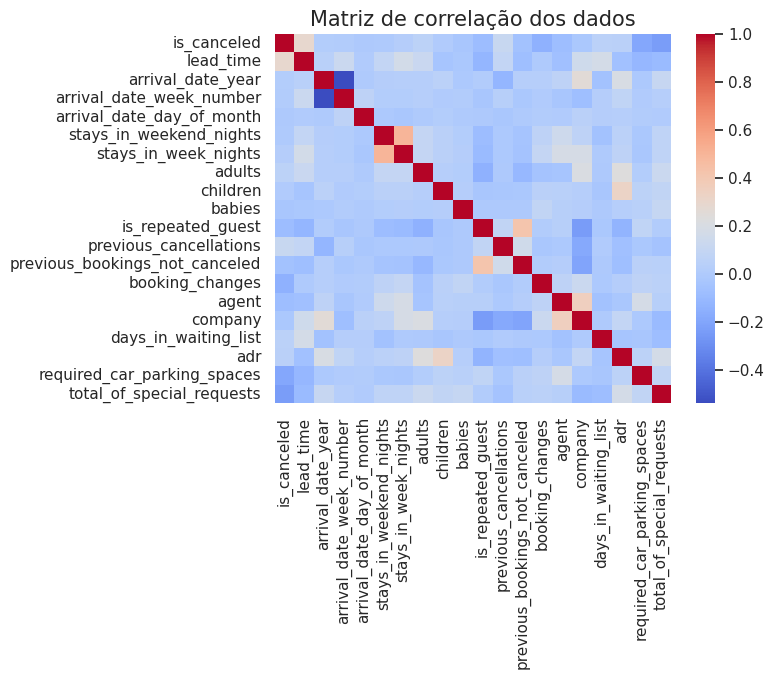

In [35]:
sns.heatmap(x_numericos.corr(),annot = False, cmap="coolwarm")
plt.title("Matriz de correlação dos dados",fontsize= 15)
plt.show()

Distribuições Extremamente Assimétricas (Alta Skewness):
`lead_time`: Enviesado à direita, com muitas reservas de curto prazo e algumas poucas de longuíssimo prazo.
`adr`: Alto pico em valores baixos e uma longa cauda à direita, indicando a presença de preços de diária muito elevados.
`previous_cancellations` e `previous_bookings_not_canceled`: Muitos valores próximos de zero e uma longa cauda, indicando que a maioria das reservas não teve cancelamentos prévios, mas algumas poucas tiveram um histórico extenso.
`days_in_waiting_list`: A maioria das reservas não espera, mas algumas poucas esperam muito tempo.

Distribuições Moderadamente Assimétricas:
`stays_in_weekend_nights` e `stays_in_week_nights`: Maior concentração de valores baixos, com poucas reservas de longuíssima duração.
`total_of_special_requests`: A maioria das reservas faz poucos pedidos especiais, mas há alguns casos com muitos pedidos.
`agent`: Alguns agentes dominam a distribuição das reservas, criando um viés.


Distribuições Quase Normais (Sem Necessidade de Transformação):
`arrival_date_week_number` e `arrival_date_day_of_month`: Distribuições aproximadamente simétricas.
`arrival_date_year`: Apresenta apenas algumas variações discretas ao longo do tempo.

##### 3.1.4.2 Identificação de *Outliers*

A análise de **outliers** é uma etapa essencial no processo de pré-processamento de dados, pois valores extremos podem distorcer estatísticas descritivas e impactar negativamente o desempenho dos modelos de **Machine Learning**.

Para identificar esses pontos fora do padrão, utilizaremos **boxplots**, que oferecem uma representação visual da **distribuição** de cada variável. A interpretação do boxplot inclui:

- A **linha central** da caixa representa a **mediana** (50º percentil).  
- A borda inferior da caixa indica o **primeiro quartil (Q1 - 25%)**.  
- A borda superior da caixa indica o **terceiro quartil (Q3 - 75%)**.  
- As **extensões** se estendem até o menor e maior valor dentro de **1,5 vezes o intervalo interquartílico (IQR)**.  
- **Pontos fora do boxplot** são considerados **outliers**.

Identificar outliers permite compreender melhor a **dispersão dos dados** e avaliar a necessidade de **tratamento adequado**, como remoção ou transformação desses valores. Essa análise contribui para melhorar a **qualidade dos dados** e aumentar a **robustez** do modelo preditivo.

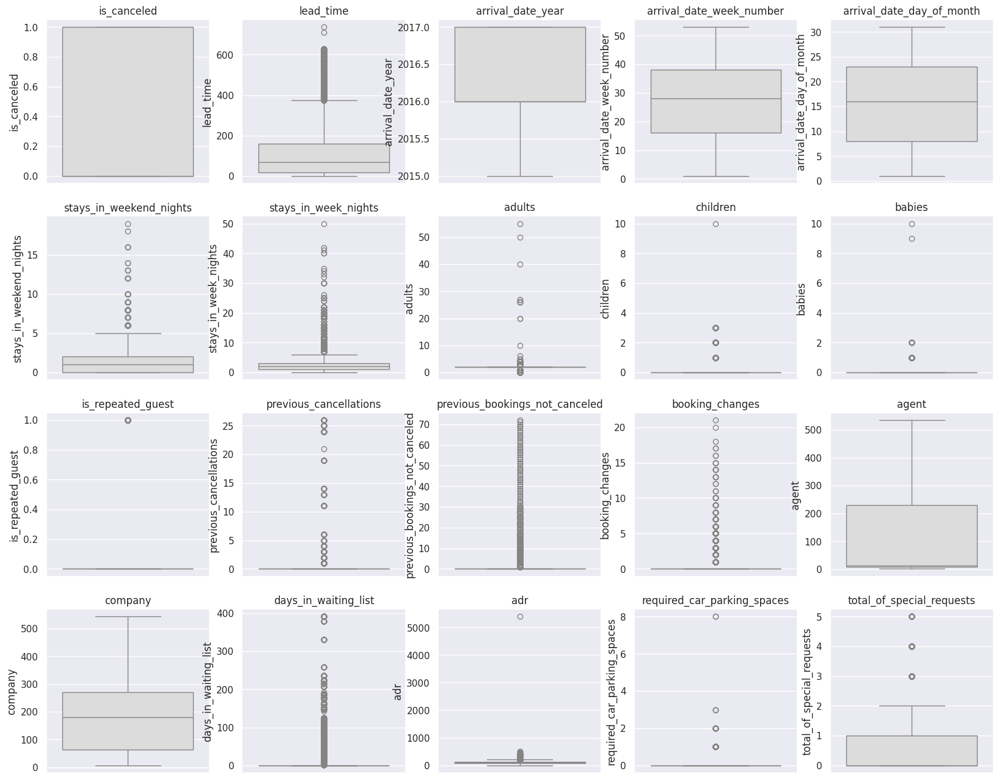

In [36]:
# Configurando o tamanho da figura e o layout dos subplots
num_cols = 5  # Número de colunas de subplots
num_rows = len(x_numericos.columns) // num_cols + (len(x_numericos.columns) % num_cols > 0)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 4 * num_rows))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop para criar um boxplot para cada coluna numérica
for i, col in enumerate(x_numericos.columns):
    sns.boxplot(y=df[col], ax=axes[i], palette='coolwarm')
    axes[i].set_title(col)

# Remover subplots vazios
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

Considerando a definição clássica de outliers — valores que excedem 1,5 vezes o intervalo interquartílico (IQR) —, identificamos que algumas variáveis apresentam valores extremos. No entanto, antes de decidir por sua remoção ou transformação, é fundamental analisar o contexto dos dados para garantir que essas observações não representem simplesmente características naturais do fenômeno estudado.

Entre as variáveis com maior quantidade de outliers visíveis estão:

`lead_time`: Algumas reservas possuem um tempo de antecedência muito elevado (acima de 600 dias). Embora seja um valor extremo, ele pode ser legítimo em casos de reservas feitas com muita antecedência, especialmente para eventos ou períodos de alta demanda.

`adr` (Preço da Diária): Apresenta uma distribuição altamente assimétrica, com valores extremamente altos. Esses valores podem indicar suítes de luxo ou períodos de preços elevados, como feriados e alta temporada. Excluir esses dados poderia remover informações importantes sobre a precificação dinâmica dos hotéis.

`stays_in_weekend_nights` e `stays_in_week_nights`: Algumas reservas apresentam um número muito alto de noites, o que pode indicar hospedagens atípicas ou contratos de longa duração. Dependendo do objetivo do modelo, pode ser interessante categorizá-los em diferentes faixas de duração.

`previous_cancellations` e `previous_bookings_not_canceled`: Alguns hóspedes possuem um número elevado de reservas anteriores, o que pode representar clientes corporativos ou usuários com comportamento recorrente de reserva e cancelamento. Esses valores são relevantes e devem ser mantidos para análise de padrões de cancelamento.

`days_in_waiting_list`: A maioria das reservas não passa tempo na lista de espera, mas alguns registros apresentam valores altos. Esse dado pode ser importante para entender a demanda por determinados períodos.

Dado que os valores extremos observados não são necessariamente erros e refletem comportamentos reais do mercado hoteleiro, optamos por não remover diretamente esses dados.

Nesta fase de exploração dos dados vemos que:


1.   Há dados faltantes.
2.   Existe uma predominância nos dados de *feature* categórica, que enseja no uso de técnicas de *dummie's*.
1.   Algumas features não tem poder preditivo.
2.   Ficou claro que um dos pressupostos da classificação foi atendido parcealmente, há um leve desbalaceamento de classes das variável a ser predita, que iremos usar no modelo e ver o comportamento.
2.   Poderíamos ter feito (a) correlações, (b) re-shape dos dados, (c) alterado variáveis categóricas para apenas binária... enfim, é muito vasto a fase de exploração. Para nosso propósito acredito já ser suficiente.

Iniciaremos a fase de preparar os dados para apresentá-los ao modelo preditivo.





## 4. Pré-Processamento dos Dados

### **Preparando os Dados para Machine Learning**

O **pré-processamento dos dados** é uma etapa fundamental no desenvolvimento de modelos de **Machine Learning**, pois muitos algoritmos exigem que os dados estejam em formatos específicos e adequadamente preparados para garantir um desempenho eficiente. Essa preparação inclui desde o **tratamento de dados ausentes**, **normalização** e **padronização** até a **codificação de variáveis categóricas** e **remoção de outliers**.

**Importância do Pré-Processamento:**  
- **Melhora a performance** e a **eficiência** dos algoritmos.  
- Garante que os dados estejam em um formato **compatível** com o modelo.  
- **Reduz ruídos** e **viéses**, aumentando a **precisão** das previsões.  

Explorar diferentes técnicas de preparação de dados e avaliar seu impacto no desempenho dos modelos faz parte do processo iterativo da **Ciência de Dados**. Essa experimentação é essencial para desenvolver soluções robustas e eficazes.

**Testar diferentes abordagens é uma das partes mais interessantes e criativas da Ciência de Dados!**


### 4.1 Transformação de Variáveis/Atributos

In [37]:
df.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,...,No Deposit,NaN,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,...,No Deposit,304.0,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,No Deposit,240.0,NaN,0,Transient,98.0,0,1,Check-Out,2015-07-03


In [38]:
df_proc = df.copy()
df_proc.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,...,No Deposit,NaN,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,...,No Deposit,304.0,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,No Deposit,240.0,NaN,0,Transient,98.0,0,1,Check-Out,2015-07-03


#### 4.1.1 Imputação de Valores Ausentes

Embora o conjunto de dados atual **não apresente valores ausentes**, é importante documentar estratégias de **imputação** para lidar com situações futuras em que **dados faltantes** possam surgir durante o processo de **pré-processamento** ou em atualizações da base de dados.

A imputação de valores ausentes deve ser realizada com cuidado, considerando o tipo de variável (numérica ou categórica) e a distribuição dos dados. Abaixo estão dois métodos amplamente utilizados para **variáveis numéricas**:

**Imputação pela Mediana**  
A substituição de valores ausentes pela **mediana** é recomendada quando a variável possui **outliers**, pois a mediana é menos sensível a valores extremos do que a média.

**Implementação com `SimpleImputer`:**

```python
from sklearn.impute import SimpleImputer
import numpy as np

# Criando o imputador com estratégia de mediana
imp_num = SimpleImputer(missing_values=np.nan, strategy='median', add_indicator=True)

# Aplicando a imputação nos dados
dados_imputados = imp_num.fit_transform(dados)


In [39]:
pct_miss = 100*df.isnull().sum()/len(df)
pct_miss[(-pct_miss).argsort()]

company                           94.306893
agent                             13.686238
country                            0.408744
children                           0.003350
hotel                              0.000000
total_of_special_requests          0.000000
required_car_parking_spaces        0.000000
adr                                0.000000
customer_type                      0.000000
days_in_waiting_list               0.000000
deposit_type                       0.000000
booking_changes                    0.000000
assigned_room_type                 0.000000
reserved_room_type                 0.000000
previous_bookings_not_canceled     0.000000
previous_cancellations             0.000000
distribution_channel               0.000000
reservation_status                 0.000000
market_segment                     0.000000
meal                               0.000000
babies                             0.000000
adults                             0.000000
stays_in_week_nights            

Iremos excluir as variaveis `company`e `agent` considerando (i) quantidade elevada de dados missing e a (ii) baixa capacidade de entregar relevancia o modelo, identificando no dicionário de dados perceberemos que são ID.

Definimos excluir as variáveis `country` e `reservation_status_date`, a primeira no processo de transformar a variável em numérica, devido a sua grande quantidade de registros categóricos únicos (177) poderia aumentar a dimensionalidade dos dados, já a segunda assuminos *a priore* que não possui valor preditivo. (PS(i). essas 2 variáveis so chegamos a essa conclusão quando estávamos desenvolvendo o passo 4.1.2)

Exluiremos também a variável `reservation_status` pois o modelo pode haver um "vazamento de informção" e o modelo não conseguirá generalizar pois essa feature, ao que parece, ocorre posterior a variável target. (PS(ii). treinamos o modelo com essa variavel e teve um  overfitting)

Já para `children` vamos excluir os registros dado a quantidade de obsrvações geral que temos,

In [40]:
print(f'dados antes do tratamento de missing values: {df_proc.shape}')

dados antes do tratamento de missing values: (119390, 32)


In [41]:
df_proc= df_proc.drop(columns=['company', 'agent', 'country', 'reservation_status_date', 'reservation_status'])
print(f'dados após o primeiro tratamento de missing values: {df_proc.shape}')

dados após o primeiro tratamento de missing values: (119390, 27)


In [42]:
df_proc= df_proc.dropna(subset=['children'])
print(f'dados após o segundo tratamento de missing values: {df_proc.shape}')

dados após o segundo tratamento de missing values: (119386, 27)


#### 4.1.2 Codificação de Variáveis Categóricas (*Dummies*)

Para que os algoritmos de Machine Learning possam processar corretamente os dados, todas as variáveis precisam estar em formato numérico. Como muitas variáveis categóricas contêm informações importantes para o modelo, é necessário convertê-las para valores numéricos sem perder informação semântica. Esse processo é conhecido como codificação de variáveis categóricas.

A técnica de codificação utilizada depende do tipo de variável categórica:

Codificação de Variáveis **Binárias**:

Quando a variável possui apenas duas categorias distintas (ex.: Gender com valores Masculino e Feminino), a abordagem mais eficiente é a codificação ordinal.

✅ Método Utilizado: LabelEncoder

Atribui um valor numérico sequencial para representar cada categoria.
Exemplo:
Masculino → 0
Feminino → 1
Essa abordagem é simples e evita a criação de colunas adicionais, tornando o modelo mais eficiente.

Codificação de Variáveis **Multiclasse**:

Quando a variável contém mais de duas categorias distintas (ex.: Market_Segment, Deposit_Type, Meal), o método mais adequado é a codificação One-Hot Encoding.

✅ Método Utilizado: pd.get_dummies()

Cria colunas binárias para cada categoria, onde cada coluna indica a presença (1) ou ausência (0) daquela categoria na amostra.

 Atenção à Dimensionalidade dos Dados!

Criar muitas colunas adicionais pode aumentar significativamente a dimensionalidade do dataset, tornando o modelo mais complexo e podendo levar a overfitting.
Para evitar redundância, recomenda-se excluir uma das colunas geradas (evitar *dummy variable trap* - efeito da multicolinearidade).


In [43]:
df_proc[df_proc.select_dtypes(include=['object']).columns].nunique().sort_values(ascending=True)

hotel                    2
deposit_type             3
customer_type            4
meal                     5
distribution_channel     5
market_segment           7
reserved_room_type      10
arrival_date_month      12
assigned_room_type      12
dtype: int64

In [44]:
df_proc.select_dtypes(include=['object']).columns

Index(['hotel', 'arrival_date_month', 'meal', 'market_segment',
       'distribution_channel', 'reserved_room_type', 'assigned_room_type',
       'deposit_type', 'customer_type'],
      dtype='object')

**Binárias**

In [45]:
label_encoder = LabelEncoder()

In [46]:
df_proc['hotel'] = label_encoder.fit_transform(df_proc['hotel'])
print(df_proc['hotel'].head())

0    1
1    1
2    1
3    1
4    1
Name: hotel, dtype: int64


In [47]:
print(f'dataset antes do tratamento de variáveis categóricas: {df_proc.shape}')

dataset antes do tratamento de variáveis categóricas: (119386, 27)


 **Multiclasse**

In [48]:
colunas_dummies = ['arrival_date_month', 'meal', 'market_segment', 'distribution_channel', 'reserved_room_type',\
                    'assigned_room_type', 'deposit_type', 'customer_type']

In [49]:
df_proc.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests
0,1,0,342,2015,July,27,1,0,0,2,...,0,C,C,3,No Deposit,0,Transient,0.0,0,0
1,1,0,737,2015,July,27,1,0,0,2,...,0,C,C,4,No Deposit,0,Transient,0.0,0,0
2,1,0,7,2015,July,27,1,0,1,1,...,0,A,C,0,No Deposit,0,Transient,75.0,0,0
3,1,0,13,2015,July,27,1,0,1,1,...,0,A,A,0,No Deposit,0,Transient,75.0,0,0
4,1,0,14,2015,July,27,1,0,2,2,...,0,A,A,0,No Deposit,0,Transient,98.0,0,1


`drop_first=True`: Este parâmetro indica que a primeira categoria de cada coluna categórica deve ser removida. Isso é feito para evitar a multicolinearidade em modelos de regressão. Quando você tem n categorias, você só precisa de n-1 variáveis dummy para representá-las, pois a última categoria pode ser inferida a partir das outras.

In [50]:
df_proc = pd.get_dummies(df_proc, columns=colunas_dummies, dtype=int, drop_first=True)
print(f'dataset após o tratamento de variáveis categóricas: {df_proc.shape}')

dataset após o tratamento de variáveis categóricas: (119386, 69)


In [51]:
df_proc.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,...,assigned_room_type_H,assigned_room_type_I,assigned_room_type_K,assigned_room_type_L,assigned_room_type_P,deposit_type_Non Refund,deposit_type_Refundable,customer_type_Group,customer_type_Transient,customer_type_Transient-Party
0,1,0,342,2015,27,1,0,0,2,0.0,...,0,0,0,0,0,0,0,0,1,0
1,1,0,737,2015,27,1,0,0,2,0.0,...,0,0,0,0,0,0,0,0,1,0
2,1,0,7,2015,27,1,0,1,1,0.0,...,0,0,0,0,0,0,0,0,1,0
3,1,0,13,2015,27,1,0,1,1,0.0,...,0,0,0,0,0,0,0,0,1,0
4,1,0,14,2015,27,1,0,2,2,0.0,...,0,0,0,0,0,0,0,0,1,0


In [52]:
df_proc.info()

<class 'pandas.core.frame.DataFrame'>
Index: 119386 entries, 0 to 119389
Data columns (total 69 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119386 non-null  int64  
 1   is_canceled                     119386 non-null  int64  
 2   lead_time                       119386 non-null  int64  
 3   arrival_date_year               119386 non-null  int64  
 4   arrival_date_week_number        119386 non-null  int64  
 5   arrival_date_day_of_month       119386 non-null  int64  
 6   stays_in_weekend_nights         119386 non-null  int64  
 7   stays_in_week_nights            119386 non-null  int64  
 8   adults                          119386 non-null  int64  
 9   children                        119386 non-null  float64
 10  babies                          119386 non-null  int64  
 11  is_repeated_guest               119386 non-null  int64  
 12  previous_cancellation

In [53]:
df_proc.corr()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,...,assigned_room_type_H,assigned_room_type_I,assigned_room_type_K,assigned_room_type_L,assigned_room_type_P,deposit_type_Non Refund,deposit_type_Refundable,customer_type_Group,customer_type_Transient,customer_type_Transient-Party
hotel,1.000000,-0.136505,-0.075405,-0.035308,-0.001261,0.001836,0.186595,0.234022,0.013199,0.044205,...,0.108997,0.077712,-0.034394,0.004073,-0.003586,-0.172014,0.042234,0.023120,0.005713,-0.027768
is_canceled,-0.136505,1.000000,0.293177,0.016732,0.008132,-0.006084,-0.001783,0.024771,0.059990,0.005048,...,-0.002866,-0.040783,-0.032811,0.003773,0.013072,0.481488,-0.011310,-0.038696,0.133170,-0.124231
lead_time,-0.075405,0.293177,1.000000,0.040093,0.126885,0.002234,0.085667,0.165799,0.119544,-0.037622,...,-0.021101,-0.019328,-0.027952,-0.002817,-0.009759,0.380174,0.016586,-0.031927,-0.174026,0.159622
arrival_date_year,-0.035308,0.016732,0.040093,1.000000,-0.540566,-0.000279,0.021489,0.030878,0.029674,0.054624,...,0.001462,0.000249,0.008904,-0.004732,0.004867,-0.065987,-0.000762,-0.010987,0.227880,-0.163499
arrival_date_week_number,-0.001261,0.008132,0.126885,-0.540566,1.000000,0.066824,0.018209,0.015559,0.025901,0.005518,...,0.008424,-0.004897,0.003531,0.000390,0.003133,0.007777,-0.016887,0.011619,-0.079526,0.042191
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
deposit_type_Non Refund,-0.172014,0.481488,0.380174,-0.065987,0.007777,-0.008629,-0.114279,-0.080002,-0.028972,-0.096671,...,-0.028234,-0.020139,-0.018057,-0.001080,-0.003741,1.000000,-0.013752,-0.026000,0.115851,-0.121434
deposit_type_Refundable,0.042234,-0.011310,0.016586,-0.000762,-0.016887,0.032149,0.001761,0.006791,0.003247,-0.006754,...,-0.002855,-0.002036,-0.001784,-0.000107,-0.000370,-0.013752,1.000000,0.023679,-0.053433,0.054660
customer_type_Group,0.023120,-0.038696,-0.031927,-0.010987,0.011619,-0.001551,-0.007163,-0.016182,0.058978,-0.006650,...,-0.003829,0.007120,0.004131,-0.000202,0.011349,-0.026000,0.023679,1.000000,-0.120903,-0.035975
customer_type_Transient,0.005713,0.133170,-0.174026,0.227880,-0.079526,-0.000670,0.019475,0.007292,0.091051,0.096135,...,0.031823,-0.007902,0.003840,0.001668,0.003848,0.115851,-0.053433,-0.120903,1.000000,-0.895584


In [54]:
pd.set_option('display.max_rows', None)
df_proc.corr().iloc[1]

hotel                            -0.136505
is_canceled                       1.000000
lead_time                         0.293177
arrival_date_year                 0.016732
arrival_date_week_number          0.008132
arrival_date_day_of_month        -0.006084
stays_in_weekend_nights          -0.001783
stays_in_week_nights              0.024771
adults                            0.059990
children                          0.005048
babies                           -0.032488
is_repeated_guest                -0.084788
previous_cancellations            0.110140
previous_bookings_not_canceled   -0.057355
booking_changes                  -0.144371
days_in_waiting_list              0.054193
adr                               0.047622
required_car_parking_spaces      -0.195492
total_of_special_requests        -0.234706
arrival_date_month_August         0.005223
arrival_date_month_December      -0.010513
arrival_date_month_February      -0.020201
arrival_date_month_January       -0.031064
arrival_dat

In [55]:
pd.reset_option('display.max_rows')

Após a transformação das variáveis categóricas em numéricas por meio da técnica de dummies, analisamos a correlação entre essas variáveis e a variável alvo. Esse processo nos permitiu identificar quais atributos possuem maior potencial preditivo e quais apresentam uma relação fraca com o cancelamento das reservas.

Com base nos resultados, optamos por remover as variáveis cuja correlação foi insignificante, simplificando o modelo e reduzindo a complexidade sem perda substancial de informação. No entanto, é fundamental destacar que qualquer manipulação nos dados impacta diretamente o desempenho do modelo, podendo resultar tanto em melhorias quanto em perdas significativas de desempenho.

Por razões **didáticas**, seguiremos essa abordagem de exclusão, mas reforçamos que, em um processo mais refinado de *feature engineering*, seria recomendável explorar novas combinações de variáveis. Um exemplo seria a fusão das variáveis `children`, `babies` e `adults` em uma única variável `familia`, que poderia capturar melhor o comportamento dos hóspedes em relação ao cancelamento. Essa etapa de criação de novas features pode revelar relações ocultas e aprimorar a capacidade preditiva do modelo.

In [56]:
df_proc.columns

Index(['hotel', 'is_canceled', 'lead_time', 'arrival_date_year',
       'arrival_date_week_number', 'arrival_date_day_of_month',
       'stays_in_weekend_nights', 'stays_in_week_nights', 'adults', 'children',
       'babies', 'is_repeated_guest', 'previous_cancellations',
       'previous_bookings_not_canceled', 'booking_changes',
       'days_in_waiting_list', 'adr', 'required_car_parking_spaces',
       'total_of_special_requests', 'arrival_date_month_August',
       'arrival_date_month_December', 'arrival_date_month_February',
       'arrival_date_month_January', 'arrival_date_month_July',
       'arrival_date_month_June', 'arrival_date_month_March',
       'arrival_date_month_May', 'arrival_date_month_November',
       'arrival_date_month_October', 'arrival_date_month_September', 'meal_FB',
       'meal_HB', 'meal_SC', 'meal_Undefined', 'market_segment_Complementary',
       'market_segment_Corporate', 'market_segment_Direct',
       'market_segment_Groups', 'market_segment_Offline

In [57]:
df_proc= df_proc.drop(columns=[ 'arrival_date_month_August', 'arrival_date_month_December', 'arrival_date_month_February',\
                                'arrival_date_month_January', 'arrival_date_month_July', 'arrival_date_month_June', 'arrival_date_month_March',\
                                'arrival_date_month_May', 'arrival_date_month_November', 'arrival_date_month_October', 'arrival_date_month_September',\
                                'arrival_date_week_number', 'arrival_date_day_of_month', 'adults', 'children', 'babies', 'stays_in_weekend_nights', 'stays_in_week_nights'])

In [58]:
print(f'dataset após o processamento: {df_proc.shape}')

dataset após o processamento: (119386, 51)


### 4.2 Split dados

Para avaliar o desempenho do modelo, é fundamental dividir os dados em conjuntos de treino e teste. Duas abordagens amplamente utilizadas são: 
* (i) o método estático, implementado pela função train_test_split da biblioteca sklearn.model_selection, que separa os dados em uma única iteração; e
* (ii) a validação cruzada (Cross-validation), que realiza divisões aleatórias e avalia o modelo em diferentes subconjuntos para maior robustez.

Optamos pelo método estático, mantendo o *default* de 75% dos dados para treino e 25% para teste, garantindo simplicidade e uma divisão consistente para o desenvolvimento inicial do modelo.

#### 4.2.1 Estático

In [59]:
df_proc.head()

,hotel,is_canceled,lead_time,arrival_date_year,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,days_in_waiting_list,adr,...,assigned_room_type_H,assigned_room_type_I,assigned_room_type_K,assigned_room_type_L,assigned_room_type_P,deposit_type_Non Refund,deposit_type_Refundable,customer_type_Group,customer_type_Transient,customer_type_Transient-Party
0,1,0,342,2015,0,0,0,3,0,0.0,...,0,0,0,0,0,0,0,0,1,0
1,1,0,737,2015,0,0,0,4,0,0.0,...,0,0,0,0,0,0,0,0,1,0
2,1,0,7,2015,0,0,0,0,0,75.0,...,0,0,0,0,0,0,0,0,1,0
3,1,0,13,2015,0,0,0,0,0,75.0,...,0,0,0,0,0,0,0,0,1,0
4,1,0,14,2015,0,0,0,0,0,98.0,...,0,0,0,0,0,0,0,0,1,0


In [60]:
X = df_proc.drop(columns= ['is_canceled'], axis= 1)
y = df_proc.is_canceled

O parâmetro **`stratify=True`** assegura que a divisão dos dados em **conjuntos de treino e teste** mantenha a **proporção original das classes** da variável alvo, evitando desequilíbrios entre as categorias.  

Já o parâmetro **`shuffle=True`** tem a função de **embaralhar aleatoriamente** os dados antes da divisão, garantindo que a separação entre treino e teste ocorra de forma **aleatória**, reduzindo o risco de viés nos conjuntos.

In [61]:
X_treino, X_teste, y_treino, y_teste = train_test_split(X, y, stratify=y, shuffle=True)

In [62]:
print('tamanho total dos dados são {}, para treino temos {} e teste são {}'.format(df_proc.shape[0], len(X_treino), len(X_teste)))

tamanho total dos dados são 119386, para treino temos 89539 e teste são 29847


### 4.3 Feature Engineer - II

#### 4.3.1.Balanceamento de classes

São técnicas para manter um "certo balancemanto" entre as classes, pois se temos classe majoritária o modelo de *ML*, possivelmente aprenderá mais sobre ela, logo temos um problema -> **modelo sem generalização**, devemos evitar!!.

Podemos utilizar:

- **Oversampling (Superamostragem)**: Aumentar a quantidade de registros da classe minoritária por meio da duplicação de dados ou geração de novas amostras sintéticas, como a técnica **SMOTE** (*Synthetic Minority Over-sampling Technique*).  
- **Undersampling (Subamostragem)**: Reduzir a quantidade de registros da classe majoritária, eliminando amostras redundantes para equilibrar a proporção entre as classes.  

**ATENÇÃO 1**: o ideal é sempre aplicar as técnicas depois de realizar o split dos dados (treino e teste). Se aplicar o balancemento antes, o padrão usado para aplicar o oversampling/undersampling será o mesmo nos dados de treino e de teste, com isso a avaliação do modelo fica comprometida.

**ATENÇÃO 2**: você ao tomar decisão de balancear os dados, diretamente está alterando seu conjunto de dados. Ou seja, saiba **o que** está fazendo e **para que** está fazendo!!!!

Conforme já dito anteriormente(*item [3.1.2.2]*), neste estudo a variável `is_canceled` apresenta um leve desbalanceamento, mas não em um nível que exija, de imediato, a aplicação de técnicas de balanceamento. Iremos treinar o modelo, assumindo esse leve desbalanceamento, muito embora seja realizado uma segunda versão buscando balancear as classes.

= output: dados pré-processados e splitados para iniciar a construção do modelo de ML

### **4.4 Avaliação de Multicolinearidade**

A **multicolinearidade** ocorre quando variáveis independentes estão altamente correlacionadas, o que pode distorcer os **coeficientes** do modelo, dificultar a **interpretação** e reduzir a **precisão preditiva**.  

Para detectar esse problema, utiliza-se o **Fator de Inflação da Variância (VIF)**, que indica o quanto a variância de um coeficiente é ampliada pela correlação entre variáveis.  

**Interpretação do VIF:**  
- **VIF ≈ 1:** Baixa correlação (**sem multicolinearidade**).  
- **VIF > 10:** Indica **multicolinearidade severa**.

**Tratamento da Multicolinearidade:**  
- **Ajustar ou remover** variáveis com **VIF elevado** para melhorar a **robustez** e a **interpretabilidade** do modelo.  
- Quando a remoção não for viável, aplicar **técnicas de regularização** como:  
  - **Ridge Regression (L2):** Penaliza coeficientes grandes, suavizando o impacto de variáveis correlacionadas.  
  - **Lasso Regression (L1):** Realiza **seleção de variáveis** ao reduzir coeficientes menos relevantes a zero.  

Essas técnicas ajudam a mitigar a multicolinearidade sem a necessidade de excluir variáveis importantes.

X_treino, X_teste, y_treino, y_teste

In [165]:
vif_data = pd.DataFrame()
vif_data['Feature'] = X_treino.columns
vif_data['VIF'] = [variance_inflation_factor(X_treino.values, i) for i in range(X_treino.shape[1])]

print("Valores de VIF para cada variável:")
print(vif_data)

Valores de VIF para cada variável:
                                          Feature   VIF
0                                        duration  5.91
1                                   credit_amount  5.39
2                          installment_commitment 10.52
3                                 residence_since  9.75
4                                             age  4.56
5                                existing_credits 11.91
6                                  num_dependents 12.52
7                                   own_telephone  2.24
8                                  foreign_worker 28.04
9                         other_parties_guarantor  2.18
10                             other_parties_none 23.94
11                       other_payment_plans_none  7.66
12                     other_payment_plans_stores  1.41
13                                    housing_own 16.72
14                                   housing_rent  4.54
15                             checking_status_<0  2.33
16           

Pelas features que ficaram com valores acima de 10, sugere-no usar no precesso de regressão logística algurma técnica de regularização.

## 5. Seleção de Algoritmos

### 5.1 Algoritmos de Classificação

A escolha do algoritmo de **classificação** mais adequado não é previsível, pois diferentes modelos podem apresentar desempenhos distintos dependendo das características dos dados. Por esse motivo, é essencial **ajustar** (*fit*) e **avaliar** diversos algoritmos de classificação no conjunto de dados. O objetivo é identificar o modelo que oferece o melhor **desempenho preditivo** e **generalização**.

In [64]:
# Instanciar o modelo
ridge_model = LogisticRegression(penalty='l2', solver='lbfgs', max_iter=1000, random_state=42)

# Treinar o modelo
ridge_model.fit(X_treino, y_treino)

LogisticRegression(max_iter=1000, random_state=42)

In [65]:
# Avaliar coeficientes após regularização
coef_df = pd.DataFrame({'Feature': X_treino.columns, 'Coefficient': ridge_model.coef_[0]})
print(coef_df.sort_values(by='Coefficient', ascending=False))

                           Feature  Coefficient
45         deposit_type_Non Refund     5.936046
4           previous_cancellations     3.406655
27            reserved_room_type_D     0.856323
20        market_segment_Online TA     0.765776
48         customer_type_Transient     0.532560
28            reserved_room_type_E     0.508711
11                         meal_FB     0.308719
26            reserved_room_type_C     0.245691
25            reserved_room_type_B     0.236302
0                            hotel     0.215996
23      distribution_channel_TA/TO     0.176384
13                         meal_SC     0.095766
15    market_segment_Complementary     0.069976
30            reserved_room_type_G     0.066661
49   customer_type_Transient-Party     0.035394
33            reserved_room_type_P     0.031387
44            assigned_room_type_P     0.031387
46         deposit_type_Refundable     0.008175
8                              adr     0.005498
1                        lead_time     0

Os coeficientes apresentados representam o impacto de cada variável preditora na probabilidade de um cliente cancelar sua reserva em um hotel. Um coeficiente positivo indica que o aumento da variável preditora aumenta a probabilidade de cancelamento, enquanto um coeficiente negativo indica o oposto. A magnitude do coeficiente reflete a força da influência.

**Variáveis com Maior Impacto**:

`deposit_type_Non Refund `(5.936046): Este é o fator mais preditivo para cancelamentos. Depósitos não reembolsáveis estão fortemente associados a uma maior probabilidade de cancelamento, provavelmente porque os clientes que fazem esse tipo de depósito podem ter menos incentivo para manter a reserva se seus planos mudarem.

`previous_cancellations` (3.406655): Histórico de cancelamentos anteriores é um forte indicador de que um cliente poderá cancelar novamente.

`required_car_parking_spaces` (-3.714556): Este é o fator com maior impacto negativo. Clientes que precisam de vaga de estacionamento têm uma probabilidade significativamente menor de cancelar, sugerindo que a necessidade de estacionamento pode indicar uma viagem mais planejada e, portanto, menos propensa a ser cancelada.

**Variáveis com Impacto Moderado**:

`market_segment_Online TA` (0.765776): Reservas feitas através de agências de viagens online (OTAs) estão associadas a uma maior probabilidade de cancelamento, possivelmente devido à maior flexibilidade e concorrência de preços online.

`customer_type_Transient` (0.532560): Clientes que se hospedam no hotel sem fazer parte de um grupo ou evento têm maior probabilidade de cancelar.

`assigned_room_type_D` (-1.078639): Aparentemente, clientes que reservam quartos do tipo "D" têm uma chance menor de cancelar.

**Variáveis com Menor Impacto**:
`meal_FB` (0.308719), `reserved_room_type_C` (0.245691), `reserved_room_type_B` (0.236302), `hotel` (0.215996): Estas variáveis têm um impacto positivo relativamente pequeno na probabilidade de cancelamento.

Outras variáveis:
A maioria das outras variáveis, como tipo de refeição, tipo de quarto reservado, canal de distribuição e número de solicitações especiais, tem um impacto relativamente pequeno (positivo ou negativo) na probabilidade de cancelamento.

Variáveis com impacto negativo: Indicam fatores que podem reduzir a probabilidade de cancelamento, como necessidade de estacionamento, tempo de antecedência da reserva e ser um hóspede recorrente.
Magnitude dos coeficientes: Quanto maior o valor absoluto do coeficiente, maior o impacto da variável na probabilidade de cancelamento.
Contexto e conhecimento do negócio: A interpretação dos coeficientes deve ser feita em conjunto com o conhecimento do negócio e outros dados disponíveis. Por exemplo, pode ser interessante investigar por que clientes que reservam através de OTAs ou que fazem depósitos não reembolsáveis têm maior probabilidade de cancelar.

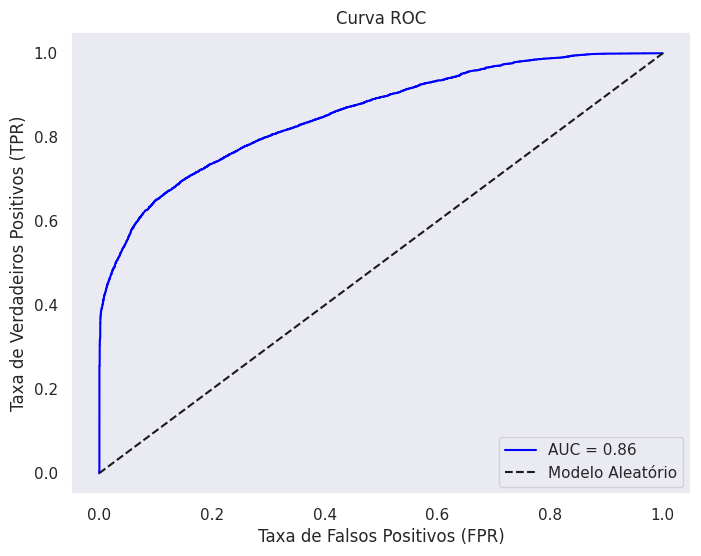

<Figure size 640x480 with 0 Axes>

In [66]:
# Probabilidades previstas (classe positiva)
y_prob = ridge_model.predict_proba(X_teste)[:, 1]

# Curva ROC
fpr, tpr, thresholds = roc_curve(y_teste, y_prob)
auc = roc_auc_score(y_teste, y_prob)

# Plot da Curva ROC
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f'AUC = {auc:.2f}', color='blue')
plt.plot([0, 1], [0, 1], 'k--', label='Modelo Aleatório')
plt.title('Curva ROC')
plt.xlabel('Taxa de Falsos Positivos (FPR)')
plt.ylabel('Taxa de Verdadeiros Positivos (TPR)')
plt.legend(loc='lower right')
plt.grid()
plt.show()
plt.tight_layout();

A Curva ROC (Receiver Operating Characteristic) é uma métrica de avaliação muito utilizada para modelos de classificação binária. Ela mede a capacidade do modelo em diferenciar entre as classes positiva e negativa.


O modelo apresenta um AUC = 0,86, o que indica uma boa capacidade de classificação. Isso significa que o modelo tem 86% de chance de classificar corretamente um cliente que poderá realizar ou não um cancelameto.

In [70]:
# Impressão das métricas de classificação
y_pred = ridge_model.predict(X_teste)
print("\nRelatório de Classificação:\n", classification_report(y_teste, y_pred))


Relatório de Classificação:
               precision    recall  f1-score   support

           0       0.80      0.93      0.86     18792
           1       0.84      0.60      0.70     11055

    accuracy                           0.81     29847
   macro avg       0.82      0.77      0.78     29847
weighted avg       0.81      0.81      0.80     29847



O relatório indica que o modelo apresenta um bom desempenho na Classe 0 (reservas não canceladas). O modelo atingiu um recall de 93%, o que significa que ele consegue identificar corretamente 93% das reservas que realmente foram concluídas. Além disso, a precisão de 80% mostra que, entre todas as reservas classificadas como não canceladas, 80% foram corretamente identificadas.

Por outro lado, o desempenho na Classe 1 (reservas canceladas) foi moderado. O recall de 60% indica que o modelo conseguiu identificar 60% das reservas que realmente foram canceladas. No entanto, a precisão de 84% revela que, entre todas as reservas classificadas como canceladas, 84% estavam corretas, indicando uma quantidade considerável de falsos negativos.

A alta taxa de falsos negativos implica que muitas reservas que foram efetivamente canceladas não foram corretamente previstas, o que pode impactar a estratégia operacional do hotel, reduzindo a capacidade de antecipar cancelamentos. Por outro lado, a taxa de falsos positivos também merece atenção, pois algumas reservas que seriam concluídas podem ser incorretamente previstas como canceladas, o que pode levar a ações desnecessárias, como tentativa de retenção ou bloqueio indevido de quartos.

Em termos gerais, o modelo tem boa capacidade de prever reservas que serão mantidas, mas pode ser otimizado para melhorar a detecção de cancelamentos reais e reduzir falsos negativos, garantindo uma melhor alocação de recursos e minimizando impactos operacionais

Especificidade: 0.93


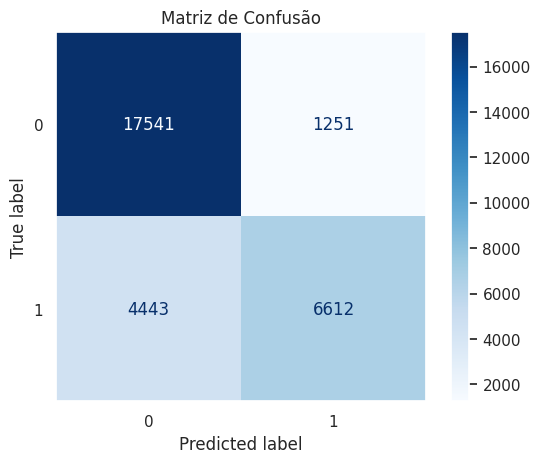

In [68]:
# Matriz de confusão
cm = confusion_matrix(y_teste, y_pred)
tn, fp, fn, tp = cm.ravel()
specificity = tn / (tn + fp)
print(f"Especificidade: {specificity:.2f}")

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=ridge_model.classes_)
disp.plot(cmap='Blues', values_format='d')
plt.title('Matriz de Confusão')
plt.grid(False)
plt.show()

Verdadeiros Negativos (TN) = 17.541:
O modelo classificou corretamente 17.541 reservas como não canceladas, o que mostra que ele tem boa capacidade de identificar reservas que serão concluídas.

Verdadeiros Positivos (TP) = 6.612:
O modelo conseguiu prever corretamente 6.612 casos em que as reservas foram canceladas, o que indica que há uma boa detecção de cancelamentos, mas ainda há espaço para melhoria.

Falsos Positivos (FP) = 1.251
O modelo classificou 1.251 reservas como canceladas, mas na realidade elas não foram canceladas. Isso pode levar a ações desnecessárias, como tentativas de retenção para clientes que não precisariam delas.

Falsos Negativos (FN) = 4.443
O modelo previu 4.443 reservas como não canceladas, mas elas foram canceladas. Esse é um número significativo, pois significa que muitos cancelamentos reais não foram detectados, o que pode afetar a gestão de disponibilidade do hotel e causar prejuízos operacionais.

Impacto dos Erros do Modelo
Falsos Positivos (FP)
Podem levar a ações desnecessárias, como tentativas de contato para retenção de clientes que não iriam cancelar a reserva.

Falsos Negativos (FN)
Têm um impacto mais crítico, pois representam reservas canceladas que o modelo não previu, podendo gerar superlotação fictícia e problemas na gestão do hotel.

## 6. Conclusões
Nesta primeira versão do modelo, aplicamos uma abordagem básica de engenharia de atributos, focando na conversão de variáveis categóricas, análise de correlação e remoção de atributos menos relevantes. O modelo apresentou um desempenho satisfatório, especialmente na identificação de reservas que não serão canceladas. 

Para versões futuras, podemos explorar engenharia de features mais avançada, como a criação de novas variáveis derivadas, interações entre atributos e técnicas de balanceamento da base para aprimorar a capacidade preditiva. Além disso, ajustes de hiperparâmetros e testes com modelos mais sofisticados podem contribuir para um melhor desempenho.

Esta versão representa um primeiro passo na modelagem preditiva do cancelamento de reservas. Com novas iterações e refinamentos, poderemos evoluir para um modelo mais robusto e eficaz, auxiliando de forma estratégica na gestão de demanda e retenção de clientes da rede hoteleira.

# Questão 3

### Análise de Dados do Online Retail II Data Set from ML Repository

Atividade sobre ANOVA (Análise de Variância) aplicada ao conjunto de dados de Vendas de Varejo Online, utilizando dados reais empregados em contextos empresariais. O objetivo é analisar as médias de quantidades e precos de produtos agrupados por países

## 1. Carregar o Dataset

In [2]:
# Carregar o dataset
try:
    df_2010_2011 = pd.read_csv("/home/buso/mestrado/aedi-ppca/dados/Year 2010-2011.csv", encoding='latin1')
    df_2009_2010 = pd.read_csv("/home/buso/mestrado/aedi-ppca/dados/Year 2009-2010.csv", encoding='latin1')
    df_vendas = pd.read_csv("//home/buso/mestrado/aedi-ppca/dados/online_retail_II.csv", encoding='latin1',  on_bad_lines='skip', delimiter=';')
except FileNotFoundError:
    print("Arquivo não encontrado. Por favor, verifique o caminho do dataset.")

In [3]:
df_2009_2010.columns

Index(['Invoice', 'StockCode', 'Description', 'Quantity', 'InvoiceDate',
       'Price', 'Customer ID', 'Country'],
      dtype='object')

In [4]:
df_2010_2011.columns

Index(['Invoice', 'StockCode', 'Description', 'Quantity', 'InvoiceDate',
       'Price', 'Customer ID', 'Country'],
      dtype='object')

In [5]:
df_vendas.columns

Index(['ï»¿Invoice', 'StockCode', 'Description', 'Quantity', 'InvoiceDate',
       'Price', 'Customer ID', 'Country'],
      dtype='object')

In [6]:
df_vendas.columns   

Index(['ï»¿Invoice', 'StockCode', 'Description', 'Quantity', 'InvoiceDate',
       'Price', 'Customer ID', 'Country'],
      dtype='object')

In [7]:
df = pd.concat([df_2009_2010, df_2010_2011], ignore_index=True)
df.head()

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country
0,489434,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,12,12/1/2009 7:45,6.95,13085.00,United Kingdom
1,489434,79323P,PINK CHERRY LIGHTS,12,12/1/2009 7:45,6.75,13085.00,United Kingdom
2,489434,79323W,WHITE CHERRY LIGHTS,12,12/1/2009 7:45,6.75,13085.00,United Kingdom
3,489434,22041,"RECORD FRAME 7"" SINGLE SIZE",48,12/1/2009 7:45,2.10,13085.00,United Kingdom
4,489434,21232,STRAWBERRY CERAMIC TRINKET BOX,24,12/1/2009 7:45,1.25,13085.00,United Kingdom


## 2. Análise Exploratória de Dados
Aqui identificamos as variáveis mais relevantes para a análise.

In [8]:
# 1. Informações gerais sobre colunas e tipos de dados
print("\nInformações gerais sobre o dataset:")
print(df.info())


Informações gerais sobre o dataset:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1067371 entries, 0 to 1067370
Data columns (total 8 columns):
 #   Column       Non-Null Count    Dtype  
---  ------       --------------    -----  
 0   Invoice      1067371 non-null  object 
 1   StockCode    1067371 non-null  object 
 2   Description  1062989 non-null  object 
 3   Quantity     1067371 non-null  int64  
 4   InvoiceDate  1067371 non-null  object 
 5   Price        1067371 non-null  float64
 6   Customer ID  824364 non-null   float64
 7   Country      1067371 non-null  object 
dtypes: float64(2), int64(1), object(5)
memory usage: 65.1+ MB
None


In [9]:
# 2. Dimensionalidade do dataset
print(f"Dimensões do dataset: {df.shape}")

Dimensões do dataset: (1067371, 8)


In [10]:
# 3. Primeiras linhas do dataset
print("\nPrimeiras 5 linhas do dataset:")
df.head()


Primeiras 5 linhas do dataset:


,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country
0,489434,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,12,12/1/2009 7:45,6.95,13085.00,United Kingdom
1,489434,79323P,PINK CHERRY LIGHTS,12,12/1/2009 7:45,6.75,13085.00,United Kingdom
2,489434,79323W,WHITE CHERRY LIGHTS,12,12/1/2009 7:45,6.75,13085.00,United Kingdom
3,489434,22041,"RECORD FRAME 7"" SINGLE SIZE",48,12/1/2009 7:45,2.10,13085.00,United Kingdom
4,489434,21232,STRAWBERRY CERAMIC TRINKET BOX,24,12/1/2009 7:45,1.25,13085.00,United Kingdom


In [11]:
# Exibir primeiras linhas
display(df.head())

# Verificar valores ausentes
display(df.isnull().sum())

# Verificar estatísticas descritivas
display(df.describe())

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Customer ID,Country
0,489434,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,12,12/1/2009 7:45,6.95,13085.00,United Kingdom
1,489434,79323P,PINK CHERRY LIGHTS,12,12/1/2009 7:45,6.75,13085.00,United Kingdom
2,489434,79323W,WHITE CHERRY LIGHTS,12,12/1/2009 7:45,6.75,13085.00,United Kingdom
3,489434,22041,"RECORD FRAME 7"" SINGLE SIZE",48,12/1/2009 7:45,2.10,13085.00,United Kingdom
4,489434,21232,STRAWBERRY CERAMIC TRINKET BOX,24,12/1/2009 7:45,1.25,13085.00,United Kingdom


Invoice             0
StockCode           0
Description      4382
Quantity            0
InvoiceDate         0
Price               0
Customer ID    243007
Country             0
dtype: int64

,Quantity,Price,Customer ID
count,1067371.00,1067371.00,824364.00
mean,9.94,4.65,15324.64
std,172.71,123.55,1697.46
min,-80995.00,-53594.36,12346.00
25%,1.00,1.25,13975.00
50%,3.00,2.10,15255.00
75%,10.00,4.15,16797.00
max,80995.00,38970.00,18287.00


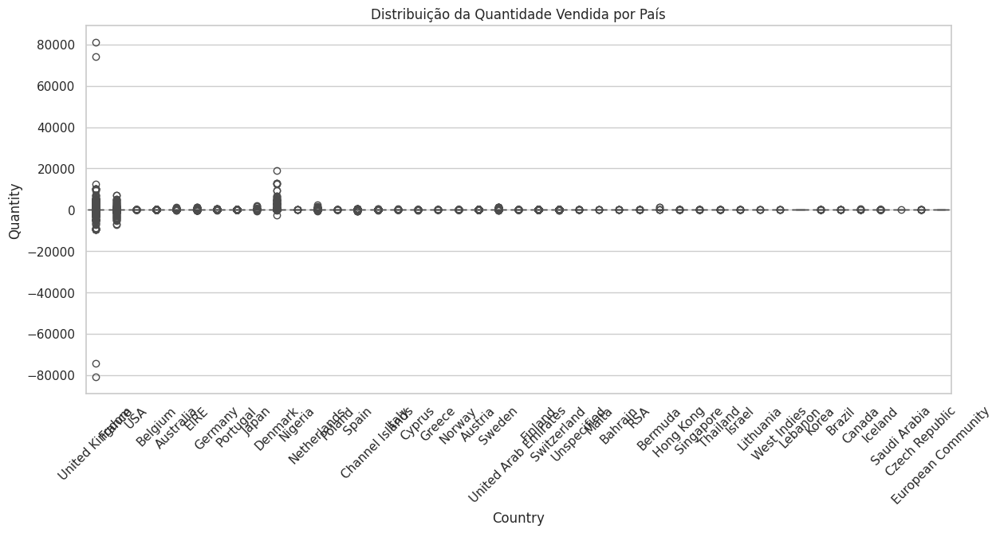

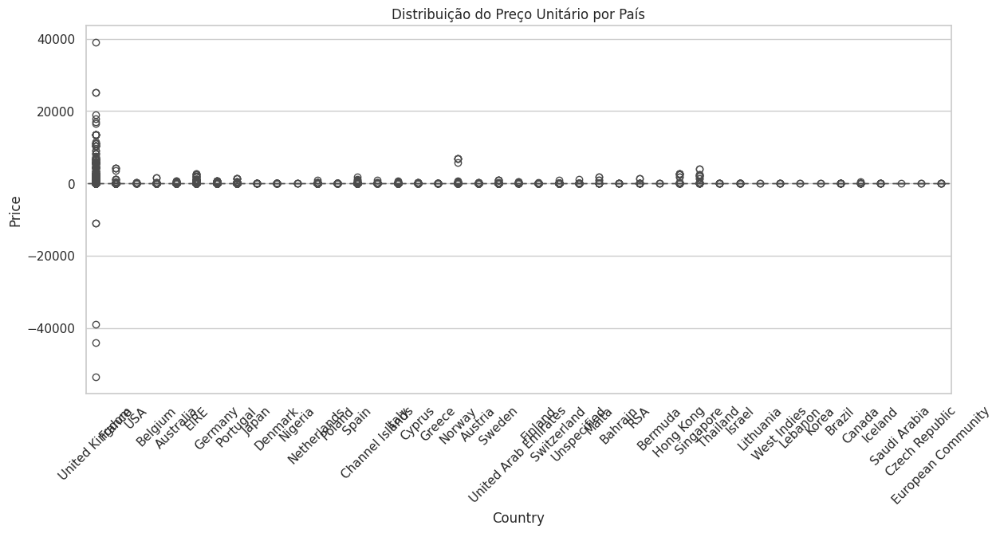

In [12]:
# 4. Exploração gráfica
plt.figure(figsize=(14, 6))
sns.boxplot(x="Country", y="Quantity", data=df)
plt.title("Distribuição da Quantidade Vendida por País")
plt.xticks(rotation=45)
plt.show()

plt.figure(figsize=(14, 6))
sns.boxplot(x="Country", y="Price", data=df)
plt.title("Distribuição do Preço Unitário por País")
plt.xticks(rotation=45)
plt.show()


In [13]:
print(f'Nos dados são comercializados cerca de {df['Description'].nunique()} produtos.')

Nos dados são comercializados cerca de 5698 produtos.


Maiores produtos comercializados.

In [18]:
df['Description'].value_counts().head(10)

Description
WHITE HANGING HEART T-LIGHT HOLDER    5918
REGENCY CAKESTAND 3 TIER              4412
JUMBO BAG RED RETROSPOT               3469
ASSORTED COLOUR BIRD ORNAMENT         2958
PARTY BUNTING                         2765
STRAWBERRY CERAMIC TRINKET BOX        2613
LUNCH BAG  BLACK SKULL.               2529
JUMBO STORAGE BAG SUKI                2434
HEART OF WICKER SMALL                 2319
JUMBO SHOPPER VINTAGE RED PAISLEY     2297
Name: count, dtype: int64

In [17]:
print(df[['Quantity', 'Price']].describe())

        Quantity      Price
count 1067371.00 1067371.00
mean        9.94       4.65
std       172.71     123.55
min    -80995.00  -53594.36
25%         1.00       1.25
50%         3.00       2.10
75%        10.00       4.15
max     80995.00   38970.00


In [19]:
print(df['Country'].value_counts())

Country
United Kingdom          981330
EIRE                     17866
Germany                  17624
France                   14330
Netherlands               5140
Spain                     3811
Switzerland               3189
Belgium                   3123
Portugal                  2620
Australia                 1913
Channel Islands           1664
Italy                     1534
Norway                    1455
Sweden                    1364
Cyprus                    1176
Finland                   1049
Austria                    938
Denmark                    817
Unspecified                756
Greece                     663
Japan                      582
Poland                     535
USA                        535
United Arab Emirates       500
Israel                     371
Hong Kong                  364
Singapore                  346
Malta                      299
Iceland                    253
Canada                     228
Lithuania                  189
RSA                        169


Média dos países que mais transacionam.

In [20]:
media_quantidade_preco = df.groupby('Country')[['Quantity', 'Price']].mean().reset_index()

print(media_quantidade_preco.sort_values(by='Quantity', ascending=False))

                 Country  Quantity  Price
10               Denmark    287.90   2.93
4                Bermuda     82.29   2.49
26           Netherlands     74.31   3.05
35                Sweden     64.42   6.39
21                 Japan     54.68   2.16
0              Australia     54.21   4.24
37              Thailand     33.58   3.00
33             Singapore     20.19  73.65
9         Czech Republic     19.73   2.94
17             Hong Kong     19.44  57.57
28                Norway     18.63  28.27
11                  EIRE     18.55   7.01
36           Switzerland     16.42   3.78
6                 Canada     16.04   4.64
24             Lithuania     15.65   2.62
19                Israel     14.78   3.57
13               Finland     13.65   4.99
39  United Arab Emirates     13.46   5.11
18               Iceland     12.99   2.55
14                France     12.91   4.69
15               Germany     12.74   3.83
7        Channel Islands     12.30   5.44
1                Austria     12.05

In [21]:
# 5. Verificar valores ausentes
print("\nResumo de valores ausentes por coluna:")
missing_data = df.isnull().sum()
missing_data = missing_data[missing_data > 0].sort_values(ascending=False)
print(missing_data)


Resumo de valores ausentes por coluna:
Customer ID    243007
Description      4382
dtype: int64


In [22]:
# 6. Estatísticas descritivas para variáveis numéricas
print("\nEstatísticas descritivas das variáveis numéricas:")
print(df.describe().transpose())


Estatísticas descritivas das variáveis numéricas:
                 count     mean     std       min      25%      50%      75%  \
Quantity    1067371.00     9.94  172.71 -80995.00     1.00     3.00    10.00   
Price       1067371.00     4.65  123.55 -53594.36     1.25     2.10     4.15   
Customer ID  824364.00 15324.64 1697.46  12346.00 13975.00 15255.00 16797.00   

                 max  
Quantity    80995.00  
Price       38970.00  
Customer ID 18287.00  


In [23]:
# 7. Listar variáveis categóricas
categorical_cols = df.select_dtypes(include=['object']).columns
print("\nVariáveis categóricas:")
print(categorical_cols)


Variáveis categóricas:
Index(['Invoice', 'StockCode', 'Description', 'InvoiceDate', 'Country'], dtype='object')


In [24]:
df.nunique().sort_values()

Country           43
Quantity        1057
Price           2807
StockCode       5305
Description     5698
Customer ID     5942
InvoiceDate    47635
Invoice        53628
dtype: int64

In [ ]:
saleprice_skewness = skew(df["Price"], bias=False)
print(f"Skewness de Price: {saleprice_skewness}")

Skewness de SalePrice: -69.16473385725452


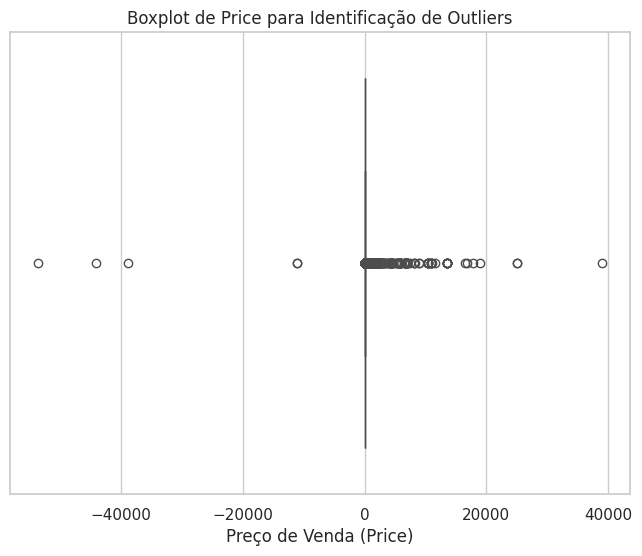

In [26]:
plt.figure(figsize=(8, 6))
sns.boxplot(x=df["Price"], color="orange")
plt.title("Boxplot de Price para Identificação de Outliers")
plt.xlabel("Preço de Venda (Price)")
plt.show()

In [27]:
print(df["Price"].describe())
print(df["Price"].quantile([0.95]))

count   1067371.00
mean          4.65
std         123.55
min      -53594.36
25%           1.25
50%           2.10
75%           4.15
max       38970.00
Name: Price, dtype: float64
0.95   9.95
Name: Price, dtype: float64


A variável `Price` possui 1.067.371 observações, com preço médio de 4.65. Desvio-padrão de  123,55, o que indica uma alta dispersão, sugerindo a presença de valores extremos (*outliers*). Com uma mediana (50%) de  2,10, sendo assim, metade dos produtos tem um preço igual ou menor que 2,10. O intervalo interquartil (IQR - 25% a 75%), encontra-se entre 1,25 e 4,15 . Ainda nota-se que 95% dos preços estão abaixo de 9.95.

Indícios de *outliers* podem ser observado ao se notar que o balor mínimo (min) é de -53.594,36, ou seja, um valor negativo, podendo ser objeto de devoluções (preços negativos) ou problemas na entrada de dados. No outro extremo temos o valor máximo (max) de 38.970,00 (Muito acima do percentil 95%), pode sugerir produtos premium ou até mesmo erro de precificação.

O desvio-padrão sendo (123.55) sugere que os preços variam bastante.

## 3. Seleção de Variáveis para ANOVA

Para a realização da análise de variância (ANOVA), selecionamos as variáveis Quantity, Country e Price como foco da investigação. Essa escolha se justifica pelos seguintes motivos:

`Quantity`: Representa a quantidade de produtos vendidos em cada transação. A análise da variação dessa métrica entre diferentes países permite identificar padrões de demanda e preferências regionais.

`Country`: Variável categórica fundamental para o agrupamento dos dados. O objetivo é avaliar se as médias de quantidade vendida e preço médio diferem significativamente entre os países.

`Price`: Mede o valor unitário dos produtos. A comparação das médias entre países possibilita verificar disparidades nos preços praticados, o que pode indicar diferenças de precificação ou estratégias comerciais adotadas em cada mercado.
A aplicação do teste ANOVA permitirá determinar se há diferenças estatisticamente significativas entre os países quanto às variáveis `Quantity` e + , auxiliando na identificação de tendências e oportunidades estratégicas no mercado varejista online.

In [28]:
df_anova = df[["Country", "Price", "Quantity"]].dropna()

In [29]:
print(missing_data)

Customer ID    243007
Description      4382
dtype: int64


In [30]:
df_anova.isnull().sum()

Country     0
Price       0
Quantity    0
dtype: int64

In [31]:
df_anova.columns

Index(['Country', 'Price', 'Quantity'], dtype='object')

## 4. ANOVA: Comparação de Preços Médios

In [33]:
df_anova

,Country,Price,Quantity
0,United Kingdom,6.95,12
1,United Kingdom,6.75,12
2,United Kingdom,6.75,12
3,United Kingdom,2.10,48
4,United Kingdom,1.25,24
...,...,...,...
1067366,France,2.10,6
1067367,France,4.15,4
1067368,France,4.15,4
1067369,France,4.95,3


In [32]:
from scipy.stats import f_oneway

# Teste para Quantidade
quantity_groups = [df['Quantity'][df['Country'] == country] for country in df['Country'].unique()]
f_statistic_quantity, p_value_quantity = f_oneway(*quantity_groups)

# Teste para Preço
price_groups = [df['Price'][df['Country'] == country] for country in df['Country'].unique()]
f_statistic_price, p_value_price = f_oneway(*price_groups)

print("Resultados ANOVA para Quantidade:")
print("Estatística F:", f_statistic_quantity)
print("P-valor:", p_value_quantity)

print("\nResultados ANOVA para Preço:")
print("Estatística F:", f_statistic_price)
print("P-valor:", p_value_price)

Resultados ANOVA para Quantidade:
Estatística F: 77.46534225726585
P-valor: 0.0

Resultados ANOVA para Preço:
Estatística F: 5.893433324083531
P-valor: 6.260090985019275e-31


In [36]:
# 3. Teste ANOVA para Quantidade
anova_quantity = ols('Quantity ~ C(Country)', data=df).fit()
result_quantity = sm.stats.anova_lm(anova_quantity, typ=2)
display(result_quantity)

# 3. Teste ANOVA para Preço
anova_price = ols('Price ~ C(Country)', data=df).fit()
result_price = sm.stats.anova_lm(anova_price, typ=2)
display(result_price)

,sum_sq,df,F,PR(>F)
C(Country),96753300.75,42.00,77.47,0.00
Residual,31740002622.33,1067328.00,NaN,NaN


,sum_sq,df,F,PR(>F)
C(Country),3777818.17,42.00,5.89,0.00
Residual,16290007691.24,1067328.00,NaN,NaN


**Quantidade**
-> Estatística F: 77,47
-> P-valor: 0,0

A estatística F alta (77,47) sugere que há uma grande variabilidade entre as médias de quantidade de produtos nos diferentes países em comparação com a variabilidade dentro de cada país. O p-valor de 0,0 (próximo de zero) indica que a probabilidade de obter uma estatística F tão alta (ou mais alta) se as médias de quantidade fossem realmente iguais em todos os países é extremamente baixa.
Portanto, rejeitamos a hipótese nula de que as médias de quantidade são iguais entre os países. Há evidências estatísticas muito fortes para afirmar que a quantidade média de produtos vendidos varia significativamente entre os países.


**Preço**
-> Estatística F: 5,89
-> P-valor: 6,26e-31 (6,26 x 10^-31)

A estatística F moderada (5,89) sugere que há alguma variabilidade entre as médias de preço dos produtos nos diferentes países, mas não tão grande quanto a variabilidade observada na quantidade. O p-valor extremamente baixo (6,26e-31) indica que a probabilidade de obter uma estatística F tão alta (ou mais alta) se as médias de preço fossem realmente iguais em todos os países é praticamente nula.
Portanto, rejeitamos a hipótese nula de que as médias de preço são iguais entre os países. Há evidências estatísticas muito fortes para afirmar que o preço médio dos produtos varia significativamente entre os países.

## 5. Validação dos Pressupostos
### 5.1 Normalidade
Testaremos a normalidade dos resíduos utilizando o teste de Shapiro-Wilk.

### 5.2 Homogeneidade das Variâncias
"Utilizaremos o teste de Levene para avaliar a homocedasticidade."

In [ ]:
anova_price = ols('Price ~ C(Country)', data=df_anova).fit()
anova_quantity = ols('Quantity ~ C(Country)', data=df_anova).fit()

residuals_price = anova_price.resid
residuals_quantity = anova_quantity.resid

shapiro_tests = {
    "Resíduos de Price": shapiro(residuals_price)[1],
    "Resíduos de Quantity": shapiro(residuals_quantity)[1]
}

levene_tests = {
    "Price por Country": levene(*[df_anova[df_anova["Country"] == country]["Price"] for country in df_anova["Country"].unique()]).pvalue,
    "Quantity por Country": levene(*[df_anova[df_anova["Country"] == country]["Quantity"] for country in df_anova["Country"].unique()]).pvalue
}

results = pd.DataFrame({
    "Teste de Normalidade (Shapiro-Wilk p-values)": shapiro_tests,
    "Teste de Homogeneidade (Levene p-values)": levene_tests
})

# Exibir os resultados
display(results)

,Teste de Normalidade (Shapiro-Wilk p-values),Teste de Homogeneidade (Levene p-values)
Resíduos de Price,0.00,NaN
Resíduos de Quantity,0.00,NaN
Price por Country,NaN,0.00
Quantity por Country,NaN,0.00


Como o p-valor do Shapiro-Wilk é 0.00, isso indica que os resíduos não seguem uma distribuição normal, isso viola um dos principais pressupostos da ANOVA.

Há indicios que apontam problema no cálculo do Teste de Levene `(NaN)`, sugere que houve um erro na construção do teste. POde haver grupos vazios ou com **valores extremos** nos dados de `Price` por `Country`, de fato constatamos isso na análise dos dados. O que impede o cálculo da estatística.

O p-valor de `Quantity` por `Country` é 0.00, indicando que as variâncias não são homogêneas. Isso viola outro pressuposto da ANOVA

Podemos (i) remover valores extremos (**outliers**) e ainda (ii) converter `Price` para uma escala logarítmica para estabilizar a variância. Depois disso, podemos rodar a ANOVA novamente com os valores transformados.

In [45]:
print(f'Para o item (i) será eliminado {df_anova.shape[0] - df_anova[df_anova["Price"] > 0].shape[0]} variaveis com valores negativos.')
print(f'Representa {((df_anova.shape[0] - df_anova[df_anova["Price"] > 0].shape[0]) / df_anova.shape[0]) * 100:.2f}% do dataset.')

Para o item (i) será eliminado 6207 variaveis com valores negativos.
Representa 0.58% do dataset.


In [47]:
df_anova_pressupostos = df_anova.copy()
df_anova_pressupostos = df_anova_pressupostos[df_anova_pressupostos["Price"] > 0]

Transformação Log

In [48]:
df_anova_pressupostos["Price"] = np.log1p(df_anova_pressupostos["Price"])
df_anova_pressupostos["Quantity"] = np.log1p(df_anova["Quantity"])
df_anova_pressupostos

,Country,Price,Quantity
0,United Kingdom,2.07,2.56
1,United Kingdom,2.05,2.56
2,United Kingdom,2.05,2.56
3,United Kingdom,1.13,3.89
4,United Kingdom,0.81,3.22
...,...,...,...
1067366,France,1.13,1.95
1067367,France,1.64,1.61
1067368,France,1.64,1.61
1067369,France,1.78,1.39


In [51]:
anova_price = ols('Price ~ C(Country)', data=df_anova_pressupostos).fit()
anova_quantity = ols('Quantity ~ C(Country)', data=df_anova_pressupostos).fit()

residuals_price = anova_price.resid
residuals_quantity = anova_quantity.resid

shapiro_tests = {
    "Resíduos de Price": shapiro(residuals_price)[1],
    "Resíduos de Quantity": shapiro(residuals_quantity)[1]
}

levene_tests = {
    "Price por Country": levene(*[df_anova_pressupostos[df_anova_pressupostos["Country"] == country]["Price"] for country in df_anova_pressupostos["Country"].unique()]).pvalue,
    "Quantity por Country": levene(*[df_anova_pressupostos[df_anova_pressupostos["Country"] == country]["Quantity"] for country in df_anova_pressupostos["Country"].unique()]).pvalue
}

results = pd.DataFrame({
    "Teste de Normalidade com LOG (Shapiro-Wilk p-values)": shapiro_tests,
    "Teste de Homogeneidade com LOG (Levene p-values)": levene_tests
})

# Exibir os resultados
display(results)

,Teste de Normalidade com LOG (Shapiro-Wilk p-values),Teste de Homogeneidade com LOG (Levene p-values)
Resíduos de Price,0.00,NaN
Resíduos de Quantity,1.00,NaN
Price por Country,NaN,0.00
Quantity por Country,NaN,NaN


A transformação logarítmica melhorou a normalidade dos resíduos da variável `Quantity`, tornando-a adequada para a ANOVA.

Os resíduos de `Price` ainda não seguem uma distribuição normal, sugerindo que mais ajustes podem ser necessários.

A homogeneidade de variâncias para `Price` ainda não foi alcançada, o que pode afetar a validade da ANOVA.

Teste não paramétrico

In [39]:
from scipy.stats import kruskal

# Kruskal-Wallis para Price agrupado por Country
kruskal_price = kruskal(*[df_anova[df_anova['Country'] == country]['Price'] for country in df_anova['Country'].unique()])

# Kruskal-Wallis para Quantity agrupado por Country
kruskal_quantity = kruskal(*[df_anova[df_anova['Country'] == country]['Quantity'] for country in df_anova['Country'].unique()])

# Exibindo os resultados
print("Resultados do Teste de Kruskal-Wallis:")
print(f"Price por Country: H-statistic = {kruskal_price.statistic:.4f}, p-value = {kruskal_price.pvalue:.4f}")
print(f"Quantity por Country: H-statistic = {kruskal_quantity.statistic:.4f}, p-value = {kruskal_quantity.pvalue:.4f}")

Resultados do Teste de Kruskal-Wallis:
Price por Country: H-statistic = 2061.4633, p-value = 0.0000
Quantity por Country: H-statistic = 46577.0281, p-value = 0.0000


In [52]:
df_anova_pressupostos_np = df_anova.copy()
df_anova_pressupostos_np[df_anova_pressupostos_np["Price"] > 0]

,Country,Price,Quantity
0,United Kingdom,6.95,12
1,United Kingdom,6.75,12
2,United Kingdom,6.75,12
3,United Kingdom,2.10,48
4,United Kingdom,1.25,24
...,...,...,...
1067366,France,2.10,6
1067367,France,4.15,4
1067368,France,4.15,4
1067369,France,4.95,3


In [53]:
# Kruskal-Wallis para Price agrupado por Country
kruskal_price = kruskal(*[df_anova_pressupostos_np[df_anova_pressupostos_np['Country'] == country]['Price'] for country in df_anova_pressupostos_np['Country'].unique()])

# Kruskal-Wallis para Quantity agrupado por Country
kruskal_quantity = kruskal(*[df_anova_pressupostos_np[df_anova_pressupostos_np['Country'] == country]['Quantity'] for country in df_anova_pressupostos_np['Country'].unique()])

# Exibindo os resultados
print("Resultados do Teste de Kruskal-Wallis:")
print(f"Price por Country: H-statistic = {kruskal_price.statistic:.4f}, p-value = {kruskal_price.pvalue:.4f}")
print(f"Quantity por Country: H-statistic = {kruskal_quantity.statistic:.4f}, p-value = {kruskal_quantity.pvalue:.4f}")

Resultados do Teste de Kruskal-Wallis:
Price por Country: H-statistic = 2061.4633, p-value = 0.0000
Quantity por Country: H-statistic = 46577.0281, p-value = 0.0000


## 6. Conclusões

Nesta atividade, investigamos a diferença nas médias de quantidade e preço dos produtos agrupados por países, utilizando ANOVA e, posteriormente, o Teste de Kruskal-Wallis, uma abordagem não paramétrica, devido à violação de pressupostos da ANOVA.

Durante a execução do **ANOVA**, a análise de variância indicou diferenças estatisticamente significativas entre os países tanto para `Price` (F = 5.89, p < 0.001) quanto para `Quantity` (F = 77.46, p < 0.001). No entanto, os pressupostos da ANOVA (normalidade e homocedasticidade) não foram atendidos, especialmente para `Price`, mesmo após a transformação logarítmica.

Partindo para uma abordagem não-paramétrica, usamos o Teste de Kruskal-Wallis, que confirmou que as distribuições de `Price` e `Quantity` diferem significativamente entre os países (p < 0.001).
Esse resultado reforça que há variação significativa nos padrões de preços e quantidades entre os países, o que pode ter implicações estratégicas para precificação e alocação de produtos.

Embora tenhamos identificado diferenças estatísticas entre os países, aprofundar essa análise pode trazer insights mais estratégicos. Por exemplo:

1. Teste Post-hoc -> testes de comparações múltiplas para identificar quais países apresentam diferenças significativas entre si.

1. Modelos Preditivos -> modelos de regressão para entender quais fatores explicam as diferenças de preço e quantidade, inclusive quais variáveis a mais ajudariam a responder.

1. Segmentação de Mercado -> técnicas de clustering para agrupar países com comportamentos de compra similares, auxiliando estratégias comerciais.

Com essa base, podemos continuar aprimorando a análise, garantindo que os resultados reflitam não apenas estatísticas, mas também impactos reais no negócio

# Questão 4

## 1. Compreensão Problema de Negócio

O risco de crédito é uma das principais preocupações do setor bancário e financeiro. Ele se refere à probabilidade de um cliente não cumprir suas obrigações financeiras, resultando em inadimplência e potenciais perdas para as instituições financeiras. Para mitigar esse risco, bancos e outras entidades financeiras utilizam modelos preditivos que analisam o comportamento de clientes e identificam padrões que indicam a probabilidade de um indivíduo ser um bom ou mau pagador, ou no jargão financeiro, o cliente dar ou não *default*.

A importância da modelagem do risco de crédito se traduz em tomadas de decisão mais eficientes e baseadas em dados, ajudando a determinar limites de crédito adequados ao cliente, ainda suavizar as estratégias de recuperação de crédito. Além disso, a correta precificação do risco contribui para a sustentabilidade do mercado de crédito, evitando alta exposição à alavancagens financeiras (que podem levar a crises financeiras catastróficas) bem como, restrições muito rígidas ao crédito (que limitam a fluidez do mercado e desacelera o crescimento econômico).

Neste estudo, utilizaremos um conjunto de dados reais de risco de crédito para desenvolver modelos preditivos capazes de classificar clientes entre bons e maus pagadores. Exploraremos as principais variáveis que influenciam essa decisão, aplicaremos técnicas de modelagem estatística e aprendizado de máquina e analisaremos as implicações dos resultados para a gestão do risco de crédito.

Avaliar o risco de concessão de crédito a clientes de IF. Problemas do tipo classificação, faremos previsão de classes. Os dados possui uma serie de informação e gera como saída se **Posso conceder crédito** ou **não**. Problema de aprendizagem supervisionada.Modelo vai receber dados de entrada e saída, aprenderá os coeficientes que melhor explica a relação entre Var_target/Label e as Var_Explanatória. Com este modelo treinda será capaz de prever novas classificação de concessão de crédito.

### 1.1 Dicionário dados

| Variável          | Tipo da Variável    | Descrição                                                                                                                                                                                                 |
|-------------------|---------------------|----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------|
| checking_status   | Categórica Ordinal  | Situação da conta corrente do cliente.  Indica o nível de saldo disponível na conta corrente. Geralmente, um saldo menor ou "sem conta" pode indicar maior risco.                                        |
| duration          | Numérica Contínua   | Duração do crédito em meses.  Tempo total que o cliente terá para pagar o empréstimo. Prazos mais longos podem aumentar o risco devido a incertezas futuras.                                             |
| credit_history    | Categórica Ordinal  | Histórico de crédito do cliente.  Avalia o comportamento de pagamento em créditos anteriores. Um histórico problemático (crédito em atraso, crítico) sinaliza maior risco.                               |
| purpose           | Categórica Nominal  | Propósito do crédito.  Indica para que o cliente pretende usar o dinheiro do empréstimo. Alguns propósitos (ex: carro novo, casa) podem ser vistos como menos arriscados que outros (ex: negócios, "outros"). |
| credit_amount     | Numérica Contínua   | Valor do crédito solicitado. Montante total do empréstimo.  Valores muito altos em relação à renda do cliente podem aumentar o risco de inadimplência.                                                   |
| savings_status    | Categórica Ordinal  | Reserva financeira do cliente.  Indica o nível de poupança ou reserva financeira. Mais poupança geralmente indica menor risco.                                                                         |
| employment        | Categórica Ordinal  | Tempo de emprego atual.  Indica a estabilidade profissional do cliente. Empregos mais longos geralmente indicam menor risco.                                                                             |
| installment_commitment | Numérica Discreta | Taxa de comprometimento da parcela. Percentual da renda disponível do cliente que será destinada ao pagamento da parcela do crédito. Taxas muito altas (próximas de 4, que pode representar uma taxa alta em escala ordinal) indicam maior dificuldade de pagamento. |
| personal_status   | Categórica Nominal  | Estado civil e gênero.  Pode influenciar o risco de crédito, embora o impacto seja menos direto e possa estar ligado a fatores socioeconômicos associados a cada categoria.                              |
| other_parties     | Categórica Nominal  | Outras partes envolvidas no crédito. Indica se há avalistas ou coobrigados).                                                    |
| residence_since   | Numérica Discreta   | Tempo de residência atual em anos.  Estabilidade residencial pode indicar maior estabilidade geral do cliente, sugerindo menor risco.                                                                    |
| property_magnitude | Categórica Ordinal | Bens móveis.  Indica o tipo de propriedade que o cliente possui (se possui alguma). Propriedades de maior valor (ex: real estate - imóveis) podem ser vistas como garantia, reduzindo o risco para o credor. |
| age               | Numérica Contínua   | Idade do cliente em anos. A idade pode estar correlacionada com risco de crédito de maneiras complexas. Clientes muito jovens podem ter menos histórico, enquanto clientes mais velhos podem ter mais estabilidade. |
| other_payment_plans | Categórica Nominal | Outros planos de pagamento.  Indica se o cliente possui outros compromissos financeiros (ex: outras dívidas, planos de pagamento parcelados).  Muitos planos podem sobrecarregar o orçamento e aumentar o risco. |
| housing           | Categórica Nominal  | Tipo de moradia.  Indica se o cliente é proprietário, aluga ou mora de favor. Ser proprietário pode indicar maior estabilidade financeira.                                                              |
| existing_credits  | Numérica Discreta   | Número de créditos existentes.  Quantidade de outros créditos que o cliente já possui. Muitos créditos podem indicar alta alavancagem e maior risco.                                                    |
| job               | Categórica Ordinal  | Tipo de emprego.  Indica a qualificação profissional e nível hierárquico do emprego. Empregos de maior qualificação (ex: "high qualif/self emp/mgmt") geralmente indicam maior estabilidade e menor risco. |
| num_dependents    | Numérica Discreta   | Número de dependentes. Quantidade de pessoas que dependem financeiramente do cliente.  Mais dependentes podem aumentar a pressão sobre o orçamento familiar e potencialmente aumentar o risco.          |
| own_telephone     | Categórica Binária  | Possui telefone registrado.  Em datasets mais antigos, a posse de telefone poderia ser um indicador de estabilidade e acessibilidade do cliente. Hoje em dia, pode ter menos relevância.                |
| foreign_worker    | Categórica Binária  | Trabalhador estrangeiro.  Pode ser um fator de risco em alguns contextos (ex: instabilidade de residência, barreiras linguísticas/culturais em certos casos). No entanto, generalizações sobre risco baseadas em nacionalidade são problemáticas e podem ser discriminatórias. |
| class             | Categórica Binária  | Classe de risco de crédito (Variável Alvo).  Indica se o cliente é considerado um "bom" ou "mau" pagador, com base em dados históricos. É a variável que o modelo de machine learning tentará prever.   |

## 2. Coleta de Dados

Para este projeto de *machine learning*, utilizaremos o conjunto de dados **credit_risk_customers**, disponível no [Kaggle](https://www.kaggle.com/datasets/ppb00x/credit-risk-customers).

Este conjunto de dados classifica pessoas descritas por um conjunto de atributos como bons ou maus riscos de crédito. As variáveis presentes podem ser classificadas nos seguintes grupos:

- **Informações do Cliente**: variáveis relacionadas ao perfil pessoal e histórico do cliente.
    - `age` → Idade do cliente
    - `personal_status` → Estado civil e status pessoal
    - `job` → Tipo de emprego
    - `num_dependents` → Número de dependentes
    - `own_telephone` → Possui telefone próprio (Sim/Não)
    - `foreign_worker` → Se é trabalhador estrangeiro (Sim/Não)
    - `property_magnitude` → Tipo de propriedade que o cliente possui (ex.: imóvel, carro, seguro de vida, nenhum)
    - `housing` → Tipo de moradia (ex.: próprio, alugado, gratuito)
    - `residence_since` → Tempo de residência no endereço atual
    - `employment` → Tempo de emprego atual
    - `class` → Indica se o cliente é "good" (bom pagador) ou "bad" (mau pagador) **variável target**

- **Informações sobre histórico financeiro**: variáveis relacionadas ao histórico de crédito e situação financeira do cliente
    - `checking_status` → Status da conta corrente (ex.: saldo negativo, saldo entre faixas específicas, sem conta)
    - `savings_status` → Status da poupança (ex.: sem economia, valores entre faixas específicas)
    - `credit_history` → Histórico de crédito (ex.: pagamentos anteriores, inadimplência, novos créditos)
    - `existing_credits` → Quantidade de créditos existentes
    - `other_payment_plans` → Outros planos de pagamento existentes (ex.: banco, lojas, nenhum)

- **Informações sobre características do crédito tomado**: variáveis que descrevem a solicitação de crédito feita pelo cliente.
    - `credit_amount` → Valor do crédito solicitado
    - `duration` → Duração do crédito solicitado (em meses)
    - `installment_commitment` → Percentual da renda comprometida com a parcela
    - `purpose` → Finalidade do crédito (ex.: carro, eletrodoméstico, negócio)
    - `other_parties` → Outros co-participantes na solicitação de crédito (ex.: cônjuge, avalista, nenhum)
    - `days_in_waiting_list` → Tempo que o cliente aguardou na fila para análise (se aplicável)
    - `booking_changes` → Alterações feitas na solicitação de crédito

- **Informações financeiras**:
  - `adr`: Taxa média diária aplicada à reserva.
  - `required_car_parking_spaces`: Número de vagas de estacionamento requeridas.
  - `total_of_special_requests`: Número de pedidos especiais feitos pelo hóspede.

Essas informações nos permitirão identificar padrões e fatores que influenciam a probabilidade de *default* de um cliente, auxiliando na construção de um modelo preditivo eficaz.

**Dicas:**  
1. Observar as extensão do arquivo dataSet.
2. Verificar os acessos aos dataSet (LGPD).
3. "Timeframe" dos dados (desde quando tem-se os dados).
4. Valores Missing (será substituido por default ou outro valor - média, por exemplo).
5. Cabeçalho (header=T), caso False, irá indicar cabeçalho.
6. Dados possuem algum comentário.
7. Possui delimitador os dados.

### 2.1 Carga dados

In [184]:
dados = pd.read_csv('/home/buso/mestrado/aedi-ppca/dados/credit_customers.csv')
print('dados: (Linhas,Colunas)',dados.shape)

dados: (Linhas,Colunas) (1000, 21)


## 3. Análise Exploratória

### 3.1 Visão Geral dataSet
Nesta estapa estamos interessados em entender melhor a pergunta ***"Quais tipos de dados tem no nosso dataSet?"***
* Tipo Objeto que estamos trabalhando
* Tipos Dados
* Shape - Dimensionalidade
* Índices
* Descrição dos dados

In [185]:
def visaogeral(df, mensagem):
    print(f'{mensagem}:\n')
    print("Qtd Observações:", df.shape[0])
    print("\nQtd Atributos:", df.shape[1])
    print("\nAtributos:")
    print(df.columns.values)
    # print(df.columns.tolist())
    print("\nQtd Valores missing:", df.isnull().sum().values.sum())
    print("\nValores Unicos:")
    print(df.nunique().sort_values(ascending=True))

In [186]:
visaogeral(dados,'Visão Geral dataSet treino')

Visão Geral dataSet treino:

Qtd Observações: 1000

Qtd Atributos: 21

Atributos:
['checking_status' 'duration' 'credit_history' 'purpose' 'credit_amount'
 'savings_status' 'employment' 'installment_commitment' 'personal_status'
 'other_parties' 'residence_since' 'property_magnitude' 'age'
 'other_payment_plans' 'housing' 'existing_credits' 'job' 'num_dependents'
 'own_telephone' 'foreign_worker' 'class']

Qtd Valores missing: 0

Valores Unicos:
class                       2
own_telephone               2
num_dependents              2
foreign_worker              2
housing                     3
other_payment_plans         3
other_parties               3
job                         4
existing_credits            4
property_magnitude          4
checking_status             4
installment_commitment      4
personal_status             4
residence_since             4
employment                  5
savings_status              5
credit_history              5
purpose                    10
duration  

O conjunto de dados contém 1.000 observações e 21 atributos, sem valores ausentes (missing values). Os atributos representam diversas características que influenciam a classificação de clientes como bons ou maus pagadores de crédito. A seguir, categorizamos os atributos de acordo com sua natureza:

Atributos quantitativos: As features duration, age e credit_amount possuem valores numéricos, podendo ser contínuos ou discretos.

Atributos categóricos: As demais variáveis possuem natureza categórica, representando diferentes classificações e características qualitativas. Para utilizá-las adequadamente nos modelos de Machine Learning, será necessário aplicar técnicas de pré-processamento, como codificação categórica.

Nosso objetivo é avaliar se a estrutura atual dos dados reflete corretamente a informação essencial de cada variável. A correta combinação de atributos categóricos e quantitativos desempenha um papel crucial na construção de um modelo eficiente, garantindo que ele consiga capturar os principais fatores que influenciam a probabilidade de inadimplência (default) de um cliente.

In [187]:
dados.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 21 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   checking_status         1000 non-null   object 
 1   duration                1000 non-null   float64
 2   credit_history          1000 non-null   object 
 3   purpose                 1000 non-null   object 
 4   credit_amount           1000 non-null   float64
 5   savings_status          1000 non-null   object 
 6   employment              1000 non-null   object 
 7   installment_commitment  1000 non-null   float64
 8   personal_status         1000 non-null   object 
 9   other_parties           1000 non-null   object 
 10  residence_since         1000 non-null   float64
 11  property_magnitude      1000 non-null   object 
 12  age                     1000 non-null   float64
 13  other_payment_plans     1000 non-null   object 
 14  housing                 1000 non-null   o

A análise exploratória realizada proporcionou uma **compreensão inicial** sobre a estrutura e qualidade do conjunto de dados. O dataset contém **mil registros** de clientes de uma instiruição financeira, descrevendo características e informações, para indicar se aquele vetor de informação deu *default* ou não.

A inspeção das variáveis revelou a presença de **atributos categóricos**, exigindo a aplicação de técnicas de **codificação de variáveis**, como **One-Hot Encoding**, para possibilitar sua utilização em modelos de *Machine Learning* baseados em algoritmos que requerem representações numéricas.

Outro aspecto positivo é que o dataset **não apresenta valores ausentes** nesta fase inicial. No entanto, é importante ressaltar que, durante o processo de engenharia de atributos (*feature engineering*) e transformação de variáveis, podem surgir valores nulos em decorrência de operações como discretização, normalização ou criação de novas variáveis.

Portanto, será essencial **monitorar e tratar** esses valores ausentes de maneira adequada para garantir a **qualidade e integridade dos dados**, assegurando um bom desempenho do modelo preditivo.

**TRADE-OFFs da Ciência de Dados e o Dilema Viés-Variância**

No desenvolvimento de modelos de *Machine Learning*, é fundamental equilibrar **quantidade de dados**, **dimensionalidade** e **tempo de treinamento**, garantindo um modelo eficiente e generalizável. Esse processo envolve decisões estratégicas para evitar problemas como **underfitting** e **overfitting**, além de considerar o **dilema viés-variância**.

**Tamanho do Conjunto de Dados**

Se o número de **observações** no conjunto de dados for **muito grande**, o treinamento pode ser **computacionalmente custoso**, exigindo técnicas como **amostragem representativa**, **processamento distribuído** (ex.: Spark, Dask) ou **redução de dimensionalidade** (ex.: PCA). Por outro lado, um número **muito pequeno** de registros pode levar ao **underfitting**, onde o modelo não consegue capturar padrões relevantes e apresenta baixa capacidade preditiva.

**Dimensionalidade e Seleção de Features**

Muitas **colunas/atributos** podem gerar problemas de **alta dimensionalidade**, dificultando a modelagem e aumentando o risco de **overfitting**, quando o modelo se ajusta excessivamente aos dados de treino e perde **capacidade de generalização**. Para mitigar esse problema, técnicas como **seleção de variáveis** (ex.: *feature selection*) e **redução de dimensionalidade** (ex.: PCA, *Autoencoders*) são recomendadas.

**O Dilema Viés-Variância**

O dilema **viés-variância** descreve o equilíbrio entre **simplicidade** e **complexidade** do modelo:

- **Viés alto (underfitting)**: O modelo é muito simples e não captura os padrões dos dados adequadamente, erra muito ou tudo.
- **Variância alta (overfitting)**: O modelo é muito complexo e se ajusta excessivamente aos dados de treino, resultando em baixa generalização.

A solução ideal envolve encontrar um meio-termo, onde o modelo **aprende bem os padrões dos dados sem se tornar excessivamente específico**.

**Divisão de Dados e Validação**

A prática recomendada é dividir o conjunto de dados em:
- **Treino (70%)**: Para ensinar o modelo.
- **Teste (30%)**: Para avaliar a performance em dados novos.
- **Validação cruzada**: Para evitar dependência de uma única divisão dos dados e garantir que o modelo tenha **boa generalização**.

**E então?**

Não existe uma solução única para esses desafios, e cada problema exige um equilíbrio entre **quantidade de dados**, **dimensionalidade**, **tempo de treinamento** e **capacidade de generalização**. Estratégias como **seleção de variáveis, validação cruzada e ajuste de hiperparâmetros** são essenciais para otimizar o modelo e garantir **desempenho robusto e confiável**.

In [188]:
# Visualizando as primeiras linhas
dados.head()

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
0,<0,6.00,critical/other existing credit,radio/tv,1169.00,no known savings,>=7,4.00,male single,none,...,real estate,67.00,none,own,2.00,skilled,1.00,yes,yes,good
1,0<=X<200,48.00,existing paid,radio/tv,5951.00,<100,1<=X<4,2.00,female div/dep/mar,none,...,real estate,22.00,none,own,1.00,skilled,1.00,none,yes,bad
2,no checking,12.00,critical/other existing credit,education,2096.00,<100,4<=X<7,2.00,male single,none,...,real estate,49.00,none,own,1.00,unskilled resident,2.00,none,yes,good
3,<0,42.00,existing paid,furniture/equipment,7882.00,<100,4<=X<7,2.00,male single,guarantor,...,life insurance,45.00,none,for free,1.00,skilled,2.00,none,yes,good
4,<0,24.00,delayed previously,new car,4870.00,<100,1<=X<4,3.00,male single,none,...,no known property,53.00,none,for free,2.00,skilled,2.00,none,yes,bad


In [189]:
# Observando os dados finais do dataSet
dados.tail()

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
995,no checking,12.00,existing paid,furniture/equipment,1736.00,<100,4<=X<7,3.00,female div/dep/mar,none,...,real estate,31.00,none,own,1.00,unskilled resident,1.00,none,yes,good
996,<0,30.00,existing paid,used car,3857.00,<100,1<=X<4,4.00,male div/sep,none,...,life insurance,40.00,none,own,1.00,high qualif/self emp/mgmt,1.00,yes,yes,good
997,no checking,12.00,existing paid,radio/tv,804.00,<100,>=7,4.00,male single,none,...,car,38.00,none,own,1.00,skilled,1.00,none,yes,good
998,<0,45.00,existing paid,radio/tv,1845.00,<100,1<=X<4,4.00,male single,none,...,no known property,23.00,none,for free,1.00,skilled,1.00,yes,yes,bad
999,0<=X<200,45.00,critical/other existing credit,used car,4576.00,100<=X<500,unemployed,3.00,male single,none,...,car,27.00,none,own,1.00,skilled,1.00,none,yes,good


Relembrando o shape dos dados:

In [190]:
print('Os dados possuem {:.2f} linhas e {} colunas'.format(dados.shape[0], dados.shape[1]))

Os dados possuem 1000.00 linhas e 21 colunas


In [191]:
# checando índice (endereço de cada obs) e sua distribuição
dados.index

RangeIndex(start=0, stop=1000, step=1)

In [192]:
# checando os nomes das colunas
dados.columns

Index(['checking_status', 'duration', 'credit_history', 'purpose',
       'credit_amount', 'savings_status', 'employment',
       'installment_commitment', 'personal_status', 'other_parties',
       'residence_since', 'property_magnitude', 'age', 'other_payment_plans',
       'housing', 'existing_credits', 'job', 'num_dependents', 'own_telephone',
       'foreign_worker', 'class'],
      dtype='object')

#### 3.1.1 Variáveis Explicatórias e Variável Alvo

Para a construção do modelo preditivo, é fundamental separar as variáveis do conjunto de dados em dois grupos distintos:

- **Variável Alvo (`y`)**: Representa o resultado que desejamos prever. No contexto deste estudo, a variável alvo é a **`class`**, que indica se o cliente é um bom pagador (**good**) ou mal pagador (**bad**).

- **Variáveis Explicatórias (`X`)**: São as demais variáveis que contêm informações relevantes, que explicam, ou ajuda a explicar, o comportamento que queromos analisar. Elas serão utilizadas como **fatores preditivos** para estimar a probabilidade do *default*. Antes do treinamento, é comum excluir variáveis que não apresentarem valor preditivo.

A separação correta entre **`X`** e **`y`** é essencial para garantir que o modelo aprenda a partir de variáveis relevantes e seja capaz de realizar previsões precisas sobre a saída ou permanência dos clientes.

In [193]:
dados.head()

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
0,<0,6.00,critical/other existing credit,radio/tv,1169.00,no known savings,>=7,4.00,male single,none,...,real estate,67.00,none,own,2.00,skilled,1.00,yes,yes,good
1,0<=X<200,48.00,existing paid,radio/tv,5951.00,<100,1<=X<4,2.00,female div/dep/mar,none,...,real estate,22.00,none,own,1.00,skilled,1.00,none,yes,bad
2,no checking,12.00,critical/other existing credit,education,2096.00,<100,4<=X<7,2.00,male single,none,...,real estate,49.00,none,own,1.00,unskilled resident,2.00,none,yes,good
3,<0,42.00,existing paid,furniture/equipment,7882.00,<100,4<=X<7,2.00,male single,guarantor,...,life insurance,45.00,none,for free,1.00,skilled,2.00,none,yes,good
4,<0,24.00,delayed previously,new car,4870.00,<100,1<=X<4,3.00,male single,none,...,no known property,53.00,none,for free,2.00,skilled,2.00,none,yes,bad


In [194]:
X= dados.drop(columns = 'class', axis=1)
Y= pd.DataFrame(dados['class'])
print('DataSet original com {} atributos e {} observações'.format(dados.shape[1], dados.shape[0]))
print('As variáveis independentes com {} atributos e {} observações'.format(X.shape[1], X.shape[0]))
print('A variável dependente - iremos prever com {} atributo e {} observações'.format(Y.shape[1], Y.shape[0]))

DataSet original com 21 atributos e 1000 observações
As variáveis independentes com 20 atributos e 1000 observações
A variável dependente - iremos prever com 1 atributo e 1000 observações


In [195]:
X.shape

(1000, 20)

In [196]:
Y

,class
0,good
1,bad
2,good
3,good
4,bad
...,...
995,good
996,good
997,good
998,bad


#### 3.1.2 Variável Alvo

A **variável alvo** deste estudo é o atributo **`class`**, que indica se o cliente deu *default* ou não na instituição financeiro (IF). Essa variável é categórica binária e representa o resultado que o modelo de machine learning deve prever. Seus valores são definidos da seguinte forma:

- **good** → O cliente **é** um bom pagador.
- **bad**  → O cliente **nã é** um bom pagador.

Observerve que o valor desse atributo está no formato **textual**, jpa indicando que teremos que realizar pré-processamento antes de modelar!

#####  3.1.2.1  Amplitude

In [197]:
# por ser classe max=1 min=0 (Classificação)
Y.describe()

,class
count,1000
unique,2
top,good
freq,700


In [198]:
Y.value_counts()

class
good     700
bad      300
Name: count, dtype: int64

Observando os valores únicos da variável **`class`**, confirmamos que se trata de uma **variável categórica binária**, com duas categorias distintas:

- **good** → O cliente **é** um bom pagador.
- **bad**  → O cliente **não é** um bom pagador.

Dessa forma, estamos diante de um problema de **aprendizado supervisionado** do tipo **classificação**, no qual o objetivo é prever a probabilidade de um cliente deixar ou não a instituição financeira.

Para essa tarefa, utilizaremos um **modelo classificador**, que será treinado para identificar padrões de comportamento associados nosso problema.

##### 3.1.2.2 Balanceamento dos Dados

Em problemas de **classificação**, é frequente encontrar conjuntos de dados com **classes desbalanceadas**, onde uma das classes apresenta um número de registros significativamente maior do que a outra. Esse desequilíbrio pode comprometer o desempenho do modelo, tornando-o **tendencioso** para a classe majoritária e dificultando a correta identificação da classe minoritária.

O **balanceamento das classes** é um dos **pressupostos fundamentais** a serem considerados na construção de modelos de **machine learning**. Caso não seja tratado adequadamente, o modelo pode apresentar baixa capacidade de prever eventos menos frequentes. Por isso, é essencial adotar estratégias para equilibrar as classes durante o pré-processamento, garantindo previsões mais precisas e confiáveis.

In [199]:
dados['class'].value_counts()   

class
good    700
bad     300
Name: count, dtype: int64

In [200]:
balData = pd.DataFrame(dados['class'].value_counts())
balData.rename(columns={'count':'quantidade'}, inplace=True)

In [201]:
balData['% total'] = round(100*balData['quantidade']/dados.shape[0], 2)
print(balData)
print("\nObserva-se que {:.1f}% do dataSet não deram default".format((dados.groupby('class').size()[1] / dados.shape[0])*100))
print("Enquanto que {:.1f}% dos dados deram default a IF.".format((dados.groupby('class').size()[0] / dados.shape[0])*100))

       quantidade  % total
class                     
good          700    70.00
bad           300    30.00

Observa-se que 70.0% do dataSet não deram default
Enquanto que 30.0% dos dados deram default a IF.


No presente estudo, observamos que a variável alvo, class, apresenta um desbalanceamento leve.  Embora exista uma diferença na proporção entre as classes "bom pagador" e "mau pagador", a princípio, não se faz necessária a aplicação imediata de técnicas de balanceamento.  A prioridade será avaliar o impacto deste desbalanceamento no desempenho dos modelos de machine learning antes de implementar qualquer ajuste.

Caso seja confirmado um impacto negativo significativo, as principais técnicas de balanceamento de classes a serem consideradas incluem:

**Oversampling**:  Esta técnica visa equilibrar as classes através do aumento da representatividade da classe minoritária. Isso pode ser feito replicando registros existentes da classe minoritária ou, de forma mais sofisticada, gerando novas amostras sintéticas. Uma das abordagens mais populares de oversampling sintético é o SMOTE (Synthetic Minority Over-sampling Technique). O SMOTE cria novas instâncias minoritárias através da interpolação entre exemplos minoritários vizinhos, expandindo o espaço de características da classe minoritária de maneira inteligente.

**Undersampling**:  Em contraste com o oversampling, o undersampling busca o equilíbrio reduzindo a representatividade da classe majoritária.  Isso é alcançado através da eliminação aleatória ou criteriosa de registros da classe majoritária.  Embora o undersampling possa acelerar o processo de treinamento do modelo, ele apresenta o risco de descartar informações potencialmente relevantes contidas nos registros da classe majoritária que foram removidos.

A decisão final sobre a necessidade e qual técnica de balanceamento aplicar será estritamente baseada em evidências empíricas.  Se a avaliação do modelo indicar um viés excessivo em favor da classe majoritária, manifestado por uma performance insatisfatória na identificação de maus pagadores, as técnicas de balanceamento serão reavaliadas e aplicadas para mitigar este viés e otimizar a capacidade preditiva do modelo para ambas as classes.

#####  3.1.2.3  Plots Variável Alvo

In [202]:
sns.set_theme(style='darkgrid')
sns.set_palette("hls", 3)

       quantidade  % total
class                     
good          700    70.00
bad           300    30.00


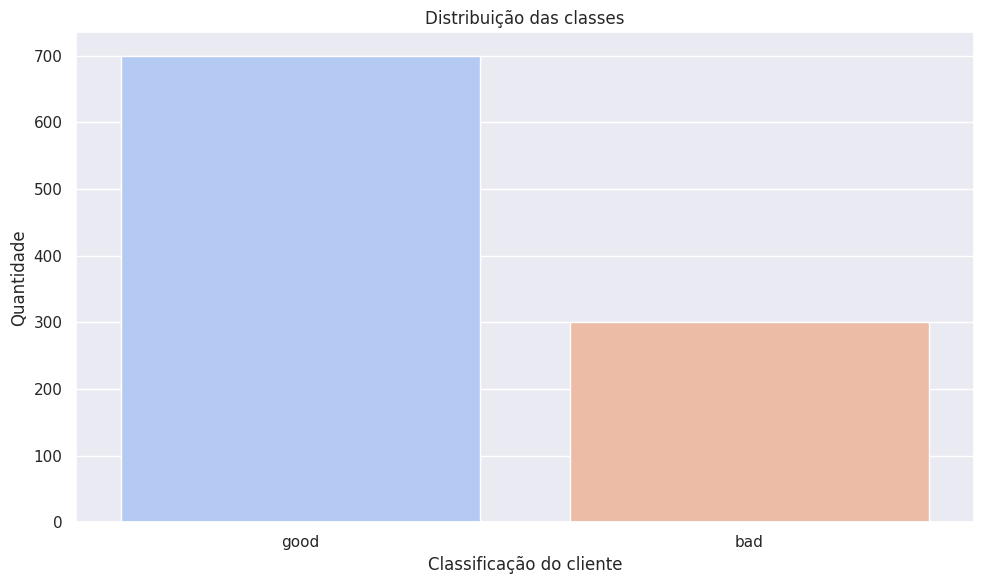

In [203]:
print(balData)
default_plot = sns.countplot(data=dados, x='class', order=dados['class'].value_counts().index, hue= 'class', palette='coolwarm')

plt.title('Distribuição das classes')
plt.ylabel('Quantidade')
plt.xlabel('Classificação do cliente')

plt.tight_layout()
plt.show()

#####  3.1.2.4  Relações com a variável alvo

In [204]:
dados.columns   

Index(['checking_status', 'duration', 'credit_history', 'purpose',
       'credit_amount', 'savings_status', 'employment',
       'installment_commitment', 'personal_status', 'other_parties',
       'residence_since', 'property_magnitude', 'age', 'other_payment_plans',
       'housing', 'existing_credits', 'job', 'num_dependents', 'own_telephone',
       'foreign_worker', 'class'],
      dtype='object')

In [205]:
dados.groupby(['class'])['age'].agg([np.mean,np.std])

,mean,std
class,,
bad,33.96,11.22
good,36.22,11.38


In [206]:
dados.pivot_table(['age', 'credit_amount', 'duration'],
               ['class'], aggfunc='mean')

,age,credit_amount,duration
class,,,
bad,33.96,3938.13,24.86
good,36.22,2985.46,19.21


#### 3.1.3 Preditores Categóricos

Durante a análise exploratória, identificamos que o conjunto de dados contém variáveis **categóricas** que são aquelas que representam **categorias** seja elas nominais ou ordinais. Elas auxiliam para mapear o entender o evento que estamos analisando.

In [207]:
x_categoricos =  dados.select_dtypes(include=['object'])
x_categoricos['class'] = dados['class']
x_categoricos.head()

,checking_status,credit_history,purpose,savings_status,employment,personal_status,other_parties,property_magnitude,other_payment_plans,housing,job,own_telephone,foreign_worker,class
0,<0,critical/other existing credit,radio/tv,no known savings,>=7,male single,none,real estate,none,own,skilled,yes,yes,good
1,0<=X<200,existing paid,radio/tv,<100,1<=X<4,female div/dep/mar,none,real estate,none,own,skilled,none,yes,bad
2,no checking,critical/other existing credit,education,<100,4<=X<7,male single,none,real estate,none,own,unskilled resident,none,yes,good
3,<0,existing paid,furniture/equipment,<100,4<=X<7,male single,guarantor,life insurance,none,for free,skilled,none,yes,good
4,<0,delayed previously,new car,<100,1<=X<4,male single,none,no known property,none,for free,skilled,none,yes,bad


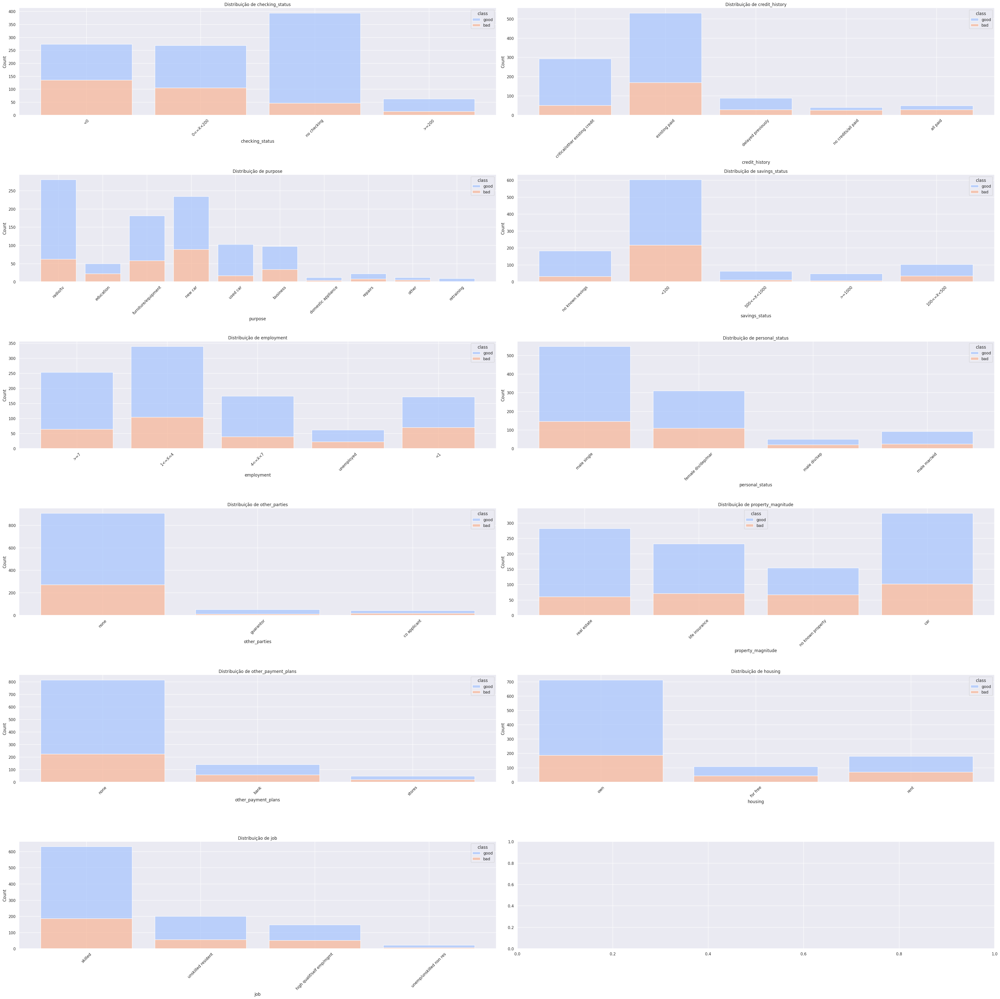

In [208]:
fig, axes = plt.subplots(6, 2, figsize=(40, 40))
axes = axes.flatten()
for i, var in enumerate(list(x_categoricos.columns[:-3])):
    sns.histplot(dados, x=var, hue="class", multiple="stack", shrink=0.8, ax=axes[i], palette='coolwarm')
    #sns.countplot(data=dados, x=var, order=dados[var].value_counts().index, hue='class', ax=axes[i], palette= 'coolwarm')
    axes[i].set_title(f"Distribuição de {var}")
    axes[i].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

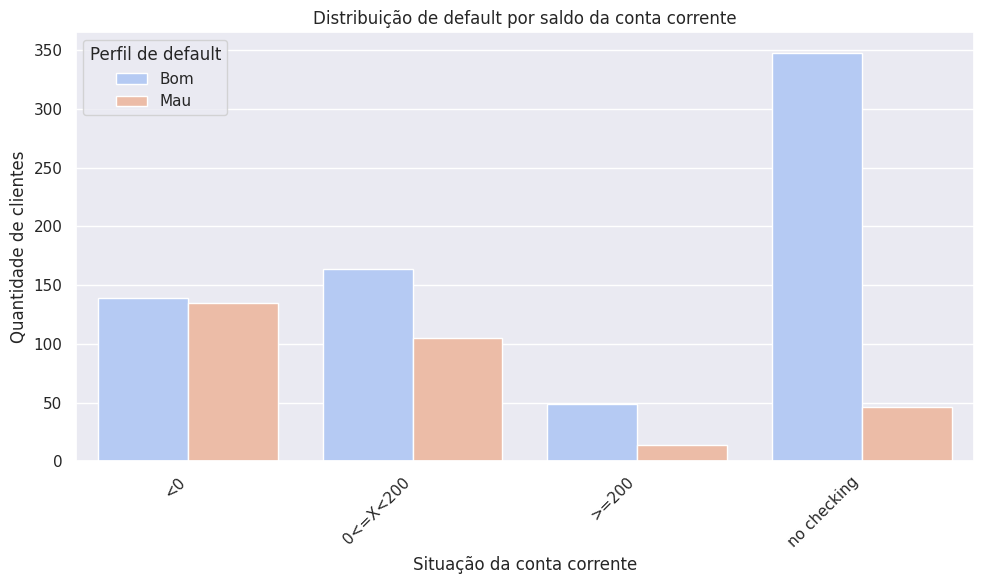

In [209]:
plt.figure(figsize=(10, 6))
sns.countplot(data=dados, x='checking_status', hue='class', palette="coolwarm", order=['<0', '0<=X<200', '>=200', 'no checking'])

plt.title('Distribuição de default por saldo da conta corrente')
plt.xlabel('Situação da conta corrente')
plt.ylabel('Quantidade de clientes')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Perfil de default', labels=['Bom', 'Mau'])

plt.tight_layout()
plt.show()

In [210]:
dados.groupby(['class', 'checking_status']).size()

class  checking_status
bad    0<=X<200           105
       <0                 135
       >=200               14
       no checking         46
good   0<=X<200           164
       <0                 139
       >=200               49
       no checking        348
dtype: int64

1. Clientes com saldo menor que zero (<0):
A distribuição entre bons e maus pagadores está mais equilibrada.
Isso sugere que clientes com saldo negativo possuem um risco mais elevado de inadimplência, já que há uma presença relativamente alta de maus pagadores.

2. Clientes com saldo entre 0 e 200 (0<=X<200):
Essa categoria tem um número considerável de clientes bons pagadores, porém também há uma quantidade expressiva de maus pagadores. Isso sugere que possuir um saldo positivo baixo pode não ser suficiente para mitigar o risco de crédito.

3. Clientes com saldo superior a 200 (>=200):
Esse grupo tem a menor quantidade de clientes, mas a maior proporção de bons pagadores. Isto sugere que um saldo da conta corrente considerado alto está fortemente correlacionado com um menor risco de crédito.

4. Clientes sem verificação de saldo (no checking):
Essa é a categoria com a maior quantidade de clientes. Observa-se que a proporção de bons pagadores é significativamente maior do que a de maus pagadores. Há uma proporção de maus pagadores, mostrando importante entender por que esses clientes não conseguiu-se realizar essa verificação ou se é ausência de conta corrente.

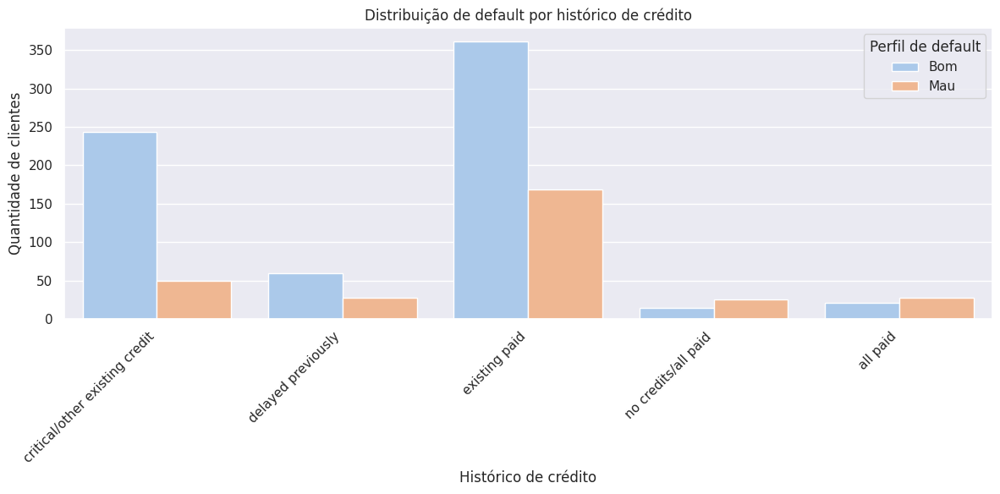

In [211]:
plt.figure(figsize=(12, 6))
sns.countplot(data=dados, x='credit_history', hue='class', palette="pastel", order=['critical/other existing credit', 'delayed previously', 'existing paid', 'no credits/all paid', 'all paid'])

plt.title('Distribuição de default por histórico de crédito')
plt.xlabel('Histórico de crédito')
plt.ylabel('Quantidade de clientes')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Perfil de default', labels=['Bom', 'Mau'])
plt.tight_layout()
plt.show()

In [212]:
dados.groupby(['class', 'credit_history']).size()

class  credit_history                
bad    all paid                           28
       critical/other existing credit     50
       delayed previously                 28
       existing paid                     169
       no credits/all paid                25
good   all paid                           21
       critical/other existing credit    243
       delayed previously                 60
       existing paid                     361
       no credits/all paid                15
dtype: int64

1. Clientes com histórico de crédito *"existing paid"* (créditos existentes pagos)
* Essa é a maior categoria no conjunto de dados.
* A maior parte dos clientes pertence à classe bom pagador, mas há um número significativo de clientes que entraram em default.
* Isso indica que ter um histórico de pagamentos regulares reduz, mas não elimina completamente o risco de inadimplência.

2. Clientes com histórico *"critical/other existing credit"* (crédito crítico ou outras dívidas existentes)
* Esse grupo tem uma quantidade expressiva de clientes bons pagadores, mas a presença de maus pagadores também é importante observar. Embora haja mais clientes "Bons" do que "Maus" nesta categoria, a proporção de "Maus" é a segunda maior da série dos cliente q deram *default*.

3. Clientes que tiveram atrasos anteriormente ("delayed previously")
* Esse grupo a barra azul ("Bom") é novamente maior, mas a barra laranja ("Mau") ainda é visível e representa uma parcela notável.
* Isso sugere que atrasos anteriores podem ser um forte indicativo de maior risco de crédito.

4. Clientes sem histórico de crédito ou com todos os créditos quitados (*no credits/all paid* e *all paid*)
* O número de clientes nessas categorias é pequeno.
* Chama a atenção que nessas duas categorias se sobressaiu clientes que deram *default*.

Sendo assim, reforça a importância crítica do histórico de crédito passado como um preditor robusto de risco de crédito futuro.  A análise detalhada das categorias permite entender nuances e tomar decisões mais precisas na gestão de risco.

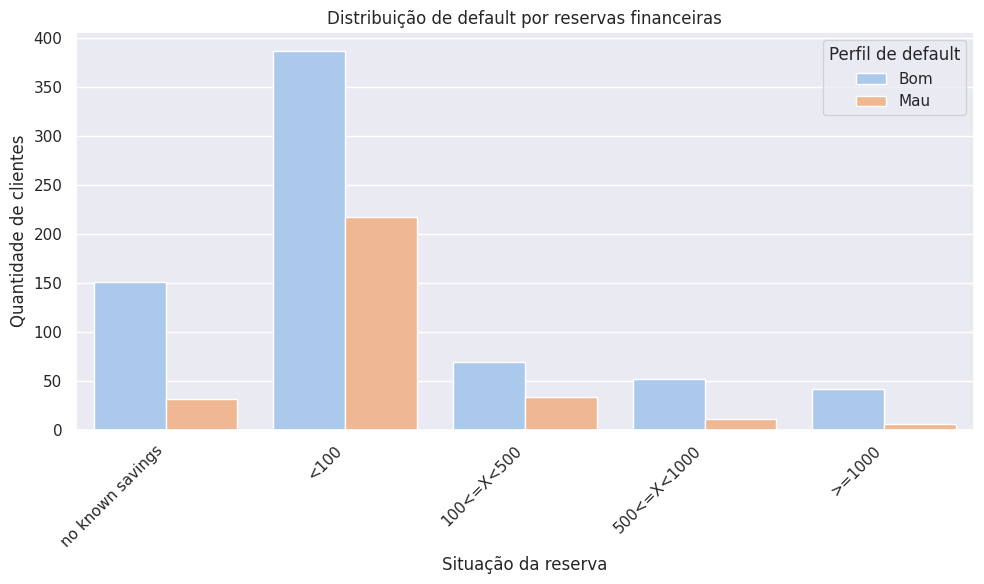

In [213]:
plt.figure(figsize=(10, 6))
sns.countplot(data=dados, x='savings_status', hue='class', palette="pastel", order=['no known savings', '<100', '100<=X<500', '500<=X<1000', '>=1000'])

plt.title('Distribuição de default por reservas financeiras')
plt.xlabel('Situação da reserva')
plt.ylabel('Quantidade de clientes')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Perfil de default', labels=['Bom', 'Mau'])

plt.tight_layout()
plt.show()

Clientes com reservas financeiras inferiores a 100 (*<100*):
Representam a maior parte da base de dados. A proporção de maus pagadores é consideravelmente maior nesse grupo em comparação com os demais. Isso sugere que clientes com pouca ou nenhuma reserva financeira possuem maior risco de inadimplência.

Clientes sem informações sobre poupança (*no known savings*):
Esse grupo tem um número significativo de bons pagadores, em comparação a outra classe. A ausência de informações sobre reservas financeiras pode dificultar a avaliação de risco, sendo um fator de incerteza para concessão de crédito.

Clientes com reservas entre 100 e 500 (*100<=X<500*) e entre 500 e 1000 (*500<=X<1000*)
Há uma redução significativa no número de maus pagadores conforme o valor das reservas financeiras aumenta.
Isso indica que pessoas com mais reservas financeiras tendem a ter menor risco de crédito.

Clientes com mais de 1000 (*>=1000*)
Esse grupo apresenta o menor número de maus pagadores.
Quanto maior a reserva financeira, menor o risco de inadimplência, o que reforça a importância dessa variável na análise de risco.

Um gráfico de densidade é muito útil para verificar como se comporta as distribuições de cada variável, segregada por classe, afim de detectar possíveis anomalias, bem como qual atributo possuem distribuições que diferem uma da outra, permitindo identificar as **classes positivas** (fraudes, nesse caso) mais facilmente.
O que se procura nesse tipo de visualização são distribuições que diferem uma da outra, permitindo identificar **classes positivas** mais facilmente.

#### 3.1.4 Preditores Numéricos

As **variáveis numéricas** desempenham um papel crucial na construção de modelos preditivos, pois capturam informações quantitativas que podem influenciar diretamente a probabilidade de cancelamento.

In [214]:
x_numericos = dados.select_dtypes(include=['int64', 'float64'])
x_numericos['class'] = dados['class']
x_numericos.head()

,duration,credit_amount,installment_commitment,residence_since,age,existing_credits,num_dependents,class
0,6.00,1169.00,4.00,4.00,67.00,2.00,1.00,good
1,48.00,5951.00,2.00,2.00,22.00,1.00,1.00,bad
2,12.00,2096.00,2.00,3.00,49.00,1.00,2.00,good
3,42.00,7882.00,2.00,4.00,45.00,1.00,2.00,good
4,24.00,4870.00,3.00,4.00,53.00,2.00,2.00,bad


In [215]:
x_numericos.nunique().sort_values()

num_dependents              2
class                       2
installment_commitment      4
residence_since             4
existing_credits            4
duration                   33
age                        53
credit_amount             921
dtype: int64

In [216]:
x_numericos[['num_dependents', 'installment_commitment', 'residence_since', 'existing_credits']].head()

,num_dependents,installment_commitment,residence_since,existing_credits
0,1.00,4.00,4.00,2.00
1,1.00,2.00,2.00,1.00
2,2.00,2.00,3.00,1.00
3,2.00,2.00,4.00,1.00
4,2.00,3.00,4.00,2.00


Com base nos valores distintos, as *features* `num_dependents`, `installment_commitment`, `residence_since` e `existing_credits` possuem indicação de serem categóricas discretas. Na fase de pré-pocessamento iremos mudar para o tipo inteiro.

In [217]:
x_numericos = x_numericos[['duration', 'credit_amount', 'age', 'class']]
x_numericos.head()

,duration,credit_amount,age,class
0,6.00,1169.00,67.00,good
1,48.00,5951.00,22.00,bad
2,12.00,2096.00,49.00,good
3,42.00,7882.00,45.00,good
4,24.00,4870.00,53.00,bad


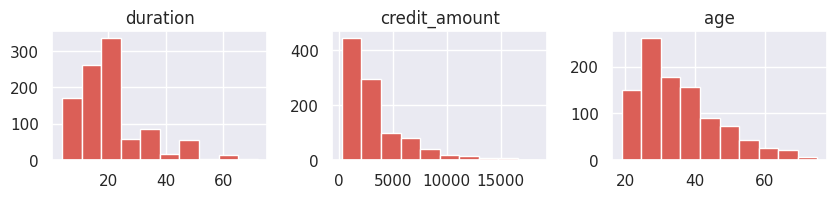

In [218]:
x_numericos[['duration', 'credit_amount', 'age']].hist(layout=(3,3))
plt.show()

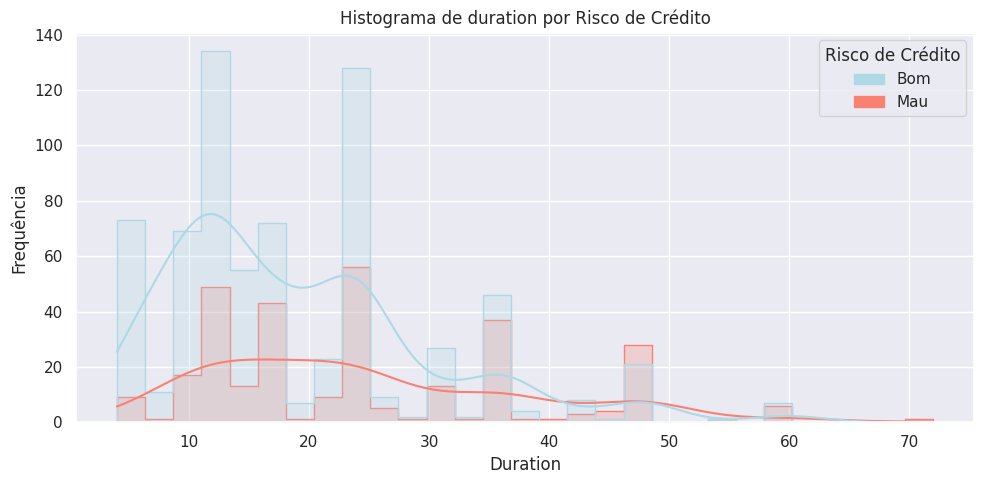

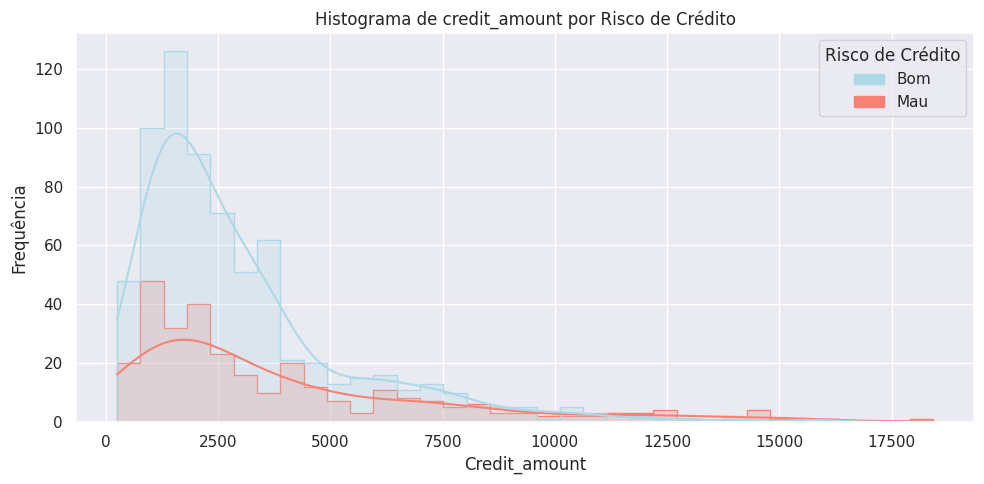

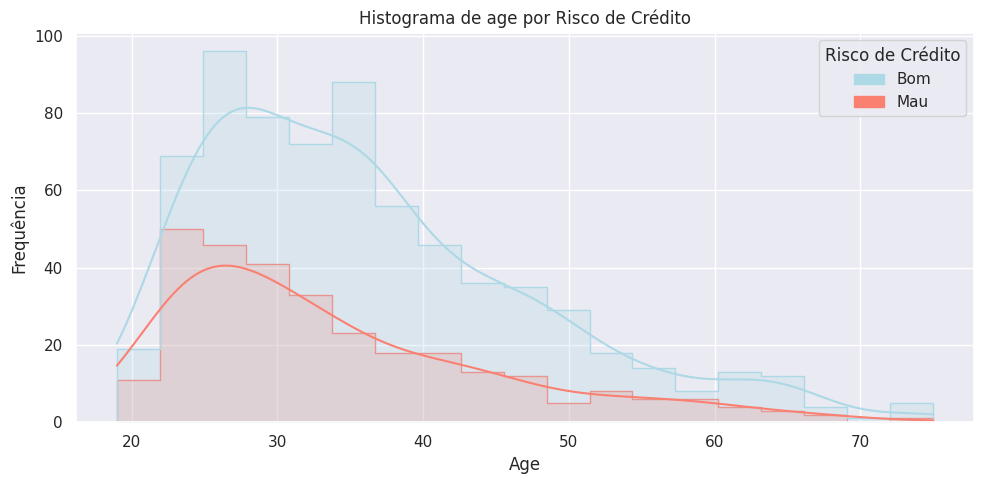

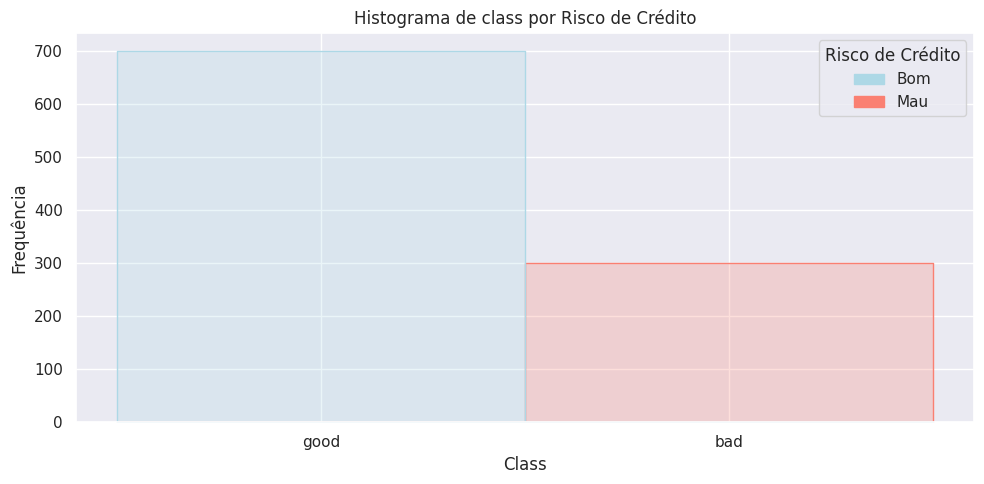

In [219]:
cores_classes = {'good': 'lightblue', 'bad': 'salmon'}
for var in x_numericos:
    plt.figure(figsize=(10, 5))
    sns.histplot(data=x_numericos, x=var, hue='class', element="step", fill=True,
                 palette=cores_classes, kde=True)
    
    plt.title(f'Histograma de {var} por Risco de Crédito')
    plt.xlabel(var.capitalize())
    plt.ylabel('Frequência')
    plt.legend(title='Risco de Crédito', labels=['Bom', 'Mau'])
    bom_patch = mpatches.Patch(color=cores_classes['good'], label='Bom')
    mau_patch = mpatches.Patch(color=cores_classes['bad'], label='Mau')
    plt.legend(handles=[bom_patch, mau_patch], title='Risco de Crédito')
    
    plt.tight_layout()
    plt.show()

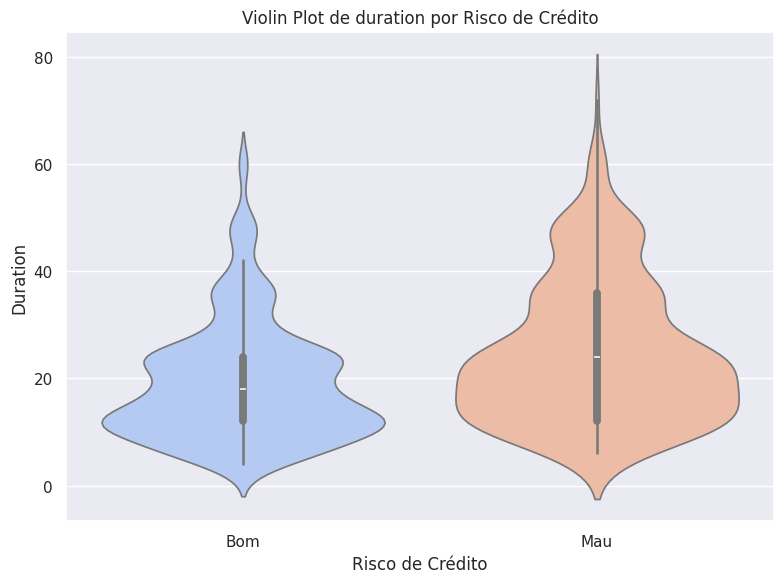

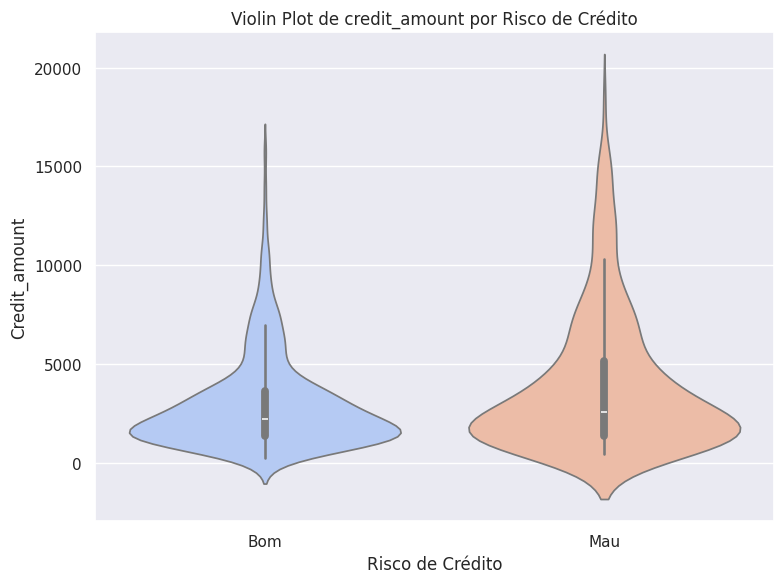

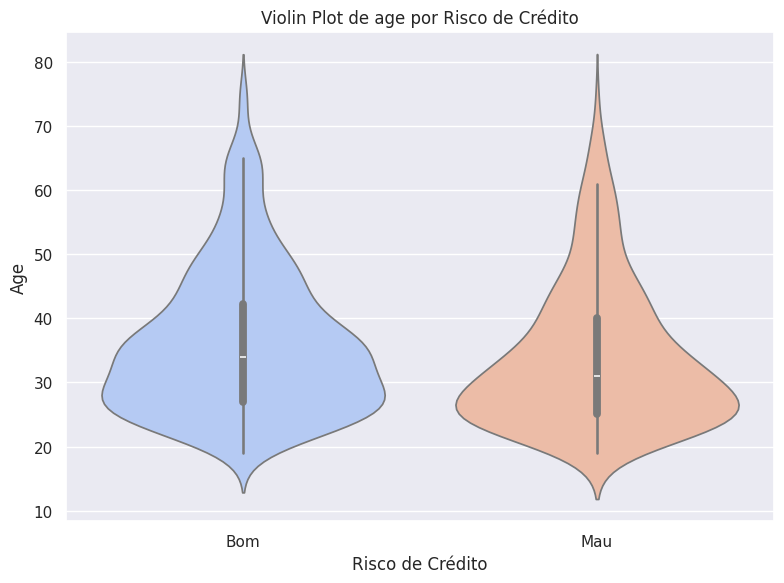

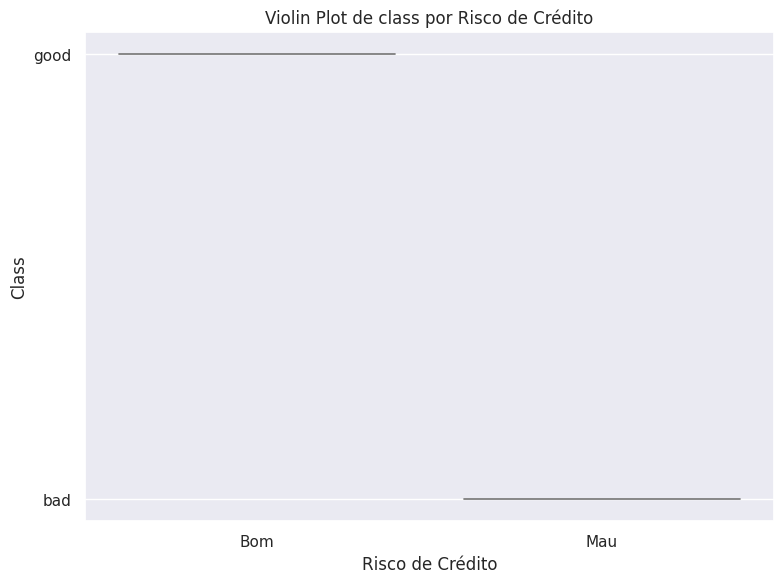

In [220]:
for var in x_numericos:
    plt.figure(figsize=(8, 6))
    sns.violinplot(data=dados, x='class', y=var, palette="coolwarm", order=['good', 'bad'])
    plt.title(f'Violin Plot de {var} por Risco de Crédito')
    plt.xlabel('Risco de Crédito')
    plt.ylabel(var.capitalize())
    plt.xticks(ticks=[0, 1], labels=['Bom', 'Mau'])
    plt.tight_layout()
    plt.show()

1. A variável `duration` (duração do crédito - em meses) apresenta uma distribuição assimétrica à direita, com maior concentração de valores entre 6 e 24 meses. Observa-se que clientes com bom histórico de crédito (em azul) estão mais distribuídos ao longo do eixo, mas há uma concentração em valores menores de duração.
Já os clientes com maior risco de inadimplência (em laranja) também apresentam concentração nos períodos mais curtos, mas há uma leve tendência de ocorrência para valores um pouco mais altos de duração do crédito. 
O histograma sugere que a relação entre `duration` e `class` não é simplesmente linear. Durações curtas/médias são comuns para ambos os grupos: Tanto "bons" quanto "maus" pagadores solicitam créditos com durações curtas e médias. Nota-se também que durações longas podem aumentar o risco, a cauda mais longa da distribuição "Mau" em durações elevadas sugere que prazos de crédito muito longos podem estar associados a um risco ligeiramente maior.

2. A variável `credit_amount` (valor do crédito) tem distribuição assimétrica à direita, com grande concentração de valores abaixo de 5.000. Clientes bons pagadores (em azul) têm maior distribuição e predominância para valores mais baixos, mas ainda apresentam algumas ocorrências em valores elevados.
Já os maus pagadores (em laranja) também estão mais concentrados nos créditos de menor valor, mas possuem uma distribuição um pouco mais espalhada em relação ao eixo dos valores.
Isso sugere que valores de crédito mais baixos estão associados a uma menor probabilidade de inadimplência, enquanto créditos elevados precisam de maior análise, pois apresentam tanto bons quanto maus pagadores.

3. A variável `age` (idade) apresenta uma distribuição aproximadamente normal, com uma leve assimetria à direita. A maioria dos clientes está na faixa entre 20 e 50 anos.
Clientes bons pagadores (em azul) são mais numerosos nas faixas acima de 30 anos, enquanto clientes maus pagadores (em laranja) têm maior concentração entre 20 e 35 anos.
Isso pode indicar que clientes mais jovens possuem maior risco de inadimplência, possivelmente devido à menor estabilidade financeira ou experiência de crédito, enquanto clientes mais velhos tendem a ter um histórico de crédito mais sólido e menor risco.

##### 3.1.4.1 Distribuição dos Dados – Assimetria (*Skewness*) e Curtose (*Kurtosis*)

Nesta etapa, será analisada a **distribuição dos dados** de cada variável, com foco em duas medidas estatísticas importantes: **assimetria** (*skewness*) e **curtose** (*kurtosis*).

- **Assimetria (*Skewness*)**: Indica o grau de **simetria** da distribuição dos dados em relação à média.  
  - Uma distribuição **simétrica** tem skew próximo de **0**.  
  - Assimetria **positiva** (skew > 0) indica concentração de valores à **esquerda**, com cauda alongada à **direita**.  
  - Assimetria **negativa** (skew < 0) indica concentração à **direita**, com cauda alongada à **esquerda**.

- **Curtose (*Kurtosis*)**: Mede o grau de **achatamento** ou **picos** da distribuição em comparação com a distribuição normal.  
  - Curtose **próxima de 0** indica uma distribuição semelhante à **normal**.  
  - Curtose **positiva** indica uma distribuição com **picos acentuados** e caudas mais longas (**leptocúrtica**).  
  - Curtose **negativa** indica uma distribuição mais **achatada** (**platicúrtica**).

Muitos algoritmos de **Machine Learning** pressupõem que as variáveis possuem uma **distribuição normal (gaussiana)**. Avaliar a **assimetria** e a **curtose** permite aplicar técnicas de **pré-processamento** adequadas (como transformação logarítmica, normalização ou padronização) para ajustar a distribuição dos dados. Esse ajuste pode melhorar significativamente a **performance** e a **acurácia** do modelo preditivo.

In [221]:
x_numericos = x_numericos[['duration', 'credit_amount', 'age']]
x_numericos.skew()

duration        1.09
credit_amount   1.95
age             1.02
dtype: float64

In [222]:
x_numericos.kurt()

duration        0.92
credit_amount   4.29
age             0.60
dtype: float64

De forma geral, os preditores numéricos apresentam assimetria positiva, donforme já demonstrado de forma visual pelos gráficos. Sugere que pode ser necessário aplicar transformações logaritmica, por exemplo, para reduzir essa assimetria antes do uso em um modelo de aprendizado de máquina.



Buscaremos agora compreender a força e direção de uma relação linear entre a variável independente e dependente.

In [223]:
x_numericos.corr(method = 'pearson')

,duration,credit_amount,age
duration,1.00,0.62,-0.04
credit_amount,0.62,1.00,0.03
age,-0.04,0.03,1.00


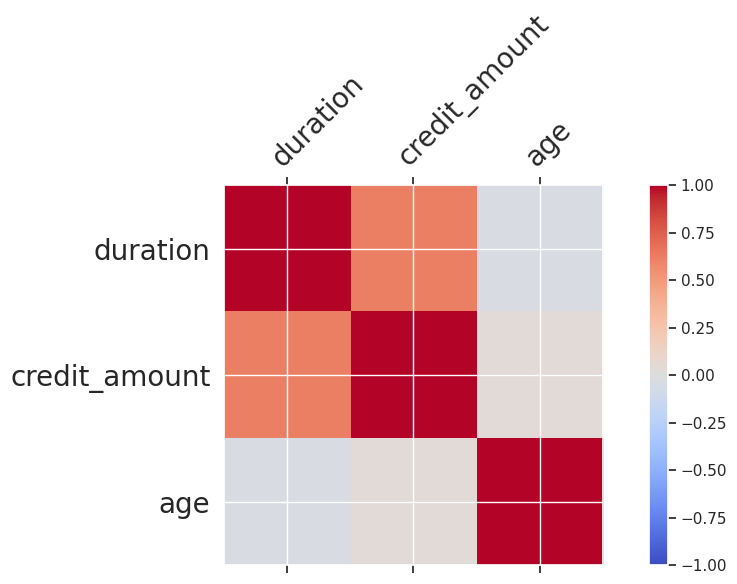

In [224]:
correlations = x_numericos.corr(method = 'pearson')

fig = plt.figure()
ax = fig.add_subplot()
cax = ax.matshow(correlations, vmin = -1, vmax = 1, cmap='coolwarm')
fig.colorbar(cax)

ticks = np.arange(len(correlations))
ax.set_xticks(ticks)
ax.set_yticks(ticks)
ax.set_xticklabels(correlations.columns, fontsize=20)
ax.set_yticklabels(correlations.columns, fontsize=20)
plt.setp(ax.get_xticklabels(), rotation=45, ha="left",
         rotation_mode="anchor")

plt.tight_layout()
plt.show()

##### 3.1.4.2 Identificação de *Outliers*

A análise de **outliers** é uma etapa essencial no processo de pré-processamento de dados, pois valores extremos podem distorcer estatísticas descritivas e impactar negativamente o desempenho dos modelos de **Machine Learning**.

Para identificar esses pontos fora do padrão, utilizaremos **boxplots**, que oferecem uma representação visual da **distribuição** de cada variável. A interpretação do boxplot inclui:

- A **linha central** da caixa representa a **mediana** (50º percentil).  
- A borda inferior da caixa indica o **primeiro quartil (Q1 - 25%)**.  
- A borda superior da caixa indica o **terceiro quartil (Q3 - 75%)**.  
- As **extensões** se estendem até o menor e maior valor dentro de **1,5 vezes o intervalo interquartílico (IQR)**.  
- **Pontos fora do boxplot** são considerados **outliers**.

Identificar outliers permite compreender melhor a **dispersão dos dados** e avaliar a necessidade de **tratamento adequado**, como remoção ou transformação desses valores. Essa análise contribui para melhorar a **qualidade dos dados** e aumentar a **robustez** do modelo preditivo.

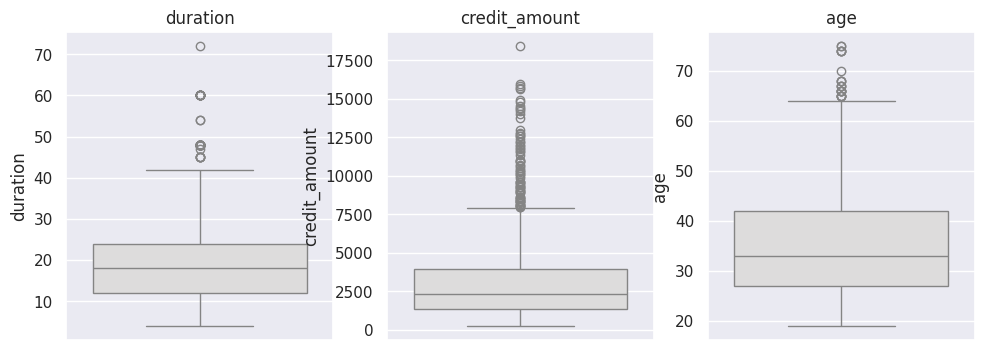

In [225]:
# Configurando o tamanho da figura e o layout dos subplots
num_cols = 5  # Número de colunas de subplots
num_rows = len(x_numericos.columns) // num_cols + (len(x_numericos.columns) % num_cols > 0)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 4 * num_rows))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop para criar um boxplot para cada coluna numérica
for i, col in enumerate(x_numericos.columns):
    sns.boxplot(y=dados[col], ax=axes[i], palette='coolwarm')
    axes[i].set_title(col)

# Remover subplots vazios
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

Considerando a definição clássica de outliers — valores que excedem 1,5 vezes o intervalo interquartílico (IQR) —, identificamos que as variáveis numéricas apresentam valores extremos. No entanto, antes de decidir por sua remoção ou transformação, é essencial analisar o contexto dos dados para garantir que essas observações não representem simplesmente características naturais do fenômeno estudado.

Entre as variáveis analisadas, destacamos:

`duration`: Apresenta alguns valores extremos acima de 40 meses. Embora esses prazos sejam atípicos, eles podem representar financiamentos de longo prazo, comuns em determinadas linhas de crédito. Excluir essas observações sem uma análise detalhada pode resultar na perda de informações valiosas sobre clientes que optam por prazos mais longos.

`credit_amount`: Possui a maior quantidade de outliers visíveis. Essa dispersão sugere que existem clientes com altos montantes financiados, que podem estar associados a diferentes perfis de risco. 
Podemos elencar ainda finalidades específicas, como financiamento de grandes projetos, aquisição imóveis, que tendem a ser para o longo prazo.
Dependendo do objetivo da análise, pode ser interessante realizar uma transformação logarítmica para reduzir a influência desses valores extremos no modelo.

`age`: Apesar de apresentar alguns outliers acima dos 70 anos, a distribuição parece relativamente normal. Esses valores podem representar clientes mais velhos, que ainda possuem acesso ao crédito e podem ter um comportamento de pagamento distinto dos clientes mais jovens. Assim, a manutenção dessas observações é recomendada para capturar corretamente a heterogeneidade etária.

##### 3.1.4.3 Avaliando a Multicolinearidade

Uma das abordagens mais eficientes para detectar associações multicolineares e possíveis problemas numéricos na inversão de matrizes é a análise de autovetores e autovalores. Em termos simples, autovetores são combinações lineares das variáveis originais que capturam a variância compartilhada entre elas, enquanto os autovalores indicam a magnitude dessa variância.

A decomposição espectral da matriz de correlação pode ser realizada utilizando a função `numpy.linalg.eig`, que retorna:

**Autovalores**: Representam a quantidade de variância acumulada em cada novo eixo (componente);

**Autovetores**: Uma matriz que indica como as novas variáveis se relacionam com as variáveis originais.

A multicolinearidade detectada pelo autovalor/autovetor indica que existe uma combinação linear entre um subconjunto das variáveis

In [226]:
# a) correlação
corr = np.corrcoef(x_numericos, rowvar = 0)
# b) técnicas
eigenvalues, eigenvectors = np.linalg.eig(corr)

Após extrair os **autovalores**, ordenamos em ordem decrescente e verificamos:

1. Valores muito próximos de zero → Indicam colinearidade extrema, podendo causar problemas na inversão de matrizes e afetar modelos de regressão.

2. Valores relativamente pequenos → Representam uma elevada, mas não crítica, multicolinearidade, podendo impactar a estabilidade dos coeficientes do modelo.

In [227]:
print (eigenvalues)

[0.37124585 1.62499358 1.00376056]


O autovalor mais baixo é 0,371, o que sugere uma possível multicolinearidade significativa, mas não extrema.

Para identificar quais variáveis estão envolvidas na colinearidade, analisamos os **autovetores** correspondentes às posições dos autovalores baixos.

Em **termos absolutos**, focamos em coeficientes com magnitude maior que **0,1** pois esses indicam forte influência das variáveis originais nas combinações lineares.

Para efeito de ilustração e encontrar quais os atributos, caso o autovalor apresentasse valores ZERO, da posição desse valor, pediremos o autovetor do menor valor, que está na posição "0".

O vetor abaixo mostra o quanto cada variável contribui para essa combinação linear.

In [228]:
print (eigenvectors[:,0])

[-0.70510167  0.70489107 -0.0772024 ]


In [229]:
eigenvectors_df = pd.DataFrame(eigenvectors, columns=[f'Component_{i+1}' for i in range(len(eigenvalues))])
eigenvectors_df['Variable'] = x_numericos.columns
eigenvectors_df[['Variable', 'Component_1']].sort_values(by='Component_1', key=abs, ascending=False)

,Variable,Component_1
0,duration,-0.71
1,credit_amount,0.70
2,age,-0.08


Interpretação da multicolinearidade:
O critério de valores absolutos próximos de 0,1 é uma prática comum.
Valores próximos de zero indicam baixa relação com a multicolinearidade.
Valores altos (próximos de 1 ou -1) indicam forte participação na colinearidade. Conforme podemos ver na matriz de correlação.

## 4. Pré-Processamento dos Dados

### **Preparando os Dados para Machine Learning**

O **pré-processamento dos dados** é uma etapa fundamental no desenvolvimento de modelos de **Machine Learning**, pois muitos algoritmos exigem que os dados estejam em formatos específicos e adequadamente preparados para garantir um desempenho eficiente. Essa preparação inclui desde o **tratamento de dados ausentes**, **normalização** e **padronização** até a **codificação de variáveis categóricas** e **remoção de outliers**. O desafio é o fato que cada algoritmo requer uma estrutura diferente, o que pode requerer transformações diferentes nos dados.

**Importância do Pré-Processamento:**  
- **Melhora a performance** e a **eficiência** dos algoritmos.  
- Garante que os dados estejam em um formato **compatível** com o modelo.  
- **Reduz ruídos** e **viéses**, aumentando a **precisão** das previsões.  

Explorar diferentes técnicas de preparação de dados e avaliar seu impacto no desempenho dos modelos faz parte do processo iterativo da **Ciência de Dados**. Essa experimentação é essencial para desenvolver soluções robustas e eficazes.

**Testar diferentes abordagens é uma das partes mais interessantes e criativas da Ciência de Dados!**

### 4.1 Transformação de Variáveis/Atributos

In [230]:
X.head()

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,residence_since,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker
0,<0,6.00,critical/other existing credit,radio/tv,1169.00,no known savings,>=7,4.00,male single,none,4.00,real estate,67.00,none,own,2.00,skilled,1.00,yes,yes
1,0<=X<200,48.00,existing paid,radio/tv,5951.00,<100,1<=X<4,2.00,female div/dep/mar,none,2.00,real estate,22.00,none,own,1.00,skilled,1.00,none,yes
2,no checking,12.00,critical/other existing credit,education,2096.00,<100,4<=X<7,2.00,male single,none,3.00,real estate,49.00,none,own,1.00,unskilled resident,2.00,none,yes
3,<0,42.00,existing paid,furniture/equipment,7882.00,<100,4<=X<7,2.00,male single,guarantor,4.00,life insurance,45.00,none,for free,1.00,skilled,2.00,none,yes
4,<0,24.00,delayed previously,new car,4870.00,<100,1<=X<4,3.00,male single,none,4.00,no known property,53.00,none,for free,2.00,skilled,2.00,none,yes


In [232]:
df_proc = dados.copy()
df_proc.head()

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
0,<0,6.00,critical/other existing credit,radio/tv,1169.00,no known savings,>=7,4.00,male single,none,...,real estate,67.00,none,own,2.00,skilled,1.00,yes,yes,good
1,0<=X<200,48.00,existing paid,radio/tv,5951.00,<100,1<=X<4,2.00,female div/dep/mar,none,...,real estate,22.00,none,own,1.00,skilled,1.00,none,yes,bad
2,no checking,12.00,critical/other existing credit,education,2096.00,<100,4<=X<7,2.00,male single,none,...,real estate,49.00,none,own,1.00,unskilled resident,2.00,none,yes,good
3,<0,42.00,existing paid,furniture/equipment,7882.00,<100,4<=X<7,2.00,male single,guarantor,...,life insurance,45.00,none,for free,1.00,skilled,2.00,none,yes,good
4,<0,24.00,delayed previously,new car,4870.00,<100,1<=X<4,3.00,male single,none,...,no known property,53.00,none,for free,2.00,skilled,2.00,none,yes,bad


**a.** Transformando o tipo de variveis categoricas que estão em float em inteiros

In [233]:
df_proc[['num_dependents', 'installment_commitment', 'residence_since', 'existing_credits']].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 4 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   num_dependents          1000 non-null   float64
 1   installment_commitment  1000 non-null   float64
 2   residence_since         1000 non-null   float64
 3   existing_credits        1000 non-null   float64
dtypes: float64(4)
memory usage: 31.4 KB


In [234]:
df_proc[['num_dependents', 'installment_commitment', 'residence_since', 'existing_credits']] = df_proc[['num_dependents', 'installment_commitment', 'residence_since', 'existing_credits']].astype(int)
df_proc[['num_dependents', 'installment_commitment', 'residence_since', 'existing_credits']].info()    

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 4 columns):
 #   Column                  Non-Null Count  Dtype
---  ------                  --------------  -----
 0   num_dependents          1000 non-null   int64
 1   installment_commitment  1000 non-null   int64
 2   residence_since         1000 non-null   int64
 3   existing_credits        1000 non-null   int64
dtypes: int64(4)
memory usage: 31.4 KB


#### 4.1.1 Imputação de Valores Ausentes

Embora o conjunto de dados atual **não apresente valores ausentes**, é importante documentar estratégias de **imputação** para lidar com situações futuras em que **dados faltantes** possam surgir durante o processo de **pré-processamento** ou em atualizações da base de dados.

A imputação de valores ausentes deve ser realizada com cuidado, considerando o tipo de variável (numérica ou categórica) e a distribuição dos dados. Abaixo estão dois métodos amplamente utilizados para **variáveis numéricas**:

**Imputação pela Mediana**  
A substituição de valores ausentes pela **mediana** é recomendada quando a variável possui **outliers**, pois a mediana é menos sensível a valores extremos do que a média.

**Implementação com `SimpleImputer`:**

```python
from sklearn.impute import SimpleImputer
import numpy as np

# Criando o imputador com estratégia de mediana
imp_num = SimpleImputer(missing_values=np.nan, strategy='median', add_indicator=True)

# Aplicando a imputação nos dados
dados_imputados = imp_num.fit_transform(dados)

In [235]:
pct_miss = 100*dados.isnull().sum()/len(dados)
pct_miss[(-pct_miss).argsort()]

checking_status          0.00
own_telephone            0.00
num_dependents           0.00
job                      0.00
existing_credits         0.00
housing                  0.00
other_payment_plans      0.00
age                      0.00
property_magnitude       0.00
foreign_worker           0.00
residence_since          0.00
personal_status          0.00
installment_commitment   0.00
employment               0.00
savings_status           0.00
credit_amount            0.00
purpose                  0.00
credit_history           0.00
duration                 0.00
other_parties            0.00
class                    0.00
dtype: float64

### 4.2 Feature Scaling 

#### 4.2.1 Nomalização
A normalização altera a escala dos dados, garantindo que todas as variáveis fiquem dentro de um intervalo padronizado. Isso não muda a distribuição dos valores, apenas os ajusta proporcionalmente.

-> Técnicas: sklearn.preprocessing import (i) MinMaxScaler e (ii) Normalizer

Útil para conjuntos de dados esparsos (muitos zeros) com atributos de escalas variadas ao usar algoritmos que ponderam valores de entrada, como redes neurais e algoritmos que usam medidas de distância,

🔹 Por que normalizar?

Evita que atributos com escalas diferentes dominem a modelagem. Além de facilitar a convergência de algoritmos de aprendizado de máquina. Essencial para modelos que utilizam distâncias (ex.: KNN, SVM) e redes neurais.

##### 4.2.1.1 MinMaxScaler
https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.MinMaxScaler.html

E uma das primeiras tarefas dentro do pré-processamento, é colocar seus dados na mesma escala. Muitos algoritmos de Machine Learning vão se beneficiar disso e produzir resultados melhores. Esta etapa também é chamada de *normalização* e significa colocar os dados em uma escala com range entre 0 e 1. 

Isso é útil para a otimização, sendo usado no core dos algoritmos de Machine Learning, como gradient descent. Isso também é útil para algoritmos como regressão e redes neurais e algoritmos que usam medidas de distância, como KNN. O scikit-learn possui uma função para esta etapa, chamada `MinMaxScaler()`.

In [236]:
x_numericos.head()

,duration,credit_amount,age
0,6.00,1169.00,67.00
1,48.00,5951.00,22.00
2,12.00,2096.00,49.00
3,42.00,7882.00,45.00
4,24.00,4870.00,53.00


In [237]:
list(x_numericos.columns)

['duration', 'credit_amount', 'age']

In [238]:
scaler = MinMaxScaler()
x_norm = pd.DataFrame(scaler.fit_transform(df_proc[list(x_numericos.columns)]), columns= list(x_numericos.columns))

print("Dados Originais: \n\n", df_proc[list(x_numericos.columns)].head())
print("\nDados Normalizados: \n\n", x_norm.head() ) 

Dados Originais: 

    duration  credit_amount   age
0      6.00        1169.00 67.00
1     48.00        5951.00 22.00
2     12.00        2096.00 49.00
3     42.00        7882.00 45.00
4     24.00        4870.00 53.00

Dados Normalizados: 

    duration  credit_amount  age
0      0.03           0.05 0.86
1      0.65           0.31 0.05
2      0.12           0.10 0.54
3      0.56           0.42 0.46
4      0.29           0.25 0.61


In [239]:
df_proc.head()

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
0,<0,6.00,critical/other existing credit,radio/tv,1169.00,no known savings,>=7,4,male single,none,...,real estate,67.00,none,own,2,skilled,1,yes,yes,good
1,0<=X<200,48.00,existing paid,radio/tv,5951.00,<100,1<=X<4,2,female div/dep/mar,none,...,real estate,22.00,none,own,1,skilled,1,none,yes,bad
2,no checking,12.00,critical/other existing credit,education,2096.00,<100,4<=X<7,2,male single,none,...,real estate,49.00,none,own,1,unskilled resident,2,none,yes,good
3,<0,42.00,existing paid,furniture/equipment,7882.00,<100,4<=X<7,2,male single,guarantor,...,life insurance,45.00,none,for free,1,skilled,2,none,yes,good
4,<0,24.00,delayed previously,new car,4870.00,<100,1<=X<4,3,male single,none,...,no known property,53.00,none,for free,2,skilled,2,none,yes,bad


In [240]:
df_proc[list(x_numericos.columns)] = x_norm

In [241]:
df_proc.head()

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
0,<0,0.03,critical/other existing credit,radio/tv,0.05,no known savings,>=7,4,male single,none,...,real estate,0.86,none,own,2,skilled,1,yes,yes,good
1,0<=X<200,0.65,existing paid,radio/tv,0.31,<100,1<=X<4,2,female div/dep/mar,none,...,real estate,0.05,none,own,1,skilled,1,none,yes,bad
2,no checking,0.12,critical/other existing credit,education,0.10,<100,4<=X<7,2,male single,none,...,real estate,0.54,none,own,1,unskilled resident,2,none,yes,good
3,<0,0.56,existing paid,furniture/equipment,0.42,<100,4<=X<7,2,male single,guarantor,...,life insurance,0.46,none,for free,1,skilled,2,none,yes,good
4,<0,0.29,delayed previously,new car,0.25,<100,1<=X<4,3,male single,none,...,no known property,0.61,none,for free,2,skilled,2,none,yes,bad


### 4.3 Feature Engineer

#### 4.3.1 Codificação de Variáveis Categóricas (*Dummies*)

Para que os algoritmos de Machine Learning possam processar corretamente os dados, todas as variáveis precisam estar em formato numérico. Como muitas variáveis categóricas contêm informações importantes para o modelo, é necessário convertê-las para valores numéricos sem perder informação semântica. Esse processo é conhecido como codificação de variáveis categóricas.

A técnica de codificação utilizada depende do tipo de variável categórica:

Codificação de Variáveis **Binárias**:

Quando a variável possui apenas duas categorias distintas (ex.: Gender com valores Masculino e Feminino), a abordagem mais eficiente é a codificação ordinal.

Método Utilizado: LabelEncoder

Atribui um valor numérico sequencial para representar cada categoria.
Exemplo:
Masculino → 0
Feminino → 1
Essa abordagem é simples e evita a criação de colunas adicionais, tornando o modelo mais eficiente.

Codificação de Variáveis **Multiclasse**:

Quando a variável contém mais de duas categorias distintas (ex.: Market_Segment, Deposit_Type, Meal), o método mais adequado é a codificação One-Hot Encoding.

Método Utilizado: OneHotEncoder (de `sklearn.preprocessing`)

*   Cria colunas binárias para cada categoria. Cada coluna nova indica a presença (1) ou ausência (0) daquela categoria na amostra.
*   O `OneHotEncoder` oferece mais flexibilidade e controle, especialmente quando integrado em pipelines de pré-processamento com scikit-learn.

 Atenção à Dimensionalidade dos Dados!

Criar muitas colunas adicionais pode aumentar significativamente a dimensionalidade do dataset, tornando o modelo mais complexo e podendo levar a overfitting.
Para evitar redundância, recomenda-se excluir uma das colunas geradas ((evitar *dummy variable trap* - efeito da multicolinearidade).

In [242]:
df_proc[df_proc.select_dtypes(include=['object']).columns].nunique().sort_values(ascending=True)

own_telephone           2
foreign_worker          2
class                   2
other_parties           3
other_payment_plans     3
housing                 3
checking_status         4
personal_status         4
property_magnitude      4
job                     4
credit_history          5
savings_status          5
employment              5
purpose                10
dtype: int64

In [243]:
df_proc.select_dtypes(include=['object']).columns

Index(['checking_status', 'credit_history', 'purpose', 'savings_status',
       'employment', 'personal_status', 'other_parties', 'property_magnitude',
       'other_payment_plans', 'housing', 'job', 'own_telephone',
       'foreign_worker', 'class'],
      dtype='object')

**Binárias**

In [244]:
label_encoder = LabelEncoder()

df_proc['own_telephone'] = label_encoder.fit_transform(df_proc['own_telephone'])
df_proc['foreign_worker'] = label_encoder.fit_transform(df_proc['foreign_worker'])
df_proc['class'] = label_encoder.fit_transform(df_proc['class'])

df_proc.head()

,checking_status,duration,credit_history,purpose,credit_amount,savings_status,employment,installment_commitment,personal_status,other_parties,...,property_magnitude,age,other_payment_plans,housing,existing_credits,job,num_dependents,own_telephone,foreign_worker,class
0,<0,0.03,critical/other existing credit,radio/tv,0.05,no known savings,>=7,4,male single,none,...,real estate,0.86,none,own,2,skilled,1,1,1,1
1,0<=X<200,0.65,existing paid,radio/tv,0.31,<100,1<=X<4,2,female div/dep/mar,none,...,real estate,0.05,none,own,1,skilled,1,0,1,0
2,no checking,0.12,critical/other existing credit,education,0.10,<100,4<=X<7,2,male single,none,...,real estate,0.54,none,own,1,unskilled resident,2,0,1,1
3,<0,0.56,existing paid,furniture/equipment,0.42,<100,4<=X<7,2,male single,guarantor,...,life insurance,0.46,none,for free,1,skilled,2,0,1,1
4,<0,0.29,delayed previously,new car,0.25,<100,1<=X<4,3,male single,none,...,no known property,0.61,none,for free,2,skilled,2,0,1,0


In [245]:
df_proc['class'].value_counts()

class
1    700
0    300
Name: count, dtype: int64

In [246]:
print(f'dataset antes do tratamento de variáveis categóricas: {df_proc.shape}')

dataset antes do tratamento de variáveis categóricas: (1000, 21)


 **Multiclasse**

In [247]:
ohe_colunas = ['other_parties', 'other_payment_plans','housing','checking_status','personal_status',
               'property_magnitude','job','credit_history','savings_status','employment','purpose']

`drop=firstTrue`: Este parâmetro indica que a primeira categoria de cada coluna categórica deve ser removida. Isso é feito para evitar a multicolinearidade em modelos de regressão ( Dummy Variable Trap).

In [248]:
encoder = OneHotEncoder(drop='first', sparse_output=False)

encoded_array = encoder.fit_transform(df_proc[ohe_colunas])

In [249]:
encoded_df = pd.DataFrame(encoded_array, columns=encoder.get_feature_names_out(ohe_colunas))
encoded_df.head()

,other_parties_guarantor,other_parties_none,other_payment_plans_none,other_payment_plans_stores,housing_own,housing_rent,checking_status_<0,checking_status_>=200,checking_status_no checking,personal_status_male div/sep,...,employment_unemployed,purpose_domestic appliance,purpose_education,purpose_furniture/equipment,purpose_new car,purpose_other,purpose_radio/tv,purpose_repairs,purpose_retraining,purpose_used car
0,0.00,1.00,1.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00
1,0.00,1.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00
2,0.00,1.00,1.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
3,1.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,...,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00
4,0.00,1.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00


In [250]:
df_proc = pd.concat([df_proc.drop(columns=ohe_colunas), encoded_df], axis=1)
df_proc.head()

,duration,credit_amount,installment_commitment,residence_since,age,existing_credits,num_dependents,own_telephone,foreign_worker,class,...,employment_unemployed,purpose_domestic appliance,purpose_education,purpose_furniture/equipment,purpose_new car,purpose_other,purpose_radio/tv,purpose_repairs,purpose_retraining,purpose_used car
0,0.03,0.05,4,4,0.86,2,1,1,1,1,...,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00
1,0.65,0.31,2,2,0.05,1,1,0,1,0,...,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00
2,0.12,0.10,2,3,0.54,1,2,0,1,1,...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
3,0.56,0.42,2,4,0.46,1,2,0,1,1,...,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00
4,0.29,0.25,3,4,0.61,2,2,0,1,0,...,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00


In [251]:
print(f'dataset após o tratamento de variáveis categóricas: {df_proc.shape}')

dataset após o tratamento de variáveis categóricas: (1000, 49)


In [252]:
df_proc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 49 columns):
 #   Column                                         Non-Null Count  Dtype  
---  ------                                         --------------  -----  
 0   duration                                       1000 non-null   float64
 1   credit_amount                                  1000 non-null   float64
 2   installment_commitment                         1000 non-null   int64  
 3   residence_since                                1000 non-null   int64  
 4   age                                            1000 non-null   float64
 5   existing_credits                               1000 non-null   int64  
 6   num_dependents                                 1000 non-null   int64  
 7   own_telephone                                  1000 non-null   int64  
 8   foreign_worker                                 1000 non-null   int64  
 9   class                                          1000 n

In [253]:
df_proc.corr()

,duration,credit_amount,installment_commitment,residence_since,age,existing_credits,num_dependents,own_telephone,foreign_worker,class,...,employment_unemployed,purpose_domestic appliance,purpose_education,purpose_furniture/equipment,purpose_new car,purpose_other,purpose_radio/tv,purpose_repairs,purpose_retraining,purpose_used car
duration,1.00,0.62,0.07,0.03,-0.04,-0.01,-0.02,0.16,0.14,-0.21,...,-0.01,-0.04,0.00,-0.06,-0.11,0.10,-0.04,-0.02,-0.07,0.14
credit_amount,0.62,1.00,-0.27,0.03,0.03,0.02,0.02,0.28,0.05,-0.15,...,0.09,-0.07,-0.01,-0.03,-0.04,0.19,-0.17,-0.03,-0.07,0.25
installment_commitment,0.07,-0.27,1.00,0.05,0.06,0.02,-0.07,0.01,0.09,-0.07,...,-0.05,0.02,0.04,-0.06,-0.05,-0.03,0.14,0.04,0.04,-0.09
residence_since,0.03,0.03,0.05,1.00,0.27,0.09,0.04,0.10,0.05,-0.00,...,0.04,-0.02,0.04,-0.01,0.02,0.04,-0.09,0.03,0.01,0.11
age,-0.04,0.03,0.06,0.27,1.00,0.15,0.12,0.15,0.01,0.09,...,0.11,-0.01,0.07,-0.13,0.08,0.04,-0.05,0.04,-0.01,0.05
existing_credits,-0.01,0.02,0.02,0.09,0.15,1.00,0.11,0.07,0.01,0.05,...,0.01,-0.06,-0.01,-0.07,0.04,0.02,-0.03,0.07,-0.01,-0.01
num_dependents,-0.02,0.02,-0.07,0.04,0.12,0.11,1.00,-0.01,-0.08,0.00,...,-0.04,-0.05,0.04,-0.09,0.10,0.00,-0.08,0.03,0.02,0.05
own_telephone,0.16,0.28,0.01,0.10,0.15,0.07,-0.01,1.00,0.11,0.04,...,0.08,-0.02,0.02,-0.05,-0.04,0.12,-0.08,-0.05,-0.01,0.14
foreign_worker,0.14,0.05,0.09,0.05,0.01,0.01,-0.08,0.11,1.00,-0.08,...,0.05,0.02,0.04,0.01,-0.15,-0.03,0.06,-0.01,0.02,0.03
class,-0.21,-0.15,-0.07,-0.00,0.09,0.05,0.00,0.04,-0.08,1.00,...,-0.04,-0.01,-0.07,-0.02,-0.10,-0.03,0.11,-0.02,0.04,0.10


In [254]:
df_proc.corr().iloc[9]

duration                                        -0.21
credit_amount                                   -0.15
installment_commitment                          -0.07
residence_since                                 -0.00
age                                              0.09
existing_credits                                 0.05
num_dependents                                   0.00
own_telephone                                    0.04
foreign_worker                                  -0.08
class                                            1.00
other_parties_guarantor                          0.06
other_parties_none                               0.00
other_payment_plans_none                         0.11
other_payment_plans_stores                      -0.05
housing_own                                      0.13
housing_rent                                    -0.09
checking_status_<0                              -0.26
checking_status_>=200                            0.04
checking_status_no checking 

A análise da correlação das variáveis com a variável alvo (class) nos dá uma primeira indicação sobre quais features podem ter maior impacto na previsão de bons ou maus pagadores. No entanto, a correlação isoladamente não é suficiente para determinar as variáveis mais relevantes, pois não captura relações não lineares ou interações entre variáveis.

### 4.4 Split dos dados

Para avaliar o desempenho do modelo, é essencial dividir os dados em conjuntos de treino e teste. Existem duas abordagens amplamente utilizadas para esse processo:

(a). Divisão Estática (train_test_split)
Utiliza a função train_test_split da biblioteca sklearn.model_selection, separando os dados em uma única iteração.
Permite definir a proporção de treino e teste (exemplo: 75% treino e 25% teste).
Simples e eficiente para cenários onde os dados são homogêneos e não precisam de múltiplas divisões.

(b). Validação Cruzada (Cross-Validation)
Realiza múltiplas divisões aleatórias dos dados, treinando e avaliando o modelo em diferentes subconjuntos.
Reduz o impacto de variações na amostra e melhora a robustez da avaliação.
É útil especialmente quando temos um volume menor de dados ou queremos ajustar hiperparâmetros.

In [159]:
X = df_proc.drop(columns= ['class'], axis= 1)
y = df_proc['class']

In [160]:
y.head()

0    1
1    0
2    1
3    1
4    0
Name: class, dtype: int64

In [161]:
X.head()

,duration,credit_amount,installment_commitment,residence_since,age,existing_credits,num_dependents,own_telephone,foreign_worker,other_parties_guarantor,...,employment_unemployed,purpose_domestic appliance,purpose_education,purpose_furniture/equipment,purpose_new car,purpose_other,purpose_radio/tv,purpose_repairs,purpose_retraining,purpose_used car
0,0.03,0.05,4,4,0.86,2,1,1,1,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00
1,0.65,0.31,2,2,0.05,1,1,0,1,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00
2,0.12,0.10,2,3,0.54,1,2,0,1,0.00,...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
3,0.56,0.42,2,4,0.46,1,2,0,1,1.00,...,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00
4,0.29,0.25,3,4,0.61,2,2,0,1,0.00,...,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00


In [162]:
X_treino, X_teste, y_treino, y_teste = train_test_split(X, y, stratify=y, shuffle=True)

In [163]:
print('tamanho total dos dados são {}, para treino temos {} e teste são {}'.format(df_proc.shape[0], len(X_treino), len(X_teste)))

tamanho total dos dados são 1000, para treino temos 750 e teste são 250


#### 4.4.1 Cross Validation - K folds
Cross-Validation é uma técnica robusta e amplamente utilizada para **avaliar o desempenho de modelos de Machine Learning de forma mais confiável** do que uma simples divisão treino/teste.  A principal vantagem do Cross-Validation reside na sua capacidade de **reduzir a variância na estimativa da performance do modelo**, fornecendo uma avaliação mais estável e menos dependente de uma única divisão aleatória dos dados.

O processo de Cross-Validation envolve a divisão do dataset em **k partes mutuamente exclusivas, denominadas folds**. O valor de *k* é um hiperparâmetro definido pelo usuário (comumente *k*=5 ou *k*=10).  Em cada iteração do Cross-Validation, um dos *k* folds é reservado como **conjunto de teste (ou validação)**, enquanto os *k-1* folds restantes são combinados para formar o **conjunto de treino**.

O modelo é então **treinado utilizando o conjunto de treino** e **avaliado no fold de teste** reservado. Este procedimento é repetido *k* vezes, de modo que **cada um dos *k* folds seja utilizado exatamente uma vez como conjunto de teste**. Ao final das *k* iterações, obtemos *k* métricas de performance (por exemplo, acurácia, precisão, recall, etc.), uma para cada fold.

Para sumarizar a performance geral do modelo, calculam-se **estatísticas descritivas sobre as *k* métricas obtidas**, tipicamente a **média** e o **desvio padrão**. A média das métricas oferece uma estimativa da performance esperada do modelo em dados não vistos, enquanto o desvio padrão quantifica a variabilidade dessa estimativa. Um baixo desvio padrão indica que a performance do modelo é consistente entre diferentes folds, aumentando a confiança na avaliação.

**Benefícios do Cross-Validation:**

*   **Estimativa de performance mais robusta:**  Menor variância em comparação com uma única divisão treino/teste.
*   **Melhor utilização dos dados:** Cada observação é usada tanto para treino quanto para teste (em diferentes iterações).
*   **Detecção de problemas de generalização:**  Permite identificar se o modelo está excessivamente ajustado a uma partição específica dos dados.

**Considerações ao usar Cross-Validation:**

*   **Custo computacional:** Aumenta o tempo de treinamento, pois o modelo é treinado *k* vezes.
*   **Escolha do valor de *k*:**  Um valor de *k* muito pequeno pode aumentar a variância da estimativa, enquanto um valor muito grande pode aumentar o custo computacional e aproximar-se do comportamento de treino em todo o dataset (perdendo um pouco do benefício da validação). Valores comuns como 5 e 10 geralmente oferecem um bom equilíbrio.
*   **Não substitui o conjunto de teste final:** O Cross-Validation é primariamente uma técnica de *avaliação* e *seleção de modelos*. Um conjunto de teste separado ainda é recomendado para uma avaliação final e imparcial do modelo escolhido após o processo de Cross-Validation.

Para mais detalhes e opções de implementação, consulte a documentação do scikit-learn: [https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.cross_val_score.html](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.cross_val_score.html)

In [169]:
num_folds = 6
seed = 42
kfold = KFold(num_folds, shuffle=True, random_state = seed)

### **4.5 Avaliação de Multicolinearidade**

A **multicolinearidade** ocorre quando variáveis independentes estão altamente correlacionadas, o que pode distorcer os **coeficientes** do modelo, dificultar a **interpretação** e reduzir a **precisão preditiva**.  

Para detectar esse problema, utiliza-se o **ator de Inflação da Variância (VIF)**, que indica o quanto a variância de um coeficiente é ampliada pela correlação entre variáveis.  

**Interpretação do VIF:**  
- **VIF ≈ 1:** Baixa correlação (**sem multicolinearidade**).  
- **VIF > 10:** Indica **multicolinearidade severa**.

**Tratamento da Multicolinearidade:**  
- **Ajustar ou remover** variáveis com **VIF elevado** para melhorar a **robustez** e a **interpretabilidade** do modelo.  
- Quando a remoção não for viável, aplicar **técnicas de regularização** como:  
  - **Ridge Regression (L2):** Penaliza coeficientes grandes, suavizando o impacto de variáveis correlacionadas.  
  - **Lasso Regression (L1):** Realiza **seleção de variáveis** ao reduzir coeficientes menos relevantes a zero.  

Essas técnicas ajudam a mitigar a multicolinearidade sem a necessidade de excluir variáveis importantes.

In [144]:
X.head()

,duration,credit_amount,installment_commitment,residence_since,age,existing_credits,num_dependents,own_telephone,foreign_worker,other_parties_guarantor,...,employment_unemployed,purpose_domestic appliance,purpose_education,purpose_furniture/equipment,purpose_new car,purpose_other,purpose_radio/tv,purpose_repairs,purpose_retraining,purpose_used car
0,0.03,0.05,4,4,0.86,2,1,1,1,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00
1,0.65,0.31,2,2,0.05,1,1,0,1,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00
2,0.12,0.10,2,3,0.54,1,2,0,1,0.00,...,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
3,0.56,0.42,2,4,0.46,1,2,0,1,1.00,...,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00
4,0.29,0.25,3,4,0.61,2,2,0,1,0.00,...,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00


In [145]:
vif_data = pd.DataFrame()
vif_data['Feature'] = X.columns
vif_data['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

print("Valores de VIF para cada variável:")
print(vif_data)

Valores de VIF para cada variável:
                                          Feature   VIF
0                                        duration  6.07
1                                   credit_amount  5.31
2                          installment_commitment 10.57
3                                 residence_since  9.96
4                                             age  4.56
5                                existing_credits 11.13
6                                  num_dependents 12.35
7                                   own_telephone  2.23
8                                  foreign_worker 26.03
9                         other_parties_guarantor  2.24
10                             other_parties_none 21.62
11                       other_payment_plans_none  7.69
12                     other_payment_plans_stores  1.41
13                                    housing_own 15.97
14                                   housing_rent  4.54
15                             checking_status_<0  2.33
16           

## 5. Seleção Algoritmos
A escolha do algoritmo de **classificação** mais adequado não é previsível, pois diferentes modelos podem apresentar desempenhos distintos dependendo das características dos dados. Por esse motivo, é essencial **ajustar** (*fit*) e **avaliar** diversos algoritmos de classificação no conjunto de dados. O objetivo é identificar o modelo que oferece o melhor **desempenho preditivo** e **generalização**.

### 5.1 Validação Cruzada


In [166]:
modelo_v2 = LogisticRegression()

In [174]:
# Executar cross-validation com múltiplas métricas
cv_results = cross_validate(modelo_v2, X_treino, y_treino, cv=kfold, scoring=['accuracy', 'precision', 'recall', 'f1'])

# Exibir métricas médias
print(f"Acurácia Média: {cv_results['test_accuracy'].mean():.4f}")
print(f"Precisão Média: {cv_results['test_precision'].mean():.4f}")
print(f"Recall Médio: {cv_results['test_recall'].mean():.4f}")
print(f"F1-Score Médio: {cv_results['test_f1'].mean():.4f}")

Acurácia Média: 0.7493
Precisão Média: 0.7938
Recall Médio: 0.8689
F1-Score Médio: 0.8283


### 5.2 Treinamento modelo

In [ ]:
ridge_model = LogisticRegression(penalty='l2', solver='lbfgs', max_iter=1000, random_state=42)

ridge_model.fit(X_treino, y_treino)

LogisticRegression(max_iter=1000, random_state=42)

In [ ]:
y_pred = ridge_model.predict(X_teste)
print("\nRelatório de Classificação:\n", classification_report(y_teste, y_pred))


Relatório de Classificação:
               precision    recall  f1-score   support

           0       0.58      0.44      0.50        75
           1       0.78      0.86      0.82       175

    accuracy                           0.74       250
   macro avg       0.68      0.65      0.66       250
weighted avg       0.72      0.74      0.72       250



O modelo de Regressão Logística foi treinado considerando todas as variáveis, sem a remoção de multicolinearidade detectada pelo VIF.

1. Visão Geral
- **Acurácia geral**: 74% → O modelo classifica corretamente 74% dos clientes entre bons e maus pagadores.
- **Precisão** (Precision): 68% → Média da precisão entre as classes.
- **Recall**: 65% → Média da capacidade do modelo em encontrar corretamente cada classe.
- **F1-score**: 66% → Média harmônica entre precisão e recall.

2. Classe 0 (Mau Pagador)
**Precisão** = 58% → Dos clientes que o modelo classificou como maus pagadores.
**Recall** = 44% → O modelo identificou corretamente apenas 44% dos maus pagadores, deixando passar 56% dos clientes realmente inadimplentes (falsos negativos).
**F1-score** = 50% → Indica um desempenho fraco na detecção de inadimplentes.

3. Classe 1 (Bom Pagador)
**Precisão** = 78% → Dos clientes que o modelo classificou como bons pagadores, 22% foram erros (falsos negativos).
**Recall** = 86% → O modelo identificou corretamente 86% dos bons pagadores, errando apenas 14%.
**F1-score** = 82% → Indica um bom desempenho geral na classificação de bons pagadores.

In [176]:
# Avaliar coeficientes após regularização
coef_df = pd.DataFrame({'Feature': X_treino.columns, 'Coefficient': ridge_model.coef_[0]})
print(coef_df.sort_values(by='Coefficient', ascending=False))

                                          Feature  Coefficient
17                    checking_status_no checking         1.34
27  credit_history_critical/other existing credit         1.26
9                         other_parties_guarantor         1.07
28              credit_history_delayed previously         0.79
33                          savings_status_>=1000         0.75
4                                             age         0.70
47                               purpose_used car         0.70
46                             purpose_retraining         0.52
11                       other_payment_plans_none         0.50
34                savings_status_no known savings         0.46
35                              employment_4<=X<7         0.44
10                             other_parties_none         0.41
20                    personal_status_male single         0.37
16                          checking_status_>=200         0.36
43                                  purpose_other      

Resumo dos Principais Coeficientes e seus Impactos

| **Variável**                                 | **Coeficiente** | **Impacto**                           |
|---------------------------------------------|---------------|-------------------------------------|
| `checking_status_no checking`              | **1.34**      | Aumenta a chance de ser bom pagador |
| `credit_history_critical/other existing credit` | **1.26**  | Aumenta a chance de ser bom pagador |
| `other_parties_guarantor`                  | **1.07**      | Ter um garantidor aumenta a chance de bom pagador |
| `credit_history_delayed previously`        | **0.79**      | Histórico de atraso favorece bom pagador |
| `savings_status_>=1000`                    | **0.75**      | Alto saldo de poupança favorece bom pagador |
| `age`                                      | **0.70**      | Idade maior favorece ser bom pagador |
| `purpose_used car`                         | **0.70**      | Empréstimos para carros usados associam-se a bom pagador |
| `purpose_retraining`                       | **0.52**      | Financiamento para requalificação profissional é positivo |
| `other_payment_plans_none`                 | **0.50**      | Não possuir outros planos de pagamento aumenta chance de bom pagador |
| `savings_status_no known savings`          | **0.46**      | Não ter poupança favorece bom pagador |
| `employment_4<=X<7`                        | **0.44**      | Tempo de emprego entre 4 e 7 anos favorece bom pagador |
| `checking_status_<0`                       | **-0.36**     | Saldo negativo reduz chance de ser bom pagador |
| `employment_unemployed`                    | **-0.41**     | Desemprego reduz chance de ser bom pagador |
| `credit_amount`                            | **-1.66**     | Valores elevados de crédito estão associados a inadimplência |
| `duration`                                 | **-1.80**     | Duração maior do crédito reduz chance de ser bom pagador |

Os coeficientes positivos indicam variáveis que aumentam a chance do cliente ser **bom pagador**, enquanto os negativos sugerem **maior risco de inadimplência**. Destacam-se **saldo bancário**, **histórico de crédito** e **propósito do empréstimo** como fatores críticos na decisão do modelo.


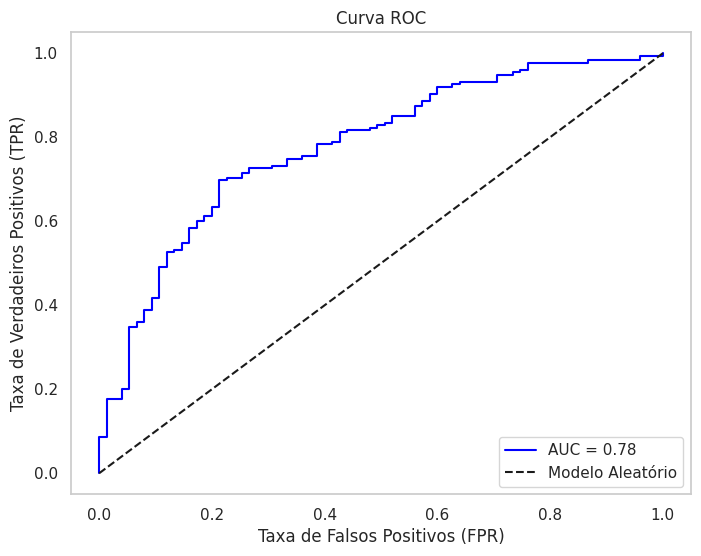

<Figure size 1000x600 with 0 Axes>

In [177]:
# Probabilidades previstas (classe positiva)
y_prob = ridge_model.predict_proba(X_teste)[:, 1]

# Curva ROC
fpr, tpr, thresholds = roc_curve(y_teste, y_prob)
auc = roc_auc_score(y_teste, y_prob)

# Plot da Curva ROC
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f'AUC = {auc:.2f}', color='blue')
plt.plot([0, 1], [0, 1], 'k--', label='Modelo Aleatório')
plt.title('Curva ROC')
plt.xlabel('Taxa de Falsos Positivos (FPR)')
plt.ylabel('Taxa de Verdadeiros Positivos (TPR)')
plt.legend(loc='lower right')
plt.grid()
plt.show()
plt.tight_layout();

- Linha preta tracejada: Representa um modelo aleatório, onde a taxa de verdadeiros positivos cresce proporcionalmente à taxa de falsos positivos. Isso significa que o modelo não tem capacidade de distinguir entre as classes.

- Curva Azul (Modelo Treinado): Indica o desempenho do modelo real. Quanto mais distante da linha diagonal e mais próximo do canto superior esquerdo, melhor o modelo.

- Área sob a curva (AUC = 0.78): O valor 0.78 indica que o modelo tem boa capacidade de discriminar entre bons e maus pagadores.
Um AUC = 0.5 indicaria um modelo aleatório (sem capacidade preditiva). Um AUC próximo de 1.0 indicaria um modelo perfeito.


Com um AUC de 0.78, o modelo apresenta um bom desempenho na classificação dos clientes.
Ele acerta mais do que erra, mas ainda há espaço para melhorias. Dependendo do objetivo do modelo (reduzir falsos positivos ou falsos negativos), pode-se ajustar o limiar de decisão para otimizar a classificação.

Especificidade: 0.44


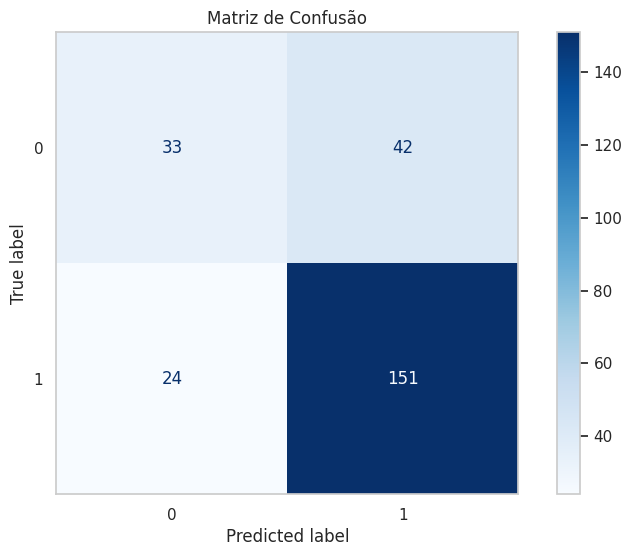

In [179]:
# Matriz de confusão
cm = confusion_matrix(y_teste, y_pred)
tn, fp, fn, tp = cm.ravel()
specificity = tn / (tn + fp)
print(f"Especificidade: {specificity:.2f}")

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=ridge_model.classes_)
disp.plot(cmap='Blues', values_format='d')
plt.title('Matriz de Confusão')
plt.grid(False)
plt.show()

| Verdadeiro \ Predito | **Mau Pagador (0)** | **Bom Pagador (1)** |  
|----------------------|---------------------|---------------------|  
| **Mau Pagador (0)** | **33** (Verdadeiro Negativo - TN) | **42** (Falso Positivo - FP) |  
| **Bom Pagador (1)** | **24** (Falso Negativo - FN) | **151** (Verdadeiro Positivo - TP) |

O modelo tem uma boa capacidade de identificar clientes adimplentes (Classe 1), mas precisa melhorar a detecção de inadimplentes (Classe 0).

Ajustar o threshold da classificação ou explorar técnicas como penalização de classes pode melhorar a detecção dos maus pagadores.

Modelos alternativos como árvores de decisão, Random Forest ou XGBoost poderiam ser testados para melhorar a capacidade preditiva.

### 5.3 SHAP value

In [181]:
explainer = shap.Explainer(ridge_model, X_treino)
shap_values = explainer(X_teste)

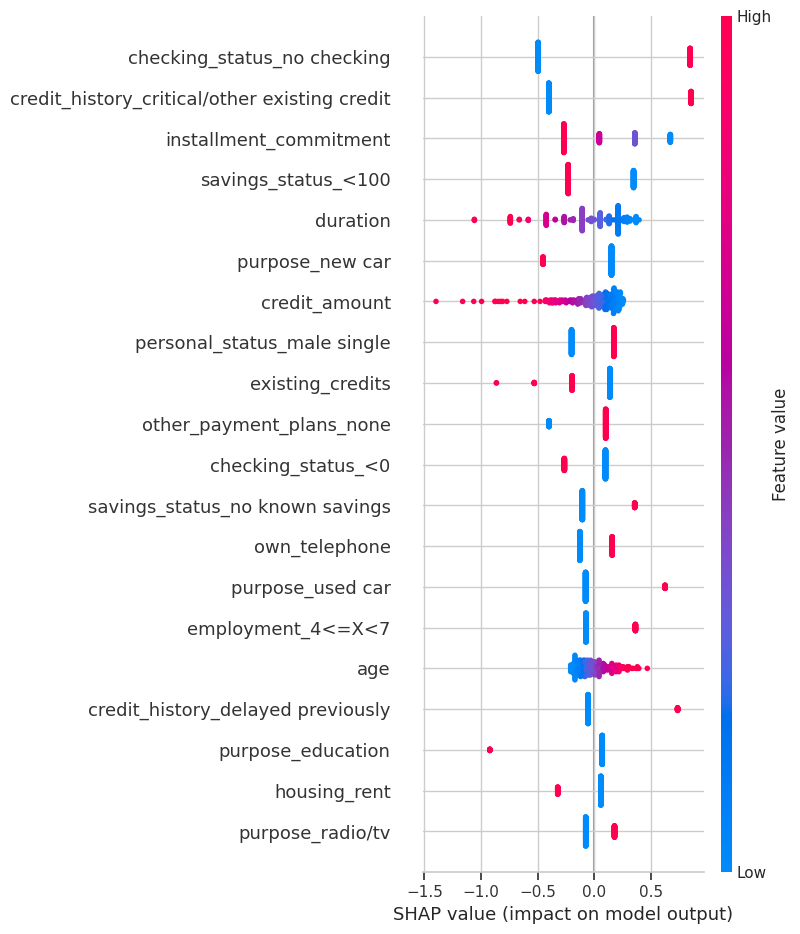

In [ ]:
shap.summary_plot(shap_values, X_teste)

`checking_status_no checking` -> Clientes sem conta corrente, ou sem verificcação de saldo têm maior risco de inadimplência. Bancos podem exigir histórico de movimentação antes de conceder crédito.

`credit_history_critical/other existing credit`	-> Clientes com histórico de crédito crítico são mais propensos ao não pagamento. Estratégias de mitigação incluem análise mais rigorosa e taxas de juros diferenciadas.

`savings_status_no known savings` -> Clientes sem histórico de poupança demonstram menor capacidade de reserva financeira, aumentando o risco de default.

`purpose_new car` -> Clientes que buscam crédito para compra de carro novo podem apresentar perfis de risco diferentes, dependendo da renda e comprometimento financeiro.

`age` -> Clientes mais jovens podem apresentar maior risco devido a menor estabilidade financeira e menor tempo no mercado de trabalho.

A Instituição deveria:
1. Política de Crédito Mais Rigorosa para clientes sem histórico bancário ou com crédito crítico.
2. Análise mais aprofundada do perfil financeiro para clientes sem poupança.
3. Personalização da Concessão de Crédito: Dependendo do propósito do empréstimo (ex: carro, educação), aplicar taxas de juros diferenciadas.
4. Incorporar Novas Fontes de Dados: Como histórico de pagamentos de contas básicas (água, luz, telefone) para perfis sem histórico bancário.

## 6. Conclusões

O desenvolvimento deste modelo de classificação de risco de crédito representa a versão inicial de um sistema preditivo que, apesar de entregar resultados iniciais, ainda tem um grande potencial de refinamento.

Modelos de Machine Learning não é um produto finalizado, mas um organismo vivo. Ele evolui constantemente à medida que novos dados são incorporados, técnicas mais avançadas são aplicadas e ajustes na engenharia de atributos são realizados.

Relembrando o que fizemos nesta primeira versão:
- Análise exploratória dos dados para identificar padrões e relações entre variáveis.
- Pré-processamento básico com codificação de variáveis categóricas e normalização de variáveis numéricas.
- Treinamento de um modelo base utilizando Regressão Logística, sem otimizações profundas.
- Avaliação da performance com métricas como Acurácia, Recall, Precisão, Curva ROC e SHAP para explicar a importância das variáveis.

Oportunidades de melhoria para versões futuras:
- Engenharia de Atributos: Criar novas variáveis que capturem melhor o comportamento dos clientes, como um indicador de estabilidade financeira combinando idade, histórico de crédito e status bancário.
- Feature Selection: Refinar a seleção de variáveis para evitar multicolinearidade e melhorar a interpretabilidade do modelo.
- Testar Modelos Mais Avançados: Como Random Forest, XGBoost e Redes Neurais, que podem capturar relações não lineares entre as variáveis.
- Ajustar Hiperparâmetros: Utilizar técnicas como Grid Search e Random Search para otimizar o desempenho do modelo.
- Atualização Contínua: Incorporar novos dados periodicamente para refletir as mudanças no perfil dos clientes e nas tendências econômicas.

____